In [1]:
import numpy as np
from scipy import linalg
from scipy.spatial.transform import Rotation as R
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib.collections
import matplotlib.patches
import pg_fitter_tools as fit
import sk_geo_tools as geo
import cv2
import re
from collections import Counter

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
%matplotlib notebook

In [4]:
focal_length = [2.760529621789217e+03, 2.767014510543478e+03]
principle_point = [1.914303537872458e+03, 1.596386868474348e+03]
radial_distortion = [-0.2398, 0.1145]
tangential_distortion = [0, 0]
camera_matrix = fit.build_camera_matrix(focal_length, principle_point)
distortion = fit.build_distortion_array(radial_distortion, tangential_distortion)

In [5]:
# rotate about z so that light injectors are in +y dir and tank axis remains +z dir
theta = np.pi/2-np.arctan(768.14 / 1490.73)
rot2 = np.array([[np.cos(theta), -np.sin(theta), 0], [np.sin(theta), np.cos(theta), 0], [0, 0, 1]])
# rotate about x so that light injectors are in +z dir and tank axis is -y dir
# (in image coords, +y is directed down)
rot1 = np.array([[1, 0, 0], [0, 0, -1], [0, 1, 0]])
rot = np.matmul(rot1, rot2)
camera_rotation = cv2.Rodrigues(rot)[0]
camera_r = 1100.
camera_spacing = 120.
n_cameras = 10
camera_translations = np.array([[0., 424.+camera_spacing*i, -camera_r] for i in range(n_cameras)])
camera_rotations = np.repeat(camera_rotation[None, :, :], n_cameras, axis=0)

In [6]:
pmt_locations = fit.read_3d_feature_locations("parameters/SK_simtest_PMT_locations.txt", delimiter=" ")
bolt_count = 24
bolt_locations = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = {k: np.mean([bolt_locations[re.sub(r"-00$", "-" + str(i + 1).zfill(2), k)] for i in range(0, 24, 24//bolt_count)], axis=0)
                           for k in pmt_locations.keys()}

In [7]:
def get_ring_positions(bolt_locations, pmt_keys, bolt_count):
    return {k: np.mean([bolt_locations[re.sub(r"-00$", "-" + str(i + 1).zfill(2), k)] for i in range(0, 24, 24//bolt_count)], axis=0)
                           for k in pmt_keys}

In [8]:
def get_ring_orientations(bolt_positions, pmt_keys, bolt_count):
    ring_orientations = {}
    for k in pmt_keys:
        c, n = geo.fit_plane(np.array([bolt_positions[re.sub(r"-00$", "-" + str(b + 1).zfill(2), k)] for b in range(0, 24, 24//bolt_count)]))
        # flip normal if it is directed away from tank centre
        if np.dot(n,c) > 0:
            n = -n
        ring_orientations[k] = n
    return ring_orientations

In [9]:
def get_image_feature_locations(feature_positions, camera_matrix, distortion, camera_rotations, camera_translations):
    image_feature_locations = {
        i : {list(feature_positions.keys())[f]:v for f, v in enumerate(cv2.projectPoints(np.array(list(feature_positions.values())), r, t, camera_matrix, distortion)[0].reshape((-1,2)))
             if v[0] > 0 and v[0] < 4000 and v[1] > 0 and v[1] < 3000}
        for i, (r, t) in enumerate(zip(camera_rotations, camera_translations))}
    feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
    print("Feature in image counts:", Counter(feature_counts.values()))
    return image_feature_locations

In [10]:
def get_smeared_feature_locations(image_feature_locations, pixel_error):
    smeared_feature_locations = {}
    for k, i in image_feature_locations.items():
        smeared_feature_locations[k] = {}
        for j, f in i.items():
            smeared = np.random.normal(f, pixel_error*np.sqrt(2/np.pi)) # multiply by sqrt(2/pi) because it's being smeared in 2D
            if(smeared[0] > 0 and smeared[0] < 4000 and smeared[1] > 0 and smeared[1] < 3000):
                smeared_feature_locations[k][j] = smeared
    smeared_feature_counts = Counter([f for i in smeared_feature_locations.values() for f in i.keys()])
    print("Smeared feature in image counts:", Counter(smeared_feature_counts.values()))
    return smeared_feature_locations

In [11]:
def setup_bolt_simulation(feature_positions, image_feature_locations, focal_length, principle_point, radial_distortion, seed_error=1):
    seed_feature_positions = {}
    for i, f in feature_positions.items():
        seed_feature_positions[i] = np.random.normal(f, seed_error)
    fitter = fit.PhotogrammetryFitter(image_feature_locations, seed_feature_positions, focal_length, principle_point, radial_distortion)
    return fitter

In [12]:
def plot_images(image_feature_locations):
    for i in image_feature_locations.values():
        fig, ax = plt.subplots(figsize=(12,9))
        coords = np.rint(np.stack(list(i.values())))
        ax.scatter(coords[:,0], -coords[:,1], marker='s', s=0.2)
        ax.set_xlim((0, 4000))
        ax.set_ylim((-3000, 0))
        ax.axes.xaxis.set_visible(False)
        ax.axes.yaxis.set_visible(False)
        fig.tight_layout()

In [13]:
def run_bolt_fit(fitter, bolt_positions):
    reco_cam_rotations, reco_cam_translations, reprojected_points = fitter.estimate_camera_poses()
    reco_cam_rotations, reco_cam_translations, reco_locations = fitter.bundle_adjustment(reco_cam_rotations, reco_cam_translations)
    
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_locations)
    print("mean reconstruction error:", linalg.norm(reco_errors, axis=1).mean())
    print("max reconstruction error:", linalg.norm(reco_errors, axis=1).max())

    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(reco_cam_rotations, reco_cam_translations)
    cam_orientations_transformed = np.matmul(R, reco_cam_orientations)
    cam_positions_translated = reco_cam_positions - translation
    cam_positions_transformed = scale*R.dot(cam_positions_translated.transpose()).transpose()

    reco_bolt_positions = reco_positions_dict(reco_transformed, fitter.feature_index)
    position_errors = linalg.norm(reco_errors, axis=1)

    return reco_bolt_positions, position_errors

In [14]:
def reco_positions_dict(reco_positions, feature_index):
    return {f: reco_positions[i] for f, i in feature_index.items()}

In [15]:
def get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count):
    reco_ring_positions = get_ring_positions(reco_bolt_positions, ring_positions.keys(), bolt_count)
    errors = np.array([linalg.norm(reco_ring_positions[k] - ring_positions[k]) for k in ring_positions.keys()])
    return errors

In [16]:
def get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count):
    reco_orientations = get_ring_orientations(reco_bolt_positions, ring_orientations.keys(), bolt_count)
    errors = np.array([np.degrees(np.arccos(np.dot(reco_orientations[k], ring_orientations[k]))) for k in ring_orientations.keys()])
    return errors

In [17]:
def make_fig(title, xlabel, figsize=(8,6)):
    fig, ax = plt.subplots(figsize=figsize)
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    fig.tight_layout()
    return fig, ax

In [18]:
def plot_reconstruction(reco_positions, cam_positions):
    fig = plt.figure(figsize=(12,9))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(reco_positions[:,0], reco_positions[:,1], reco_positions[:,2], marker='^', label="Bolt", s=1)
    ax.scatter(cam_positions[:,0], cam_positions[:,1], cam_positions[:,2], marker='*', label="Camera", s=60)
    plt.legend(loc=0)
    fig.tight_layout()

In [30]:
def plot_geometry(bolt_positions, pmt_positions, cam_positions):
    fig = plt.figure(figsize=(12,9))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter([b[0] for b in bolt_positions.values()], [b[1] for b in bolt_positions.values()], [b[2] for b in bolt_positions.values()], marker='.', label="Bolt", s=1)
    ax.scatter([p[0] for p in pmt_positions.values()], [p[1] for p in pmt_positions.values()], [p[2] for p in pmt_positions.values()], marker='o', label="PMT", s=20)
    ax.scatter(cam_positions[:,0], cam_positions[:,1], cam_positions[:,2], marker='^', label="Camera", s=60)
    plt.legend(loc=0)
    fig.tight_layout()

<IPython.core.display.Javascript object>


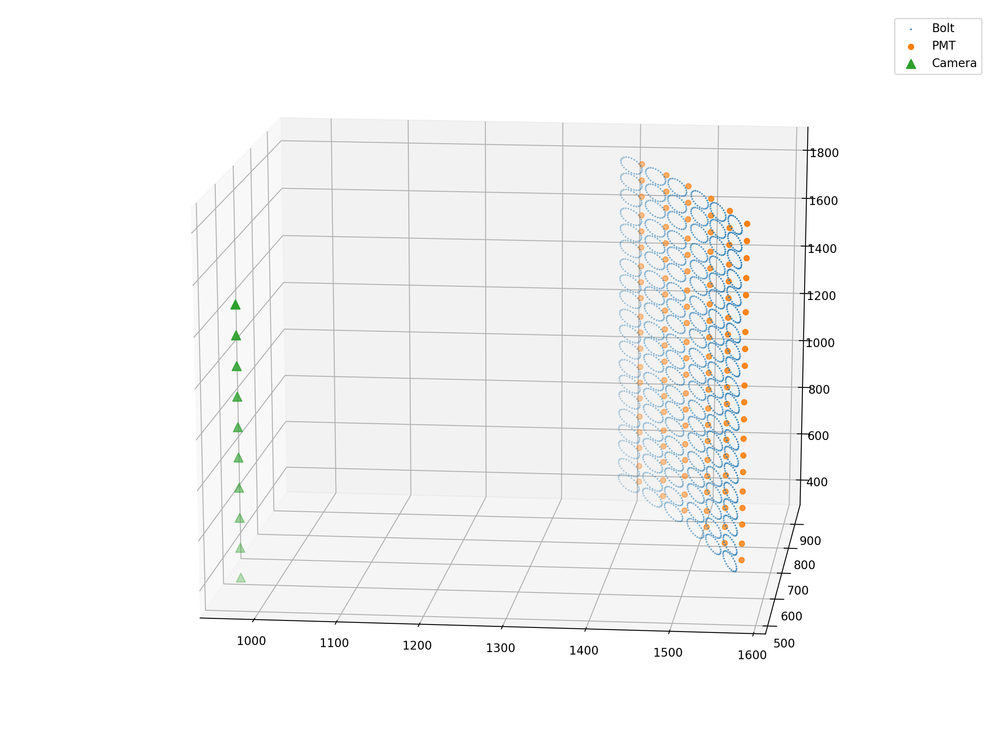

In [31]:
camera_orientations, camera_positions = fit.camera_world_poses(camera_rotations, camera_translations)
plot_geometry(bolt_locations, pmt_locations, camera_positions)

# Simulation with 24 bolts

Feature in image counts: Counter({5: 890, 6: 724, 4: 462, 3: 438, 2: 264, 1: 102})


<IPython.core.display.Javascript object>


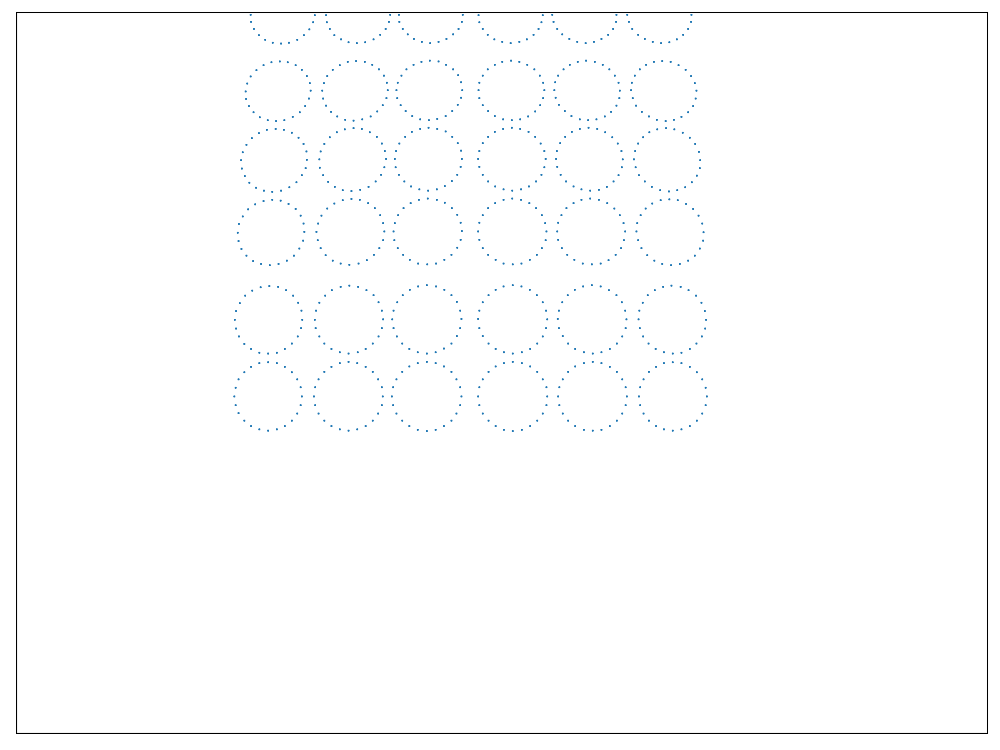

<IPython.core.display.Javascript object>


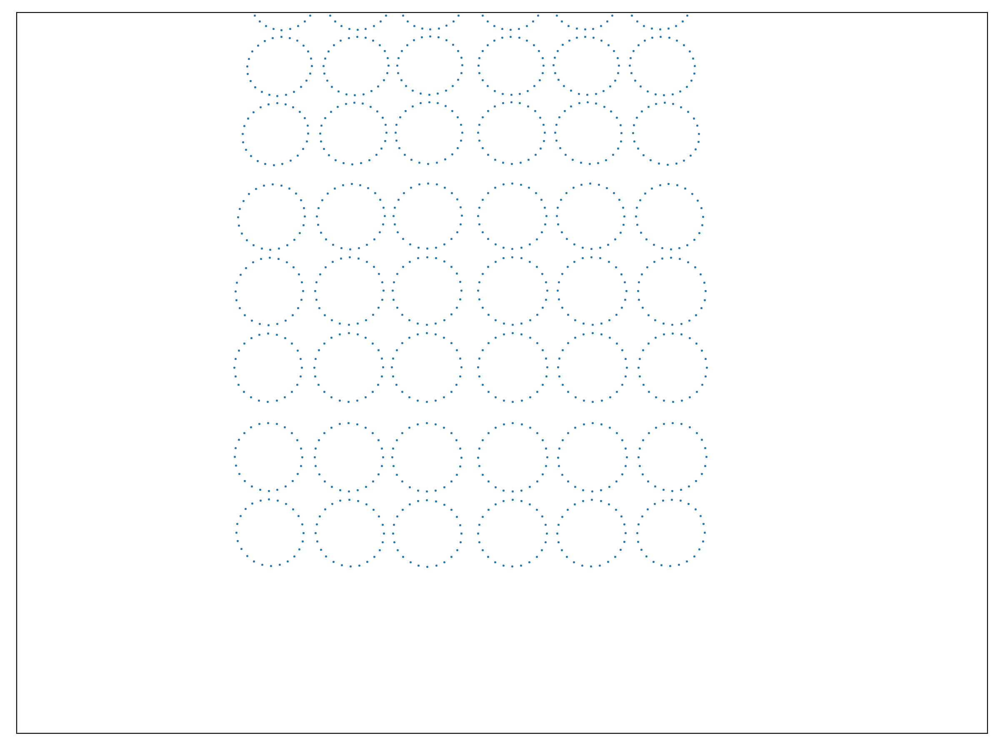

<IPython.core.display.Javascript object>


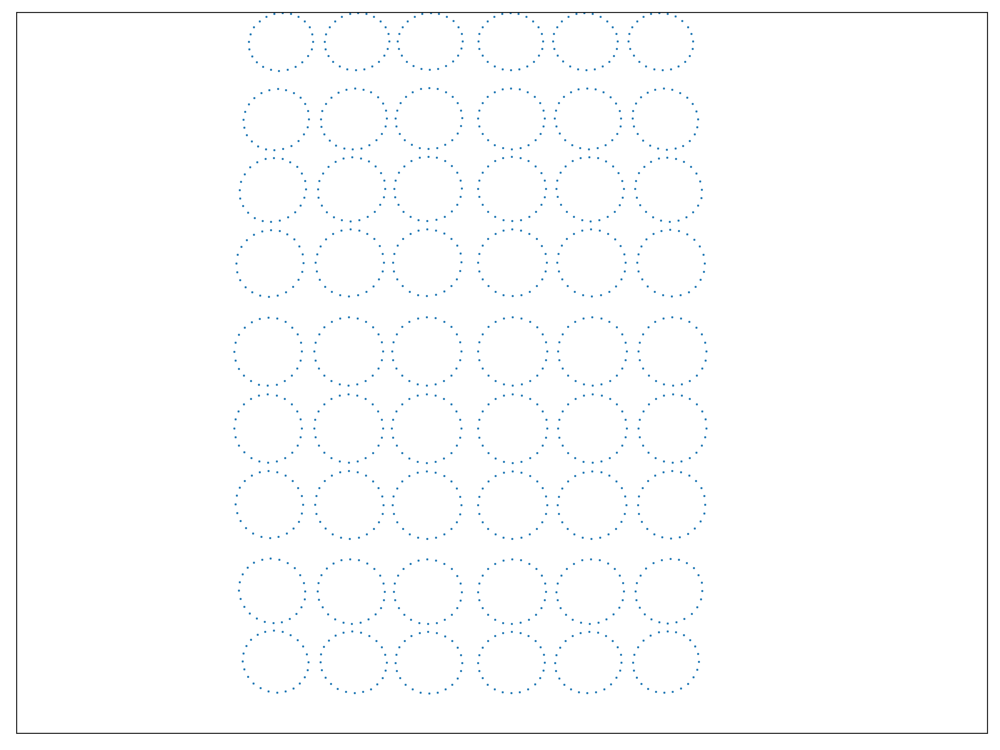

<IPython.core.display.Javascript object>


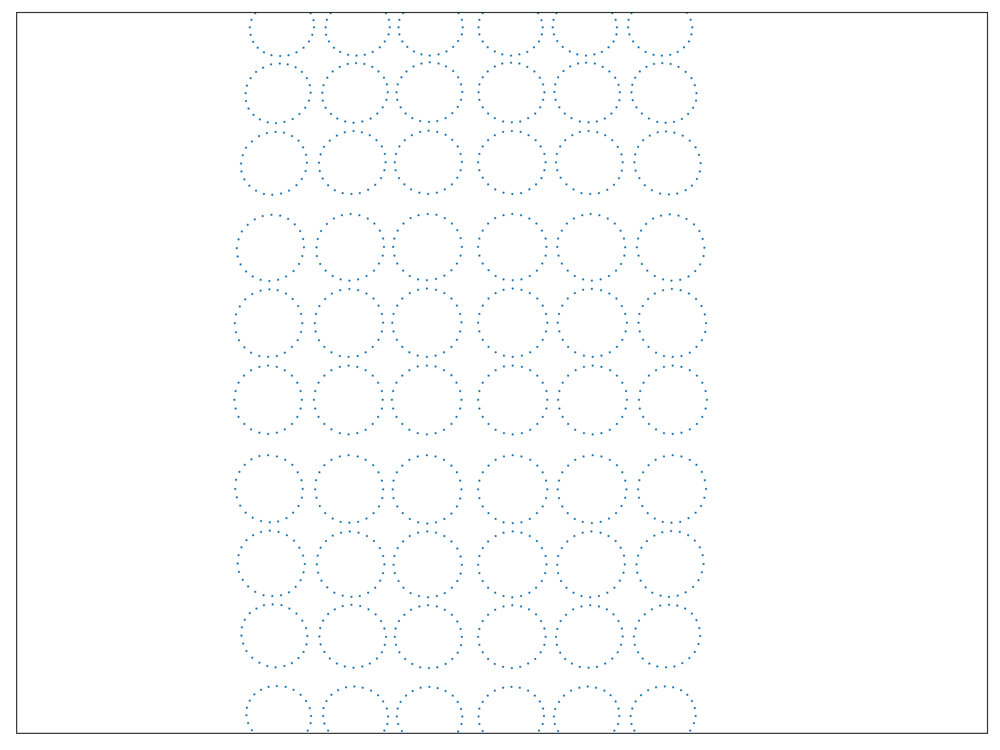

<IPython.core.display.Javascript object>


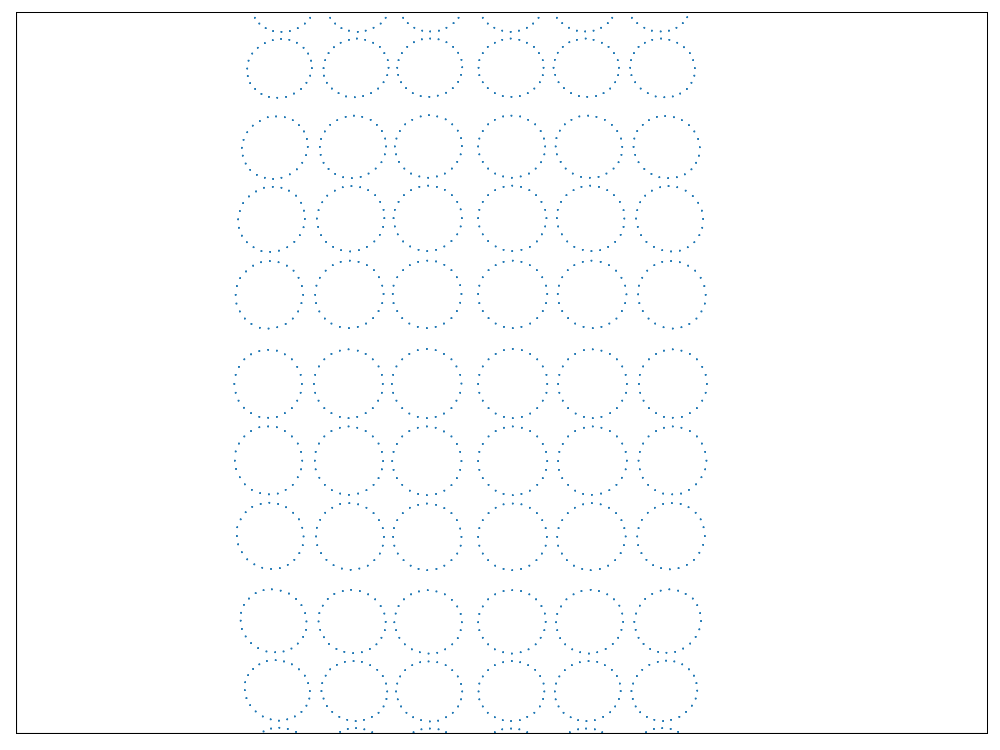

<IPython.core.display.Javascript object>


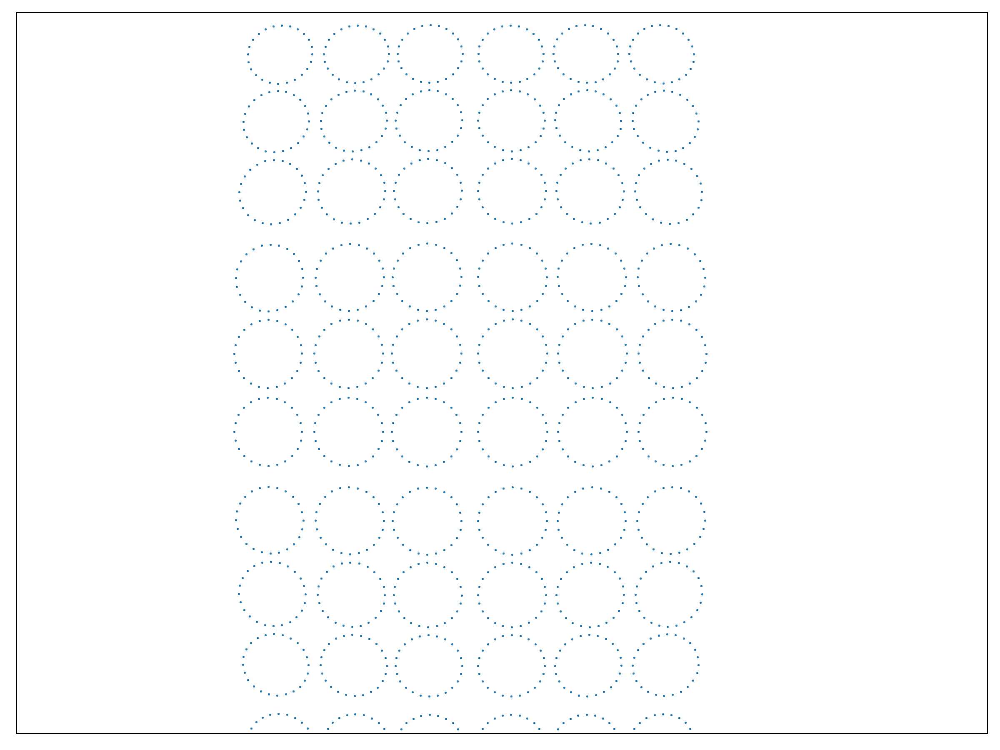

<IPython.core.display.Javascript object>


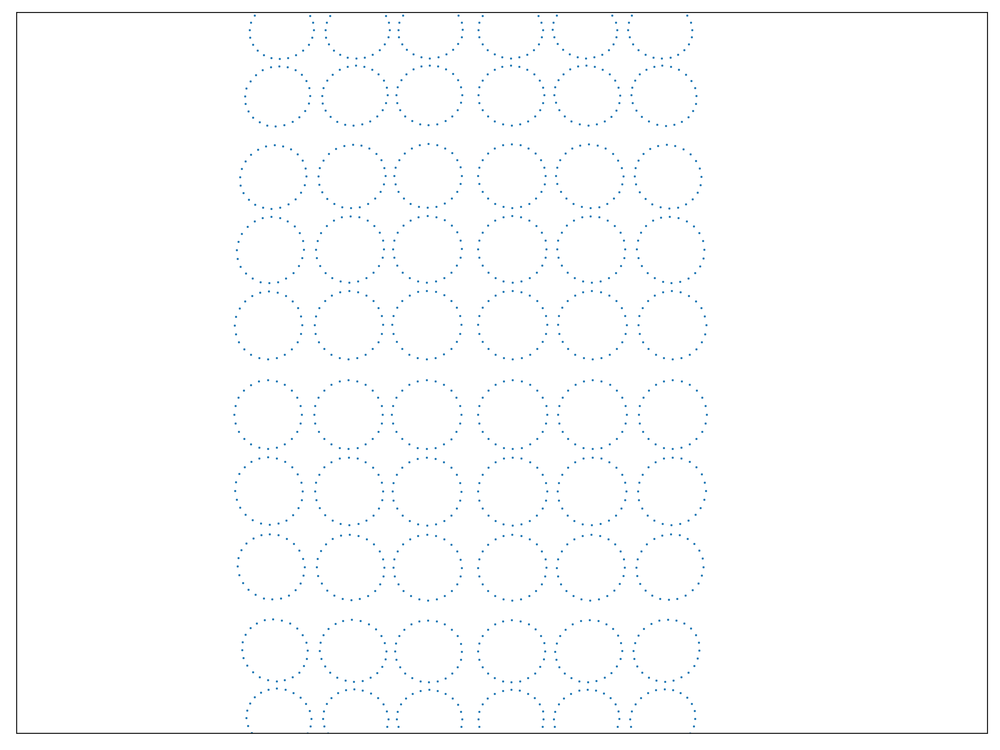

<IPython.core.display.Javascript object>


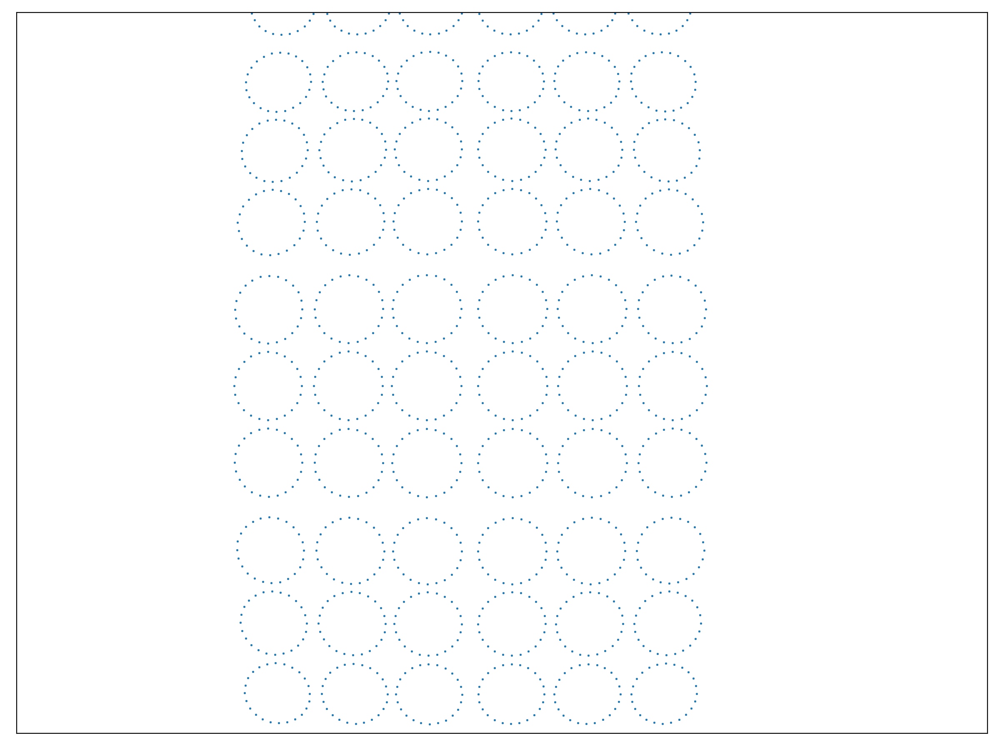

<IPython.core.display.Javascript object>


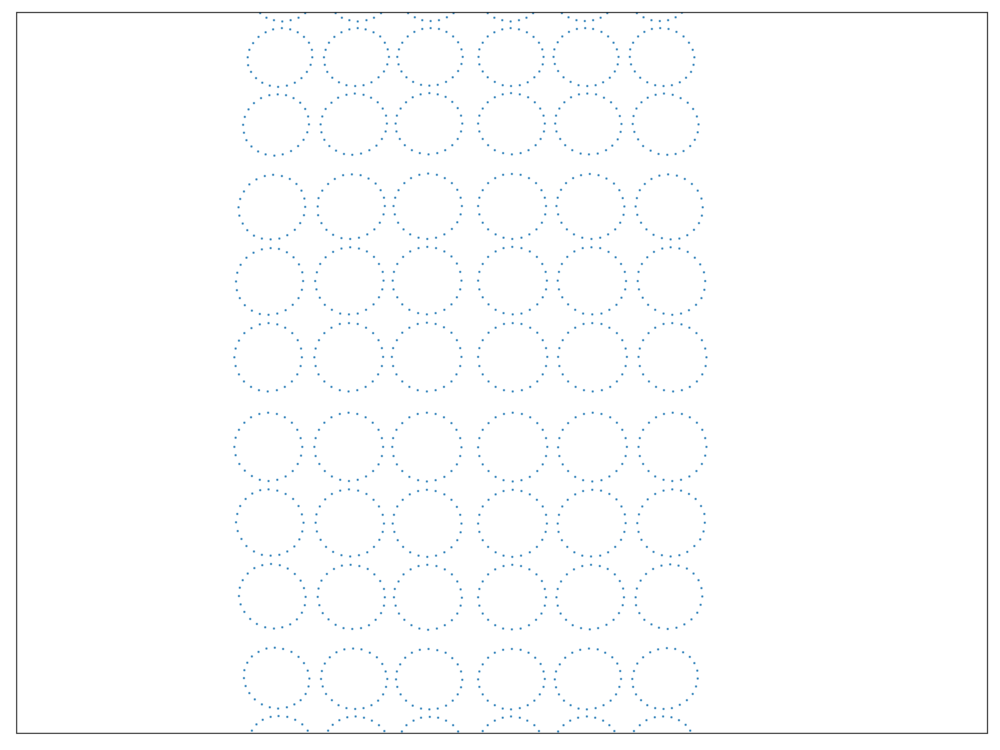

<IPython.core.display.Javascript object>


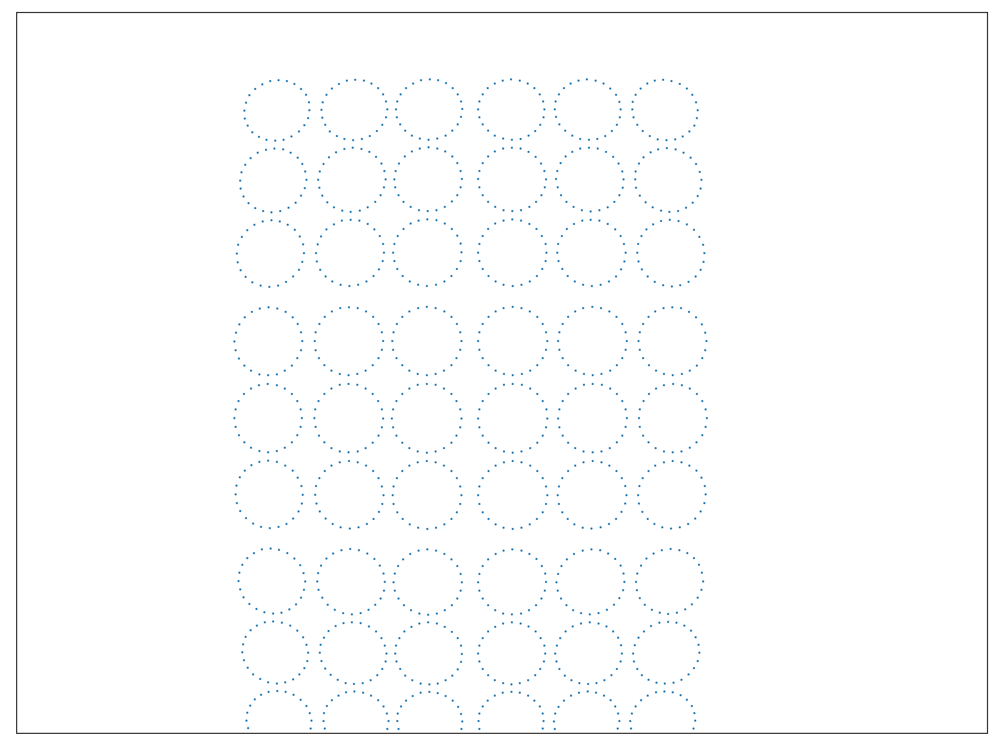

In [19]:
bolt_count = 24
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

<IPython.core.display.Javascript object>


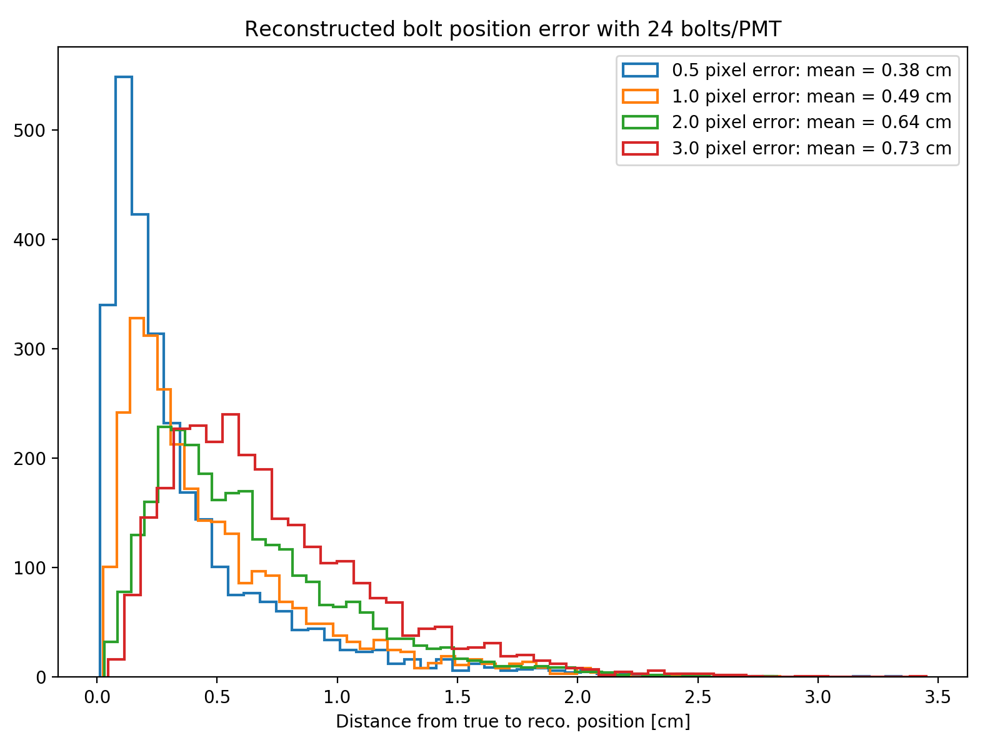

<IPython.core.display.Javascript object>


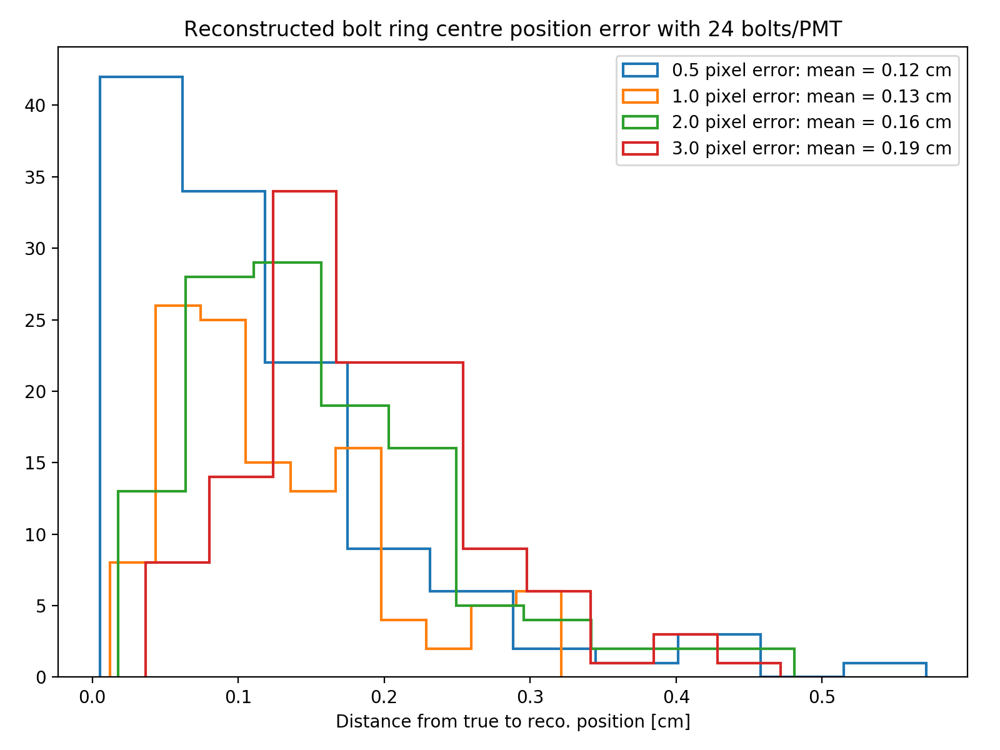

<IPython.core.display.Javascript object>


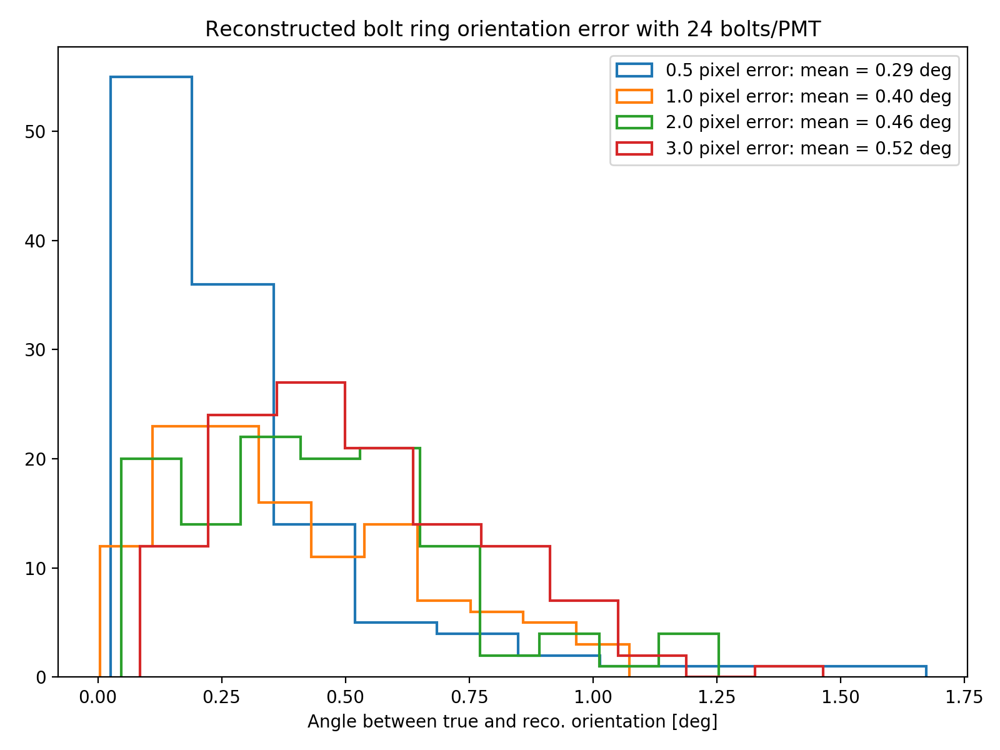

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 890, 6: 724, 4: 462, 3: 438, 2: 264, 1: 102})
image 0 reprojection errors:    average: 5.9403369230447405    max: 17.944738616691534
image 1 reprojection errors:    average: 5.997101373302411    max: 17.589455268322716
image 2 reprojection errors:    average: 6.03631495779861    max: 18.28467796064621
image 3 reprojection errors:    average: 5.836629191574895    max: 18.083714245656484
image 4 reprojection errors:    average: 5.884591787906493    max: 17.725394434066832
image 5 reprojection errors:    average: 5.878401178333885    max: 18.6829118571422
image 6 reprojection errors:    average: 5.87755778484509    max: 19.267382637547332
image 7 reprojection errors:    average: 5.8920312286347265    max: 19.244455622915122
image 8 reprojection errors:    average: 5.969827058288132    max: 18.125034772712812
image 9 reprojection errors:    average: 5.937399171952656    max: 19.028245268517

<IPython.core.display.Javascript object>


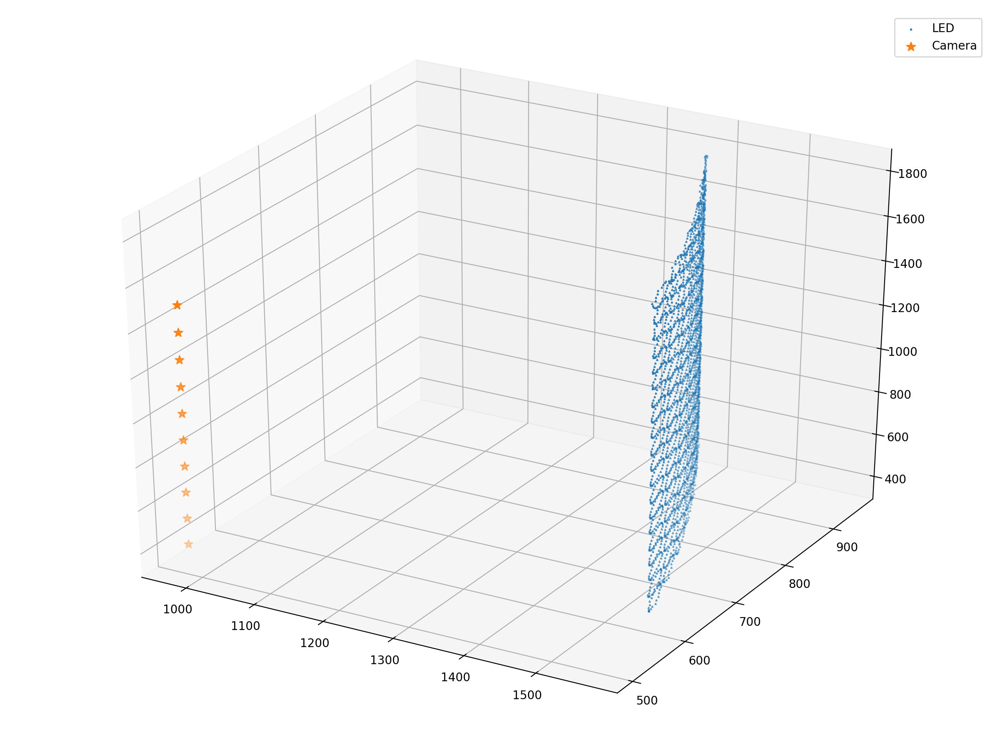

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 891, 6: 723, 4: 462, 3: 438, 2: 264, 1: 102})
image 0 reprojection errors:    average: 5.878101036925748    max: 19.041243873308044
image 1 reprojection errors:    average: 6.135103603688513    max: 18.379419875944517
image 2 reprojection errors:    average: 6.021060884053659    max: 20.972823576146777
image 3 reprojection errors:    average: 5.813549021645228    max: 21.037677809096426
image 4 reprojection errors:    average: 5.854246488128489    max: 20.956260479817388
image 5 reprojection errors:    average: 5.89437861861775    max: 21.532951641040125
image 6 reprojection errors:    average: 5.850928135642644    max: 21.0505996328224
image 7 reprojection errors:    average: 5.900391051116233    max: 22.200516701462025
image 8 reprojection errors:    average: 5.910596613125926    max: 22.285166563518313
image 9 reprojection errors:    average: 5.918708364523032    max: 20.400383457276

<IPython.core.display.Javascript object>


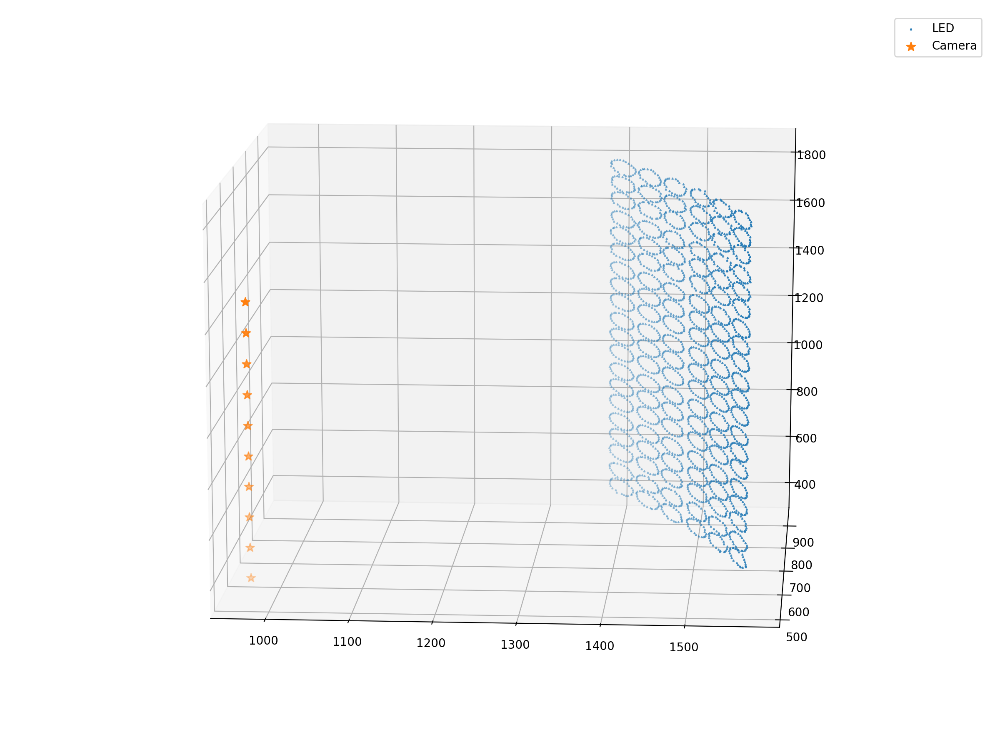

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 895, 6: 719, 4: 462, 3: 438, 2: 262, 1: 104})
image 0 reprojection errors:    average: 6.346881379357669    max: 21.156280509689253
image 1 reprojection errors:    average: 6.385494426193207    max: 18.654425746222792
image 2 reprojection errors:    average: 6.4135861239129275    max: 18.69672715007323
image 3 reprojection errors:    average: 6.457311529064962    max: 18.667667286707772
image 4 reprojection errors:    average: 6.4410379079597035    max: 22.095816949236706
image 5 reprojection errors:    average: 6.40415372739125    max: 20.290319386991694
image 6 reprojection errors:    average: 6.421429360993292    max: 21.969905105648223
image 7 reprojection errors:    average: 6.399330097761283    max: 19.971495907461893
image 8 reprojection errors:    average: 6.331031534866723    max: 19.70939223342806
image 9 reprojection errors:    average: 6.274287159369864    max: 18.3285561871

<IPython.core.display.Javascript object>


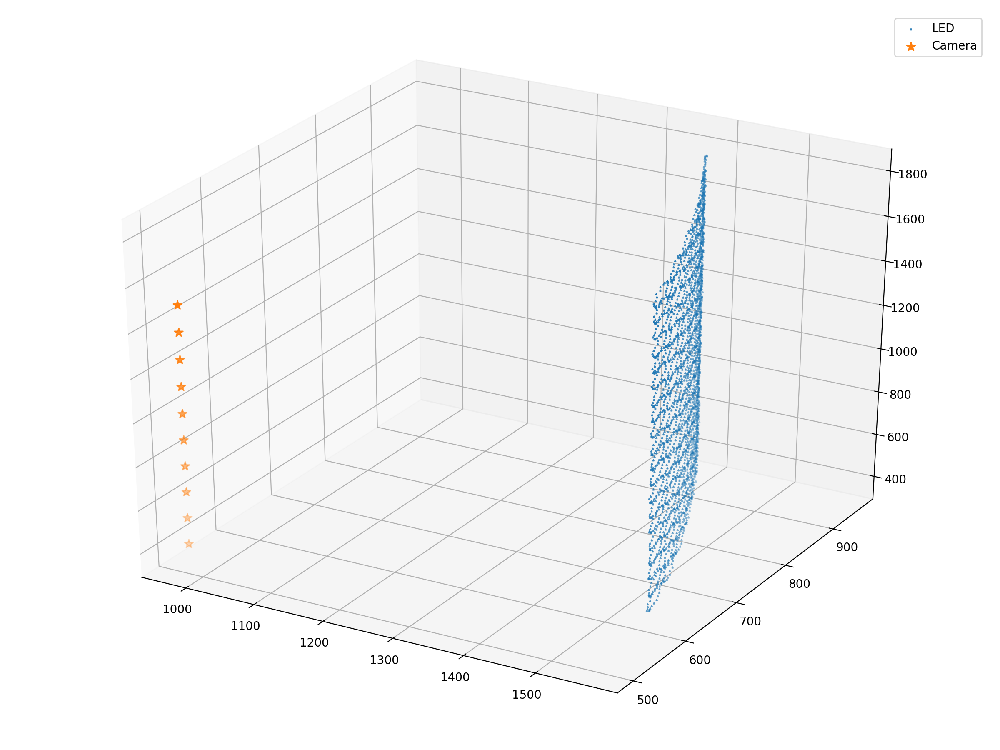

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 897, 6: 717, 4: 462, 3: 437, 2: 262, 1: 105})
image 0 reprojection errors:    average: 6.588747128673774    max: 20.724077293926474
image 1 reprojection errors:    average: 6.801580198153091    max: 22.275462477760403
image 2 reprojection errors:    average: 7.154096247711213    max: 25.28638760523966
image 3 reprojection errors:    average: 6.843522105440536    max: 20.32604052569124
image 4 reprojection errors:    average: 6.6811771369074755    max: 24.01725597188481
image 5 reprojection errors:    average: 6.708400004997777    max: 21.040292701965793
image 6 reprojection errors:    average: 6.677035608115756    max: 20.717519131950205
image 7 reprojection errors:    average: 6.797726928278497    max: 21.253671551390354
image 8 reprojection errors:    average: 6.636473659179963    max: 20.183516014468715
image 9 reprojection errors:    average: 6.623558113894902    max: 19.96429634862

<IPython.core.display.Javascript object>


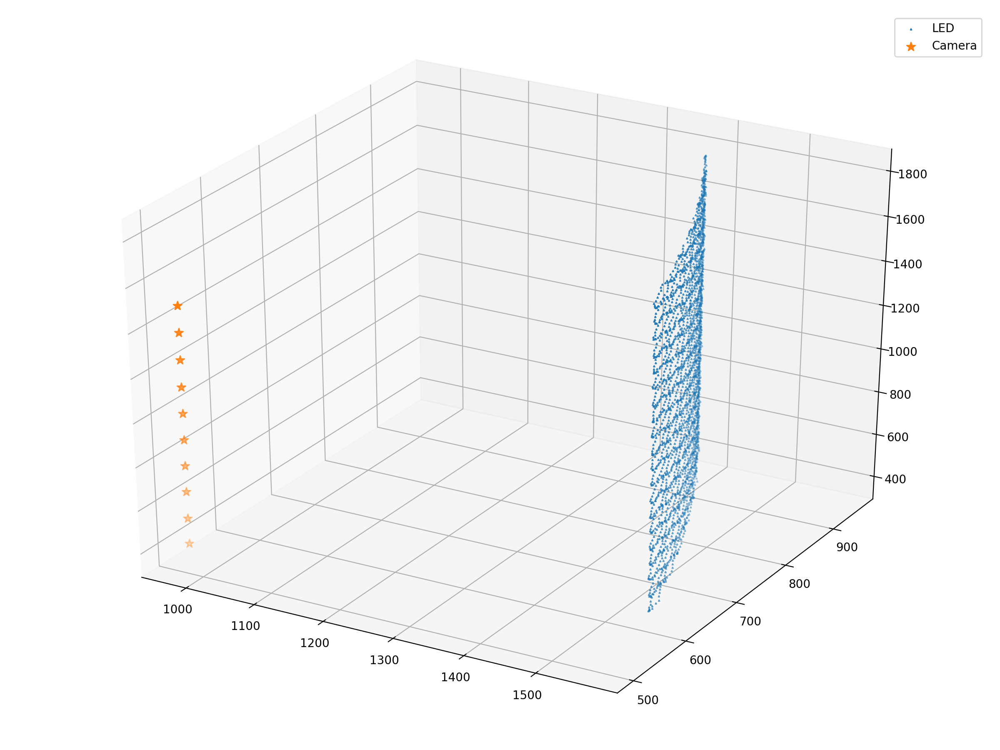

In [20]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=50, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 12 bolts

Feature in image counts: Counter({5: 434, 6: 376, 4: 234, 3: 210, 2: 132, 1: 54})


<IPython.core.display.Javascript object>


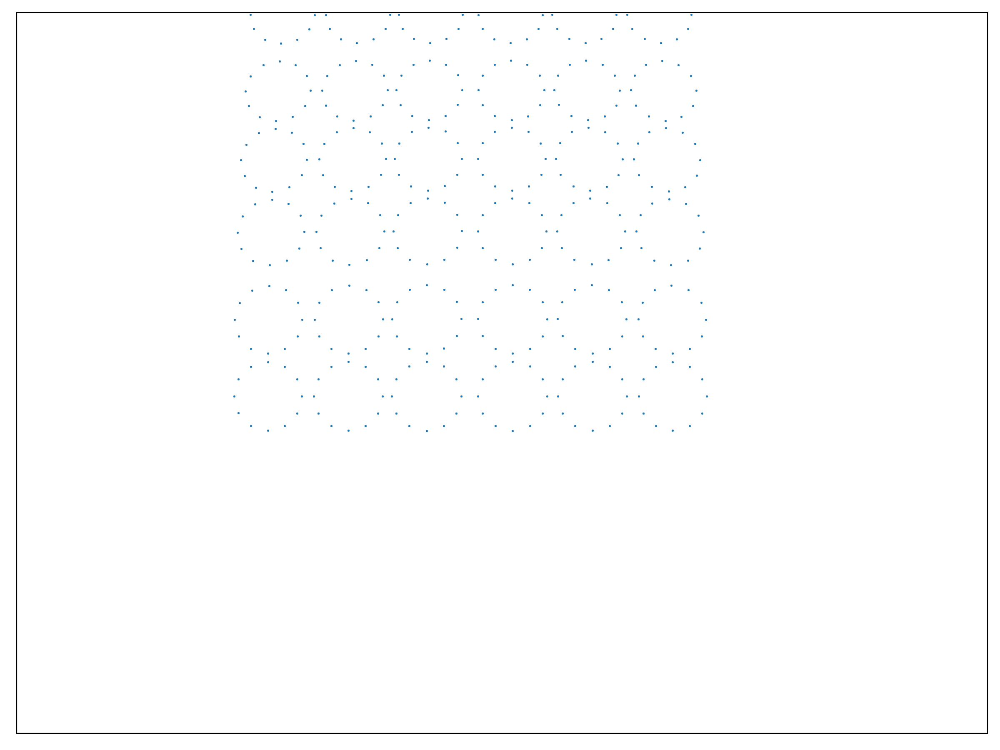

<IPython.core.display.Javascript object>


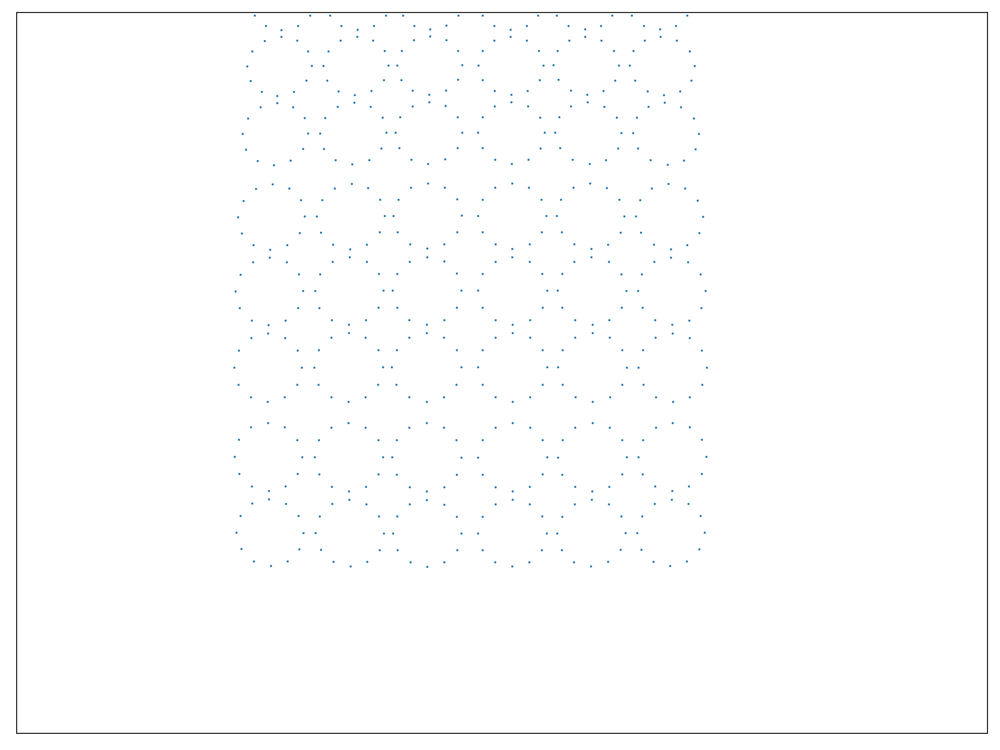

<IPython.core.display.Javascript object>


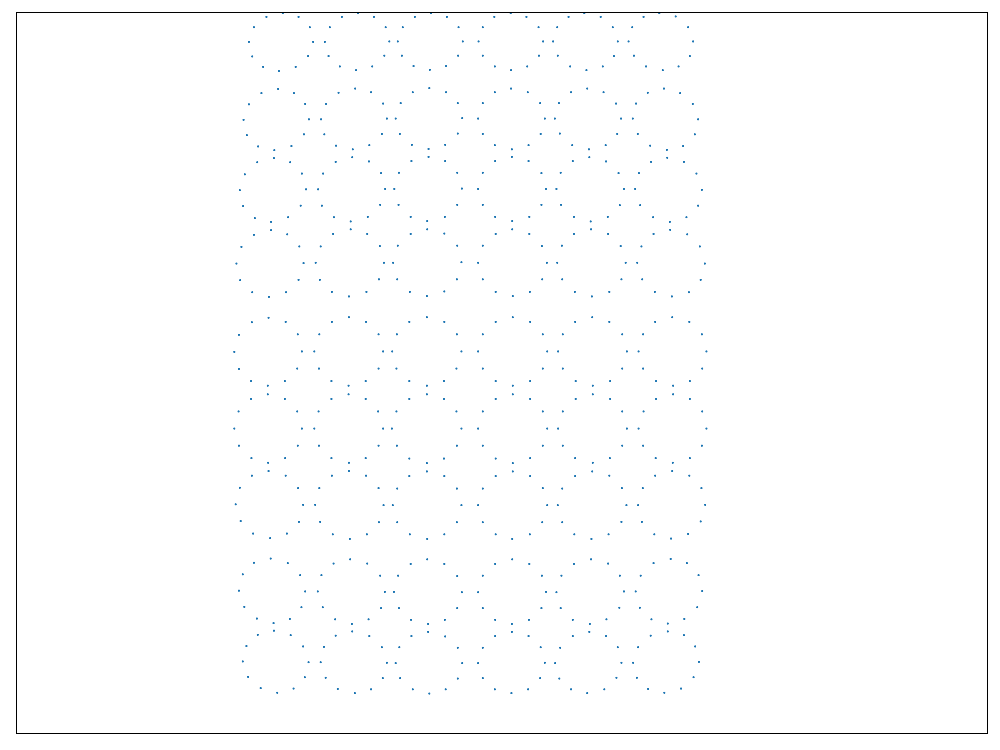

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


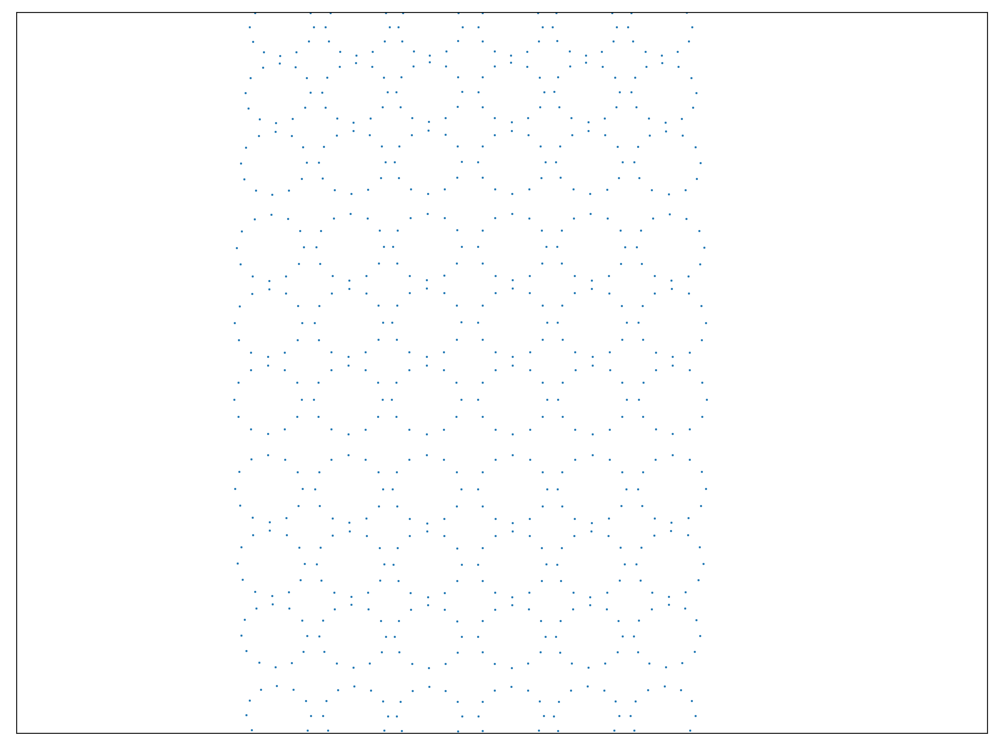

<IPython.core.display.Javascript object>


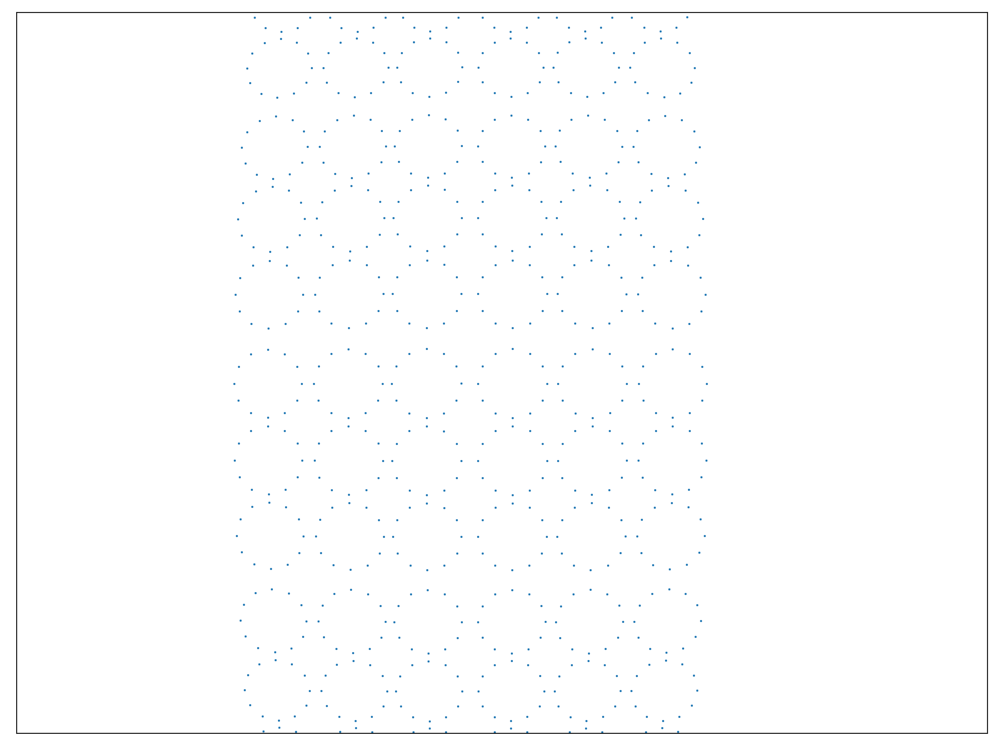

<IPython.core.display.Javascript object>


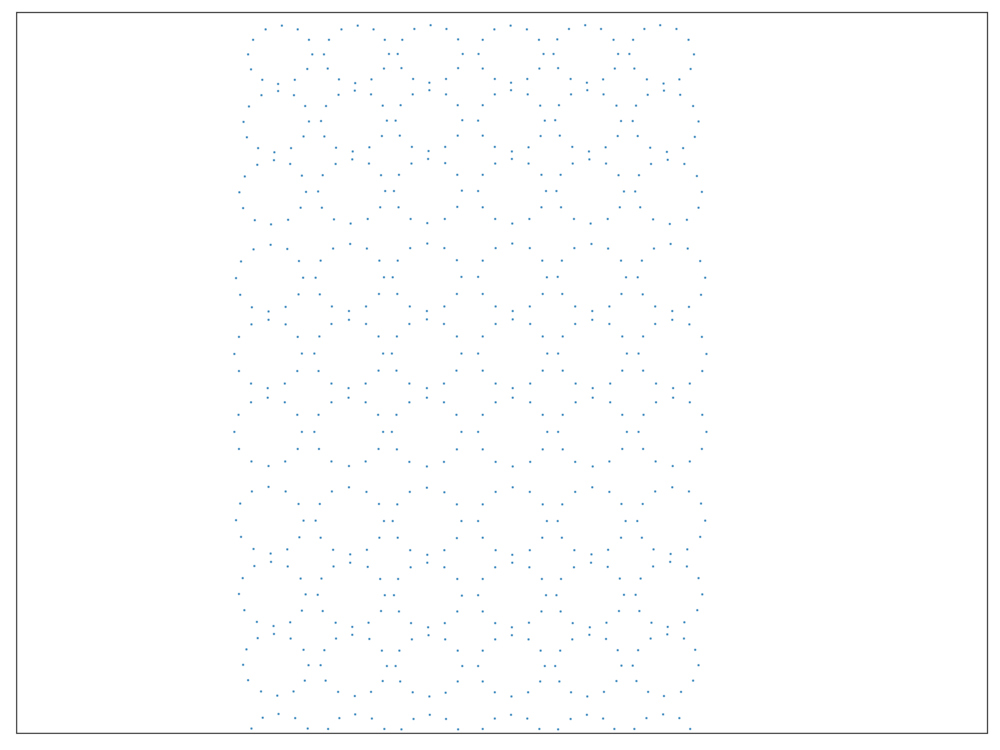

<IPython.core.display.Javascript object>


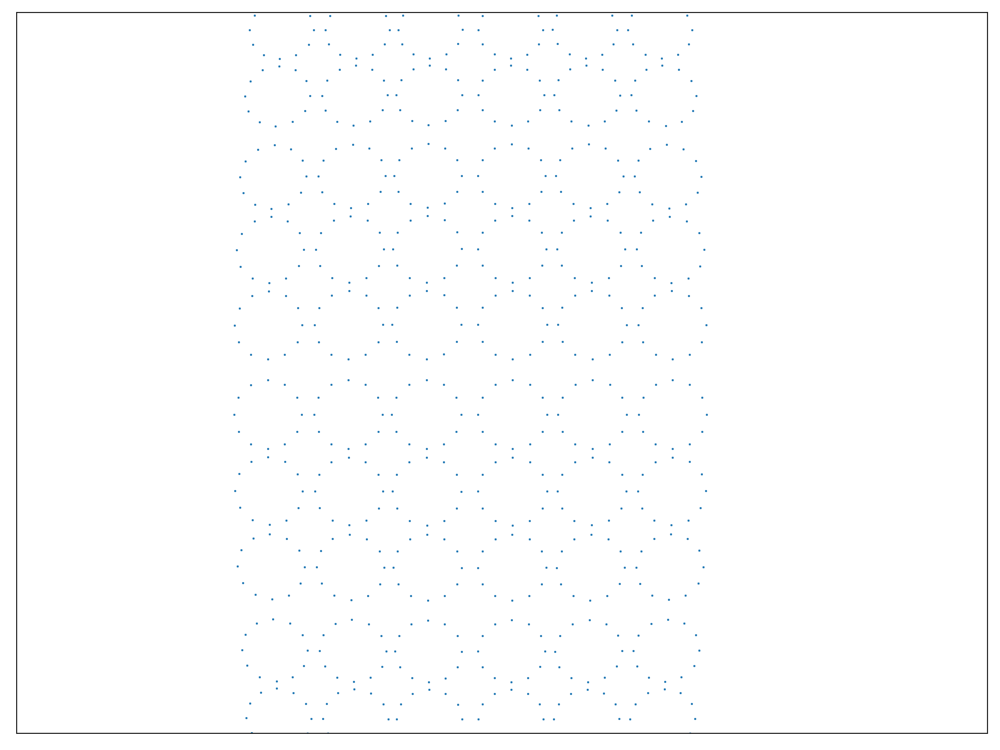

<IPython.core.display.Javascript object>


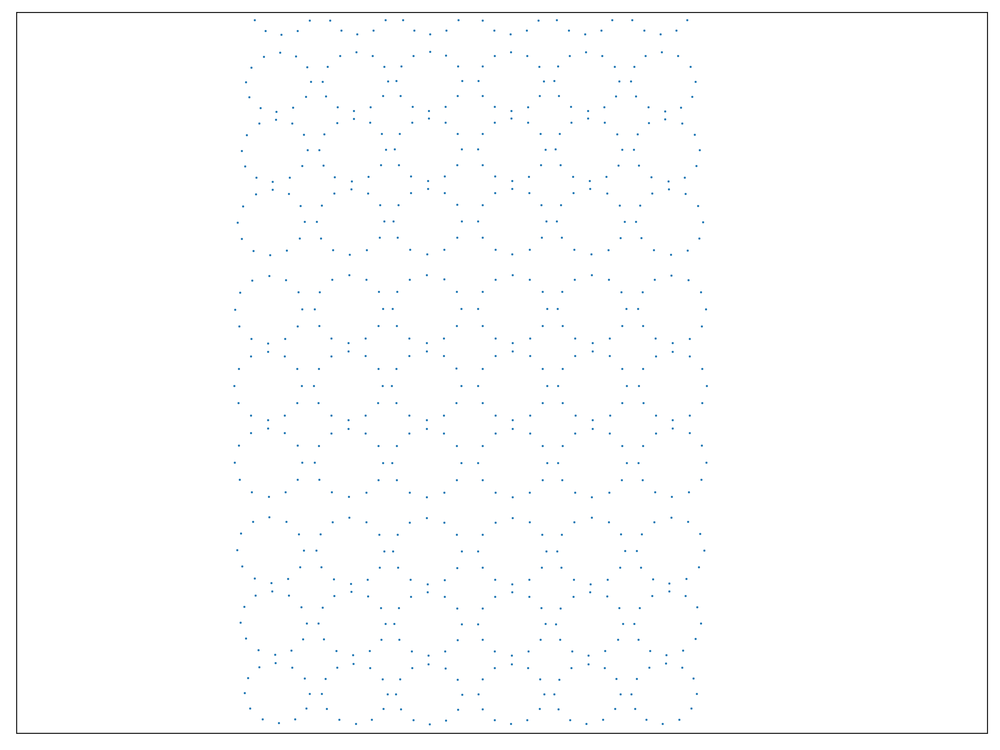

<IPython.core.display.Javascript object>


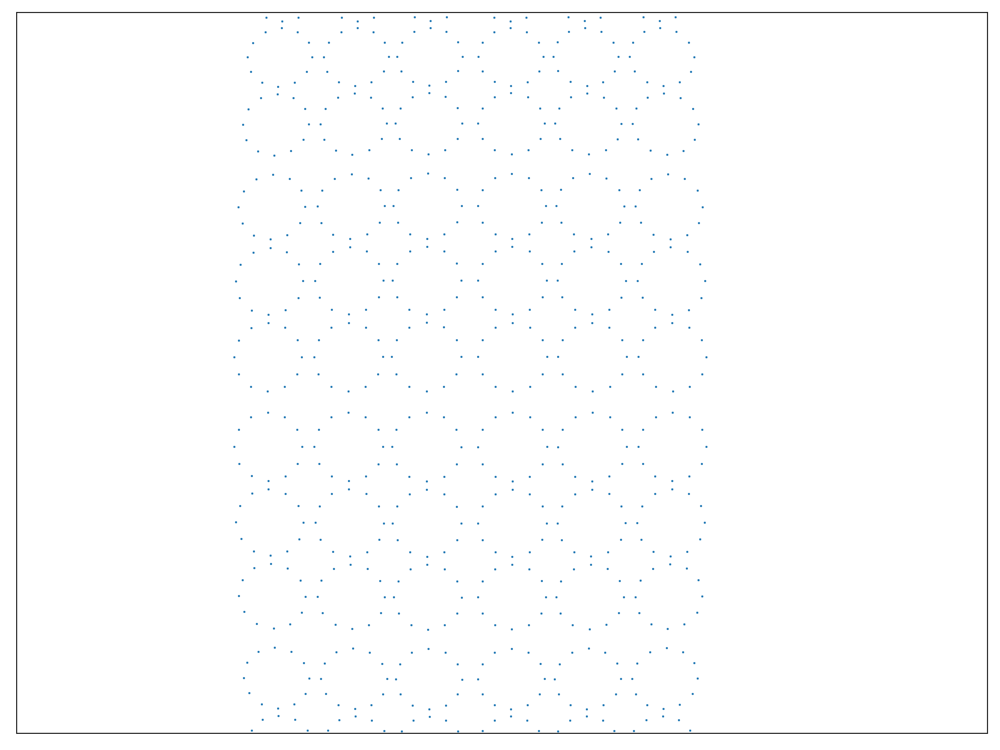

<IPython.core.display.Javascript object>


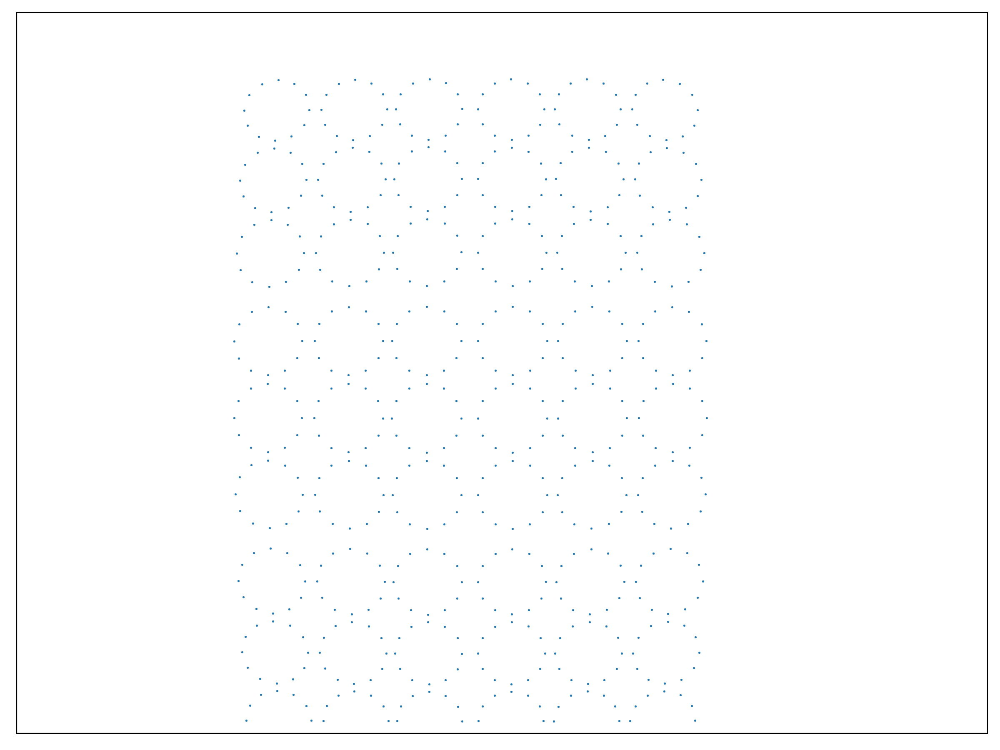

In [21]:
bolt_count = 12
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


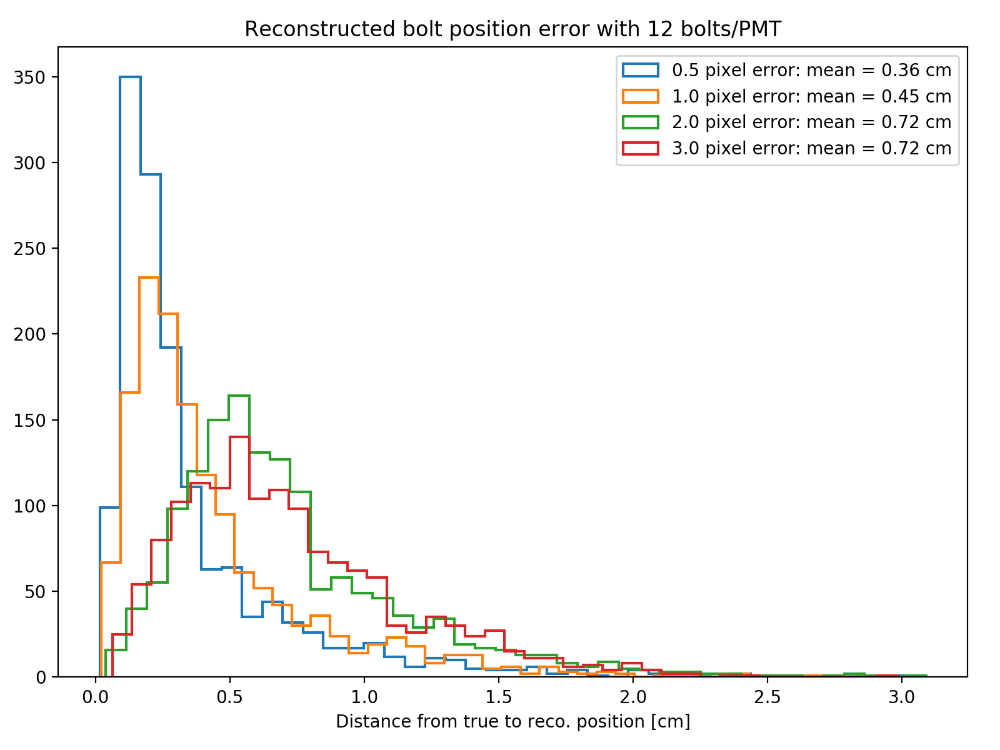

<IPython.core.display.Javascript object>


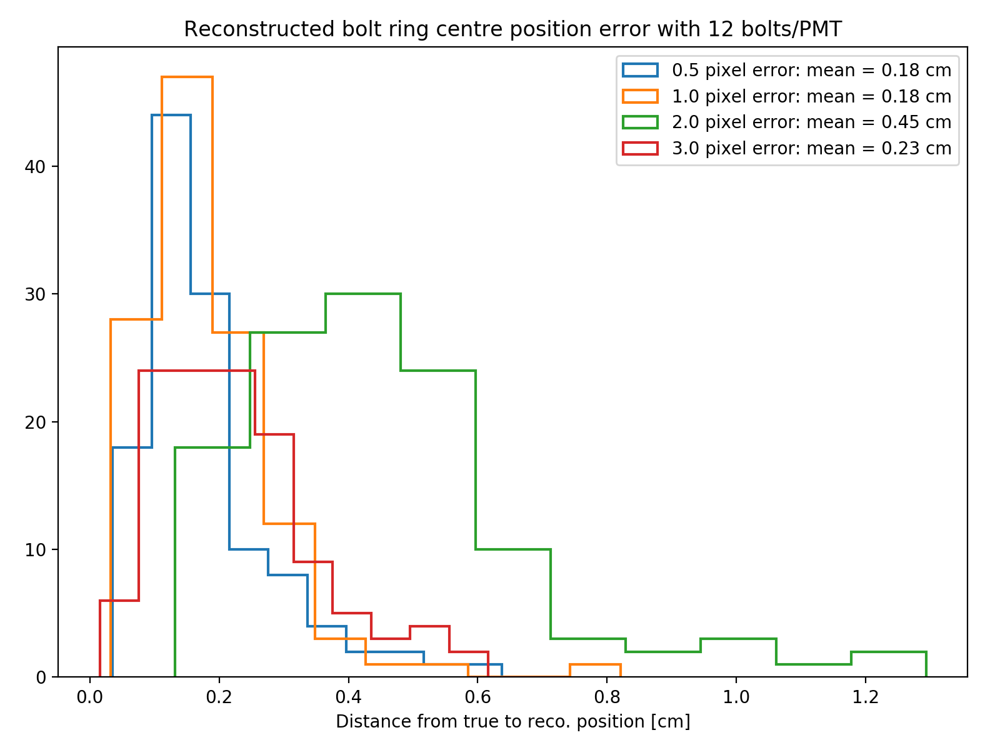

<IPython.core.display.Javascript object>


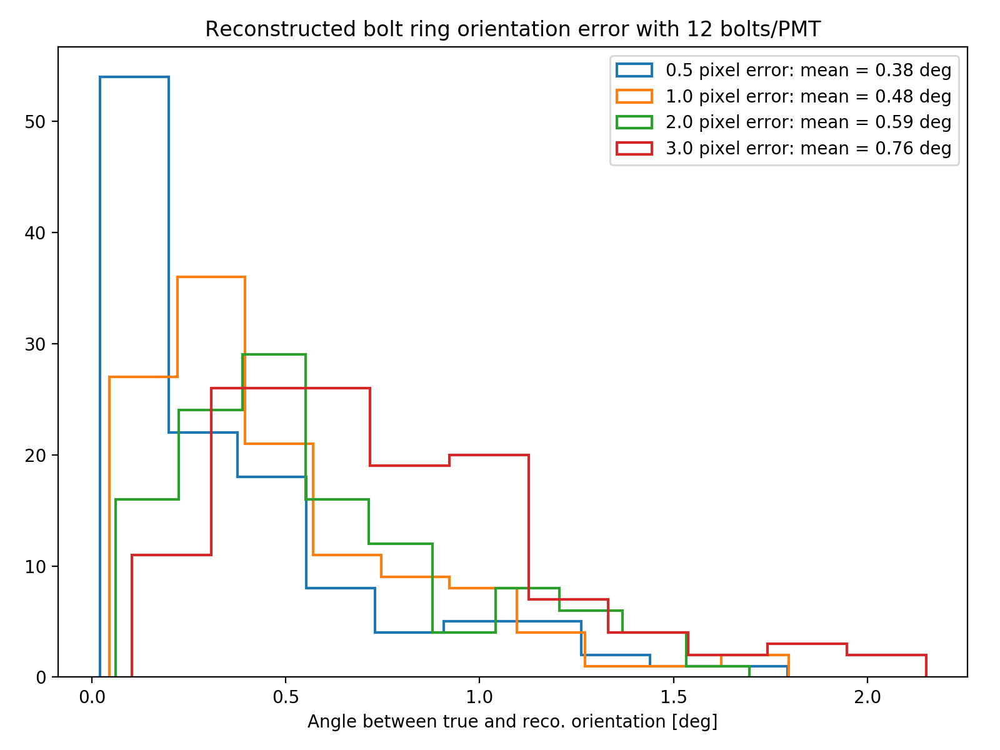

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 435, 6: 375, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 5.700032868965798    max: 17.47181070104142
image 1 reprojection errors:    average: 5.901509536246702    max: 17.36062920357745
image 2 reprojection errors:    average: 6.098315885119374    max: 19.481329828676532
image 3 reprojection errors:    average: 6.095405072641399    max: 16.900931882000176
image 4 reprojection errors:    average: 6.189783579472133    max: 17.49592048754406
image 5 reprojection errors:    average: 6.068923939273338    max: 16.337390873745345
image 6 reprojection errors:    average: 5.963493164477869    max: 17.231511639273428
image 7 reprojection errors:    average: 5.888708271881412    max: 15.233257433700098
image 8 reprojection errors:    average: 5.809195919238002    max: 16.435749360405442
image 9 reprojection errors:    average: 5.742386621951446    max: 16.3729374445895

<IPython.core.display.Javascript object>


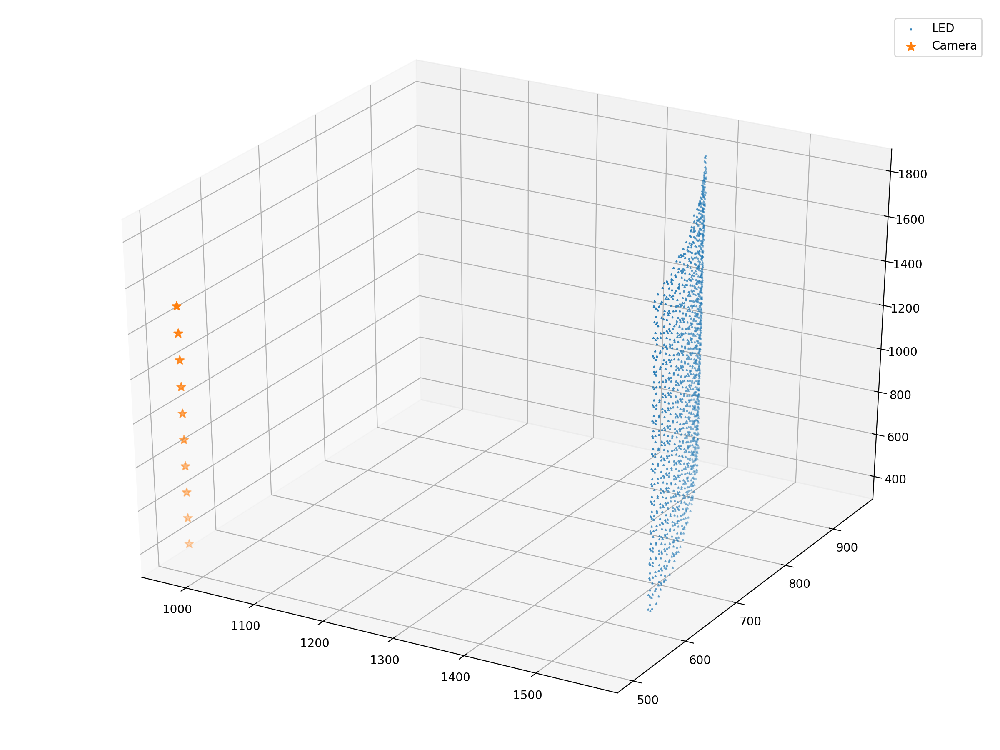

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 436, 6: 374, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 5.856312502984706    max: 14.298120360310572
image 1 reprojection errors:    average: 5.909672612241445    max: 15.559131124315448
image 2 reprojection errors:    average: 6.0307734120682435    max: 16.34071385441829
image 3 reprojection errors:    average: 5.9365388152985785    max: 16.990240303665274
image 4 reprojection errors:    average: 5.883246896371533    max: 16.52887763335755
image 5 reprojection errors:    average: 6.0830927552799015    max: 17.25896154181428
image 6 reprojection errors:    average: 5.83908731847466    max: 16.003892186309344
image 7 reprojection errors:    average: 5.997123680987487    max: 17.51817398691934
image 8 reprojection errors:    average: 5.967374420710065    max: 18.078926586015726
image 9 reprojection errors:    average: 5.929727315090125    max: 16.458101864275

<IPython.core.display.Javascript object>


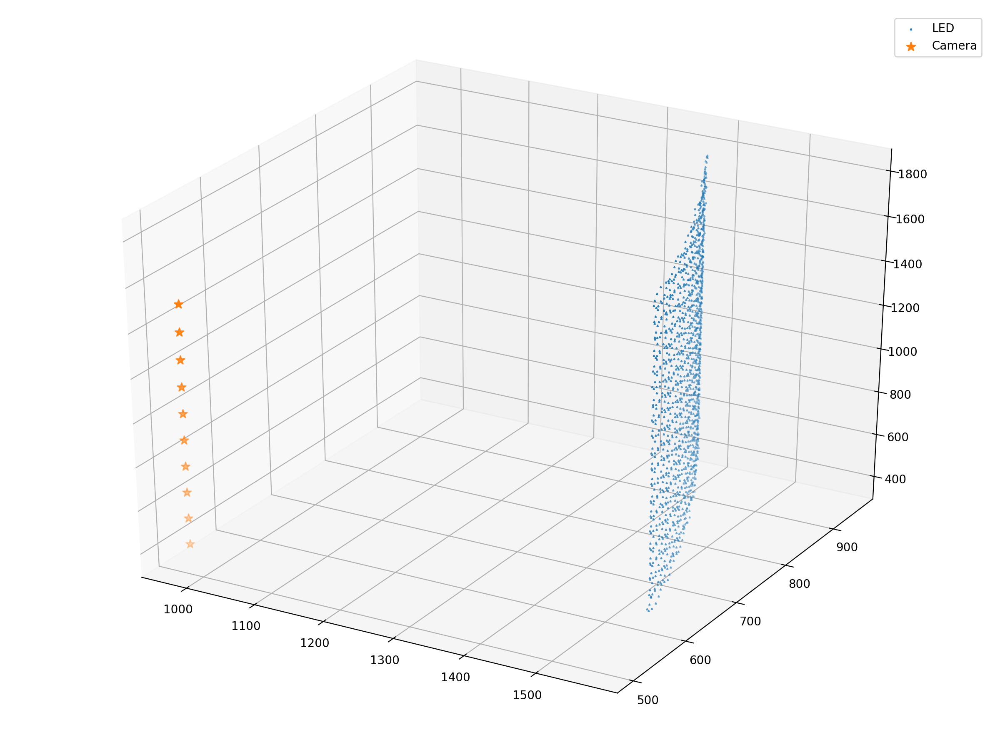

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 439, 6: 371, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 6.183361851513966    max: 17.338221775001294
image 1 reprojection errors:    average: 6.332317041630057    max: 17.4226614092855
image 2 reprojection errors:    average: 6.255220168524731    max: 19.544306617755506
image 3 reprojection errors:    average: 6.394669435149193    max: 20.492247149319475
image 4 reprojection errors:    average: 6.222913198376446    max: 17.16135930706496
image 5 reprojection errors:    average: 6.520657220795884    max: 16.951622739461406
image 6 reprojection errors:    average: 7.192418508096409    max: 21.452008772861834
image 7 reprojection errors:    average: 7.09123476441259    max: 22.443318207532975
image 8 reprojection errors:    average: 6.950006535242879    max: 20.24626271683392
image 9 reprojection errors:    average: 6.535580620092415    max: 18.31901442065739


<IPython.core.display.Javascript object>


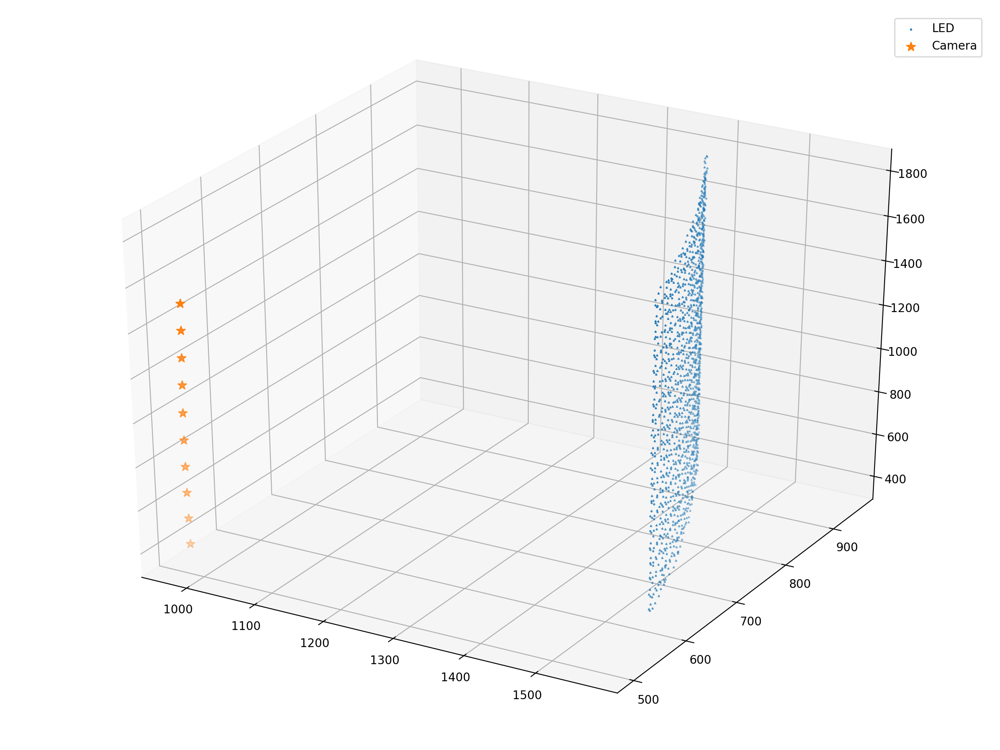

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 440, 6: 370, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 6.434179781603915    max: 17.260965393692516
image 1 reprojection errors:    average: 6.553951020311259    max: 19.348487617156287
image 2 reprojection errors:    average: 6.780210052473535    max: 19.658009000454676
image 3 reprojection errors:    average: 6.625190278189027    max: 21.509964384893866
image 4 reprojection errors:    average: 6.582864518816968    max: 19.391022592752712
image 5 reprojection errors:    average: 6.801901037069868    max: 18.8301929404988
image 6 reprojection errors:    average: 6.790700180504266    max: 20.550608384884793
image 7 reprojection errors:    average: 6.670190744697126    max: 21.70249884783435
image 8 reprojection errors:    average: 6.594553422166394    max: 20.088785078027676
image 9 reprojection errors:    average: 6.560556391080233    max: 18.4252191104081

<IPython.core.display.Javascript object>


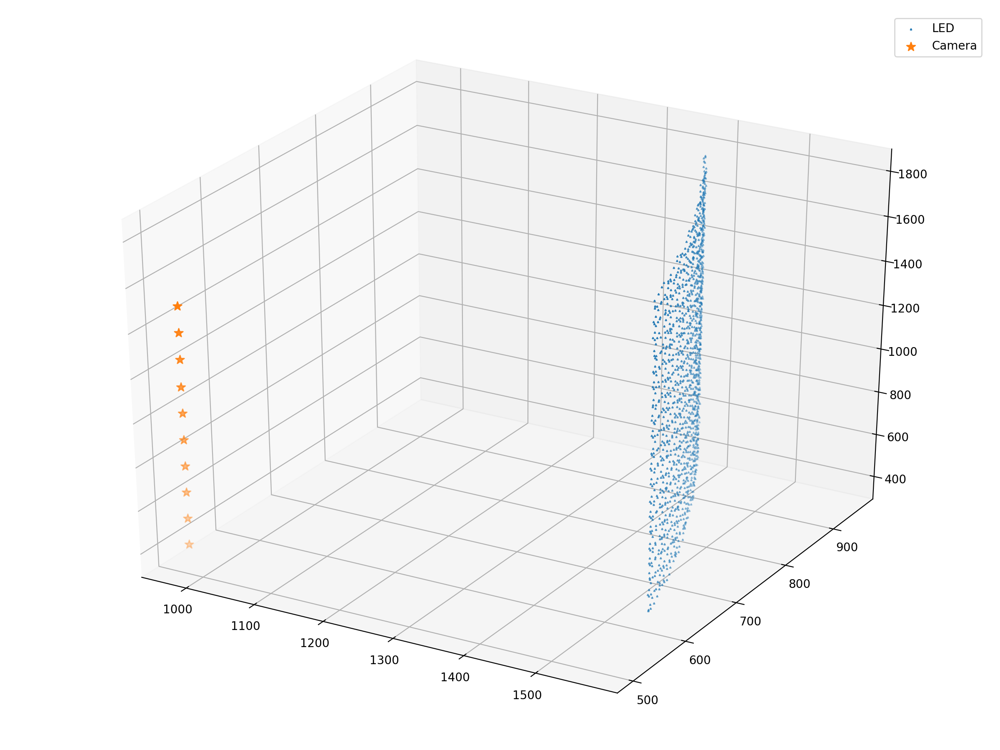

In [22]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=40, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 8 bolts

Feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 96, 1: 30})


<IPython.core.display.Javascript object>


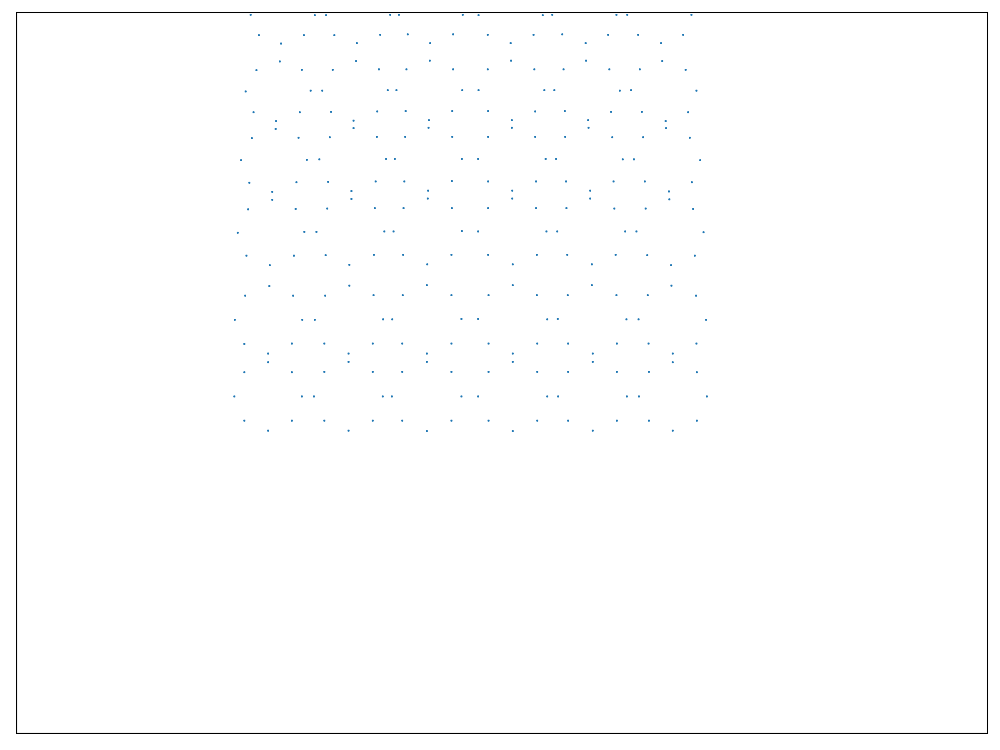

<IPython.core.display.Javascript object>


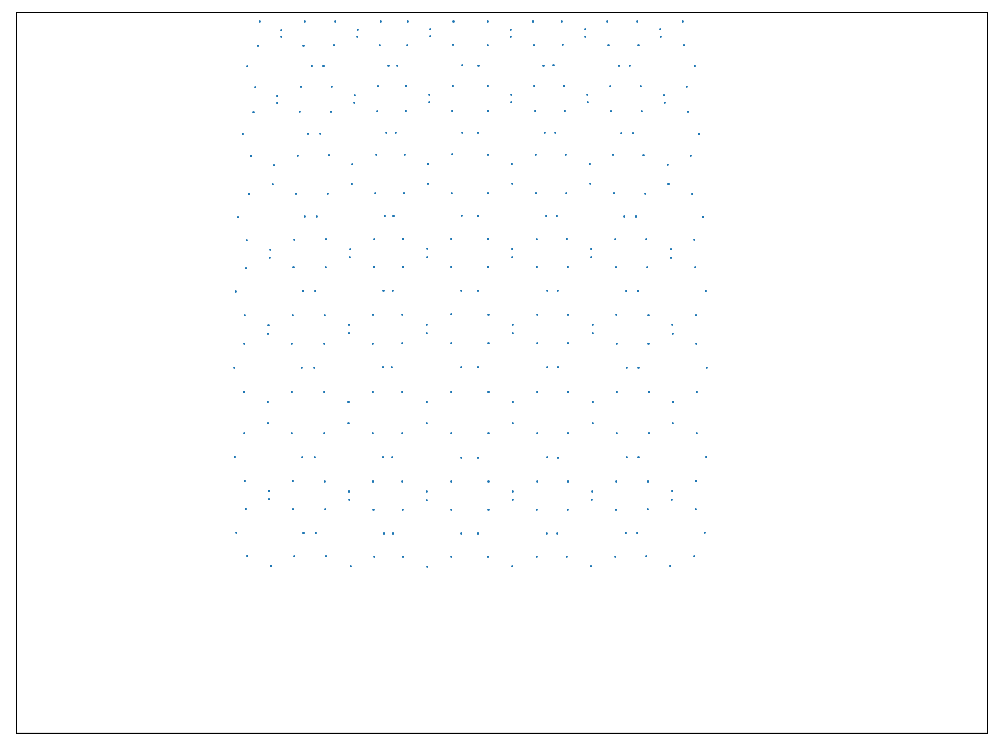

<IPython.core.display.Javascript object>


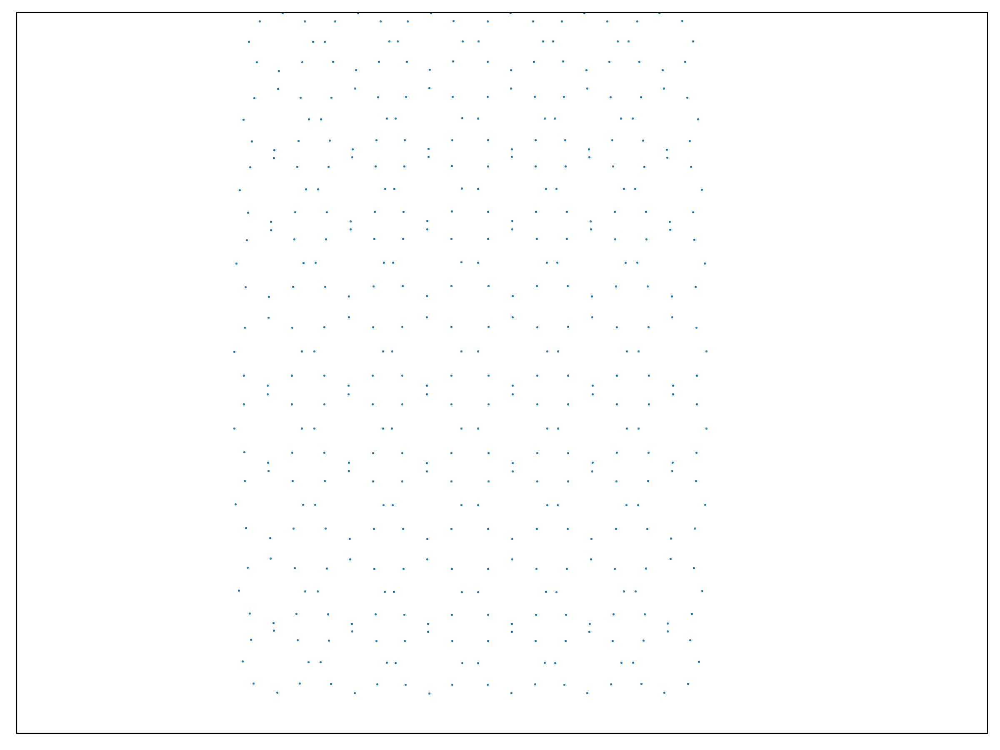

<IPython.core.display.Javascript object>


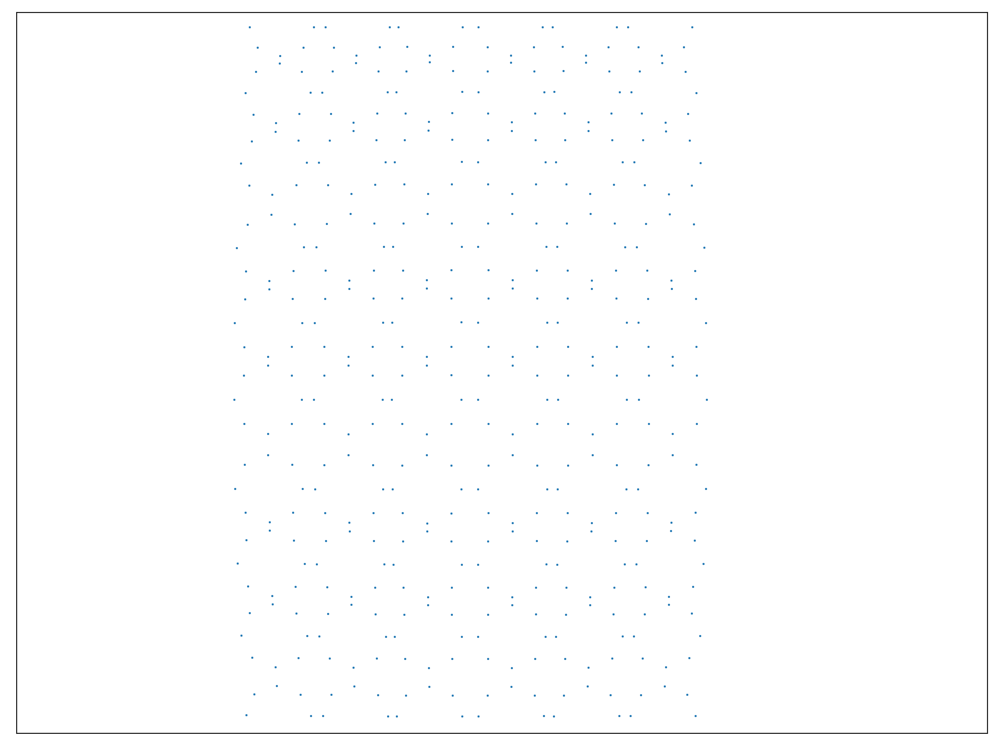

<IPython.core.display.Javascript object>


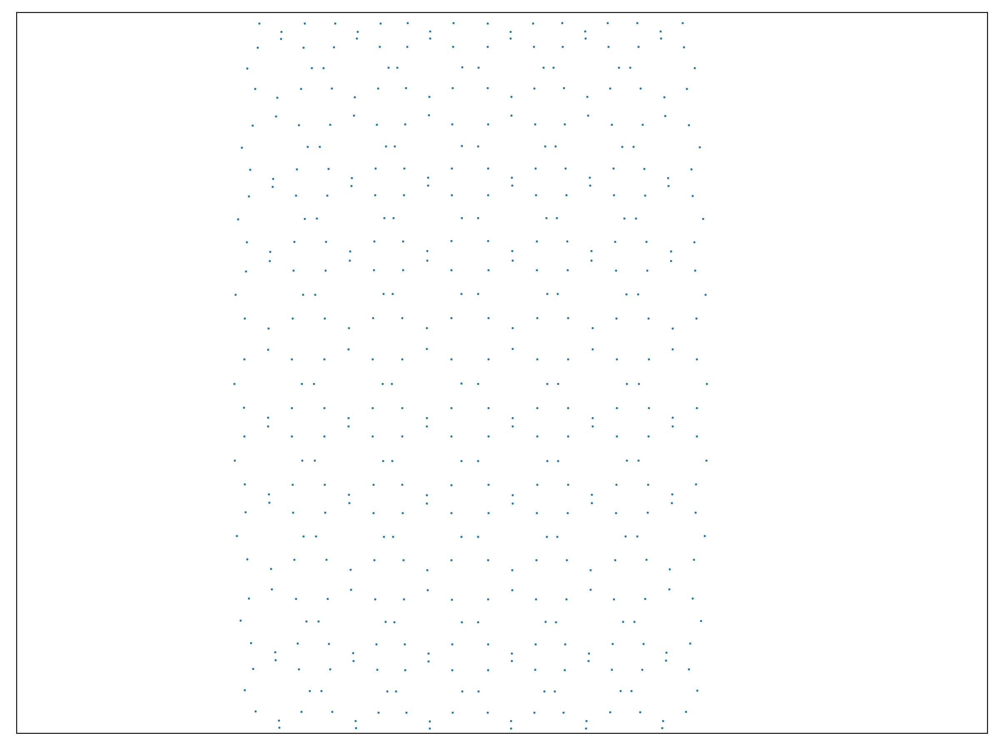

<IPython.core.display.Javascript object>


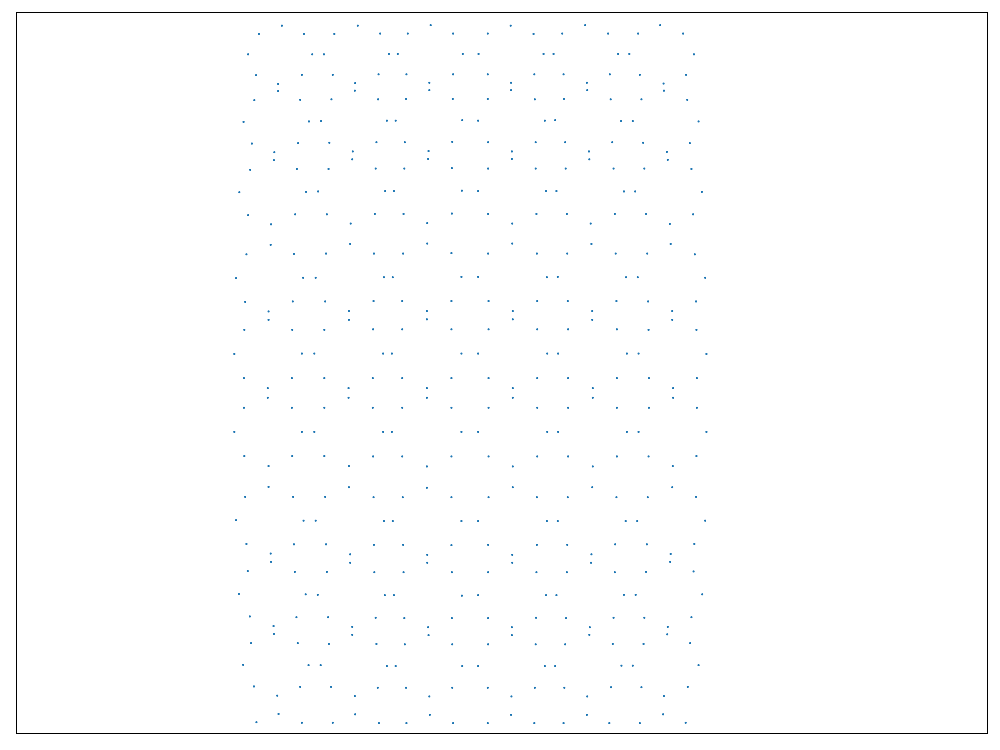

<IPython.core.display.Javascript object>


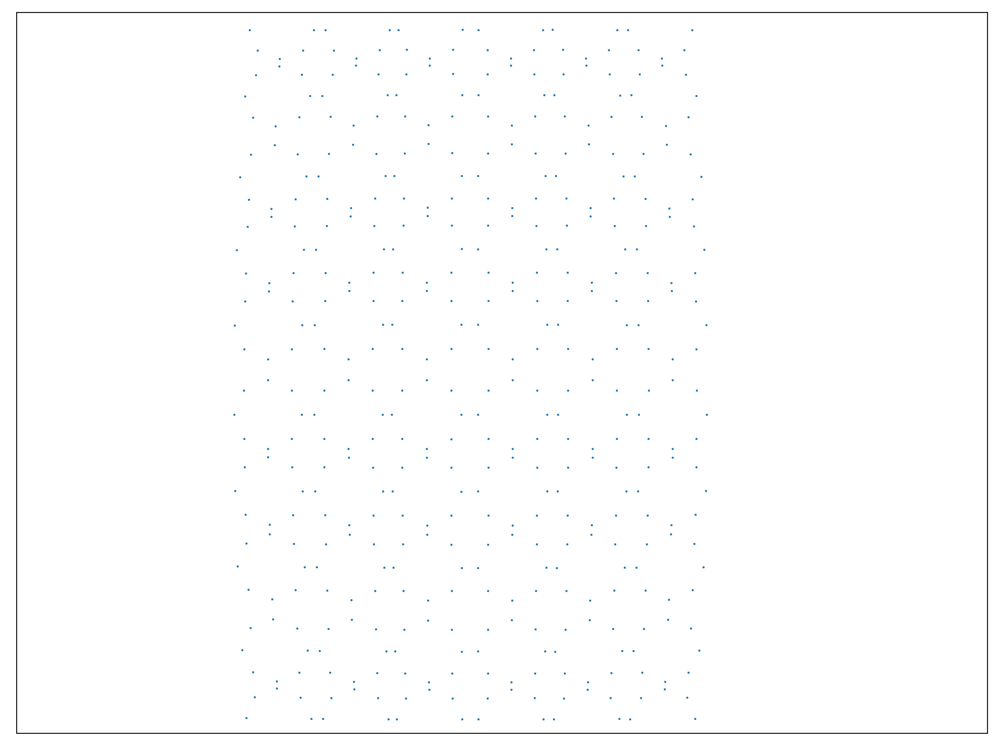

<IPython.core.display.Javascript object>


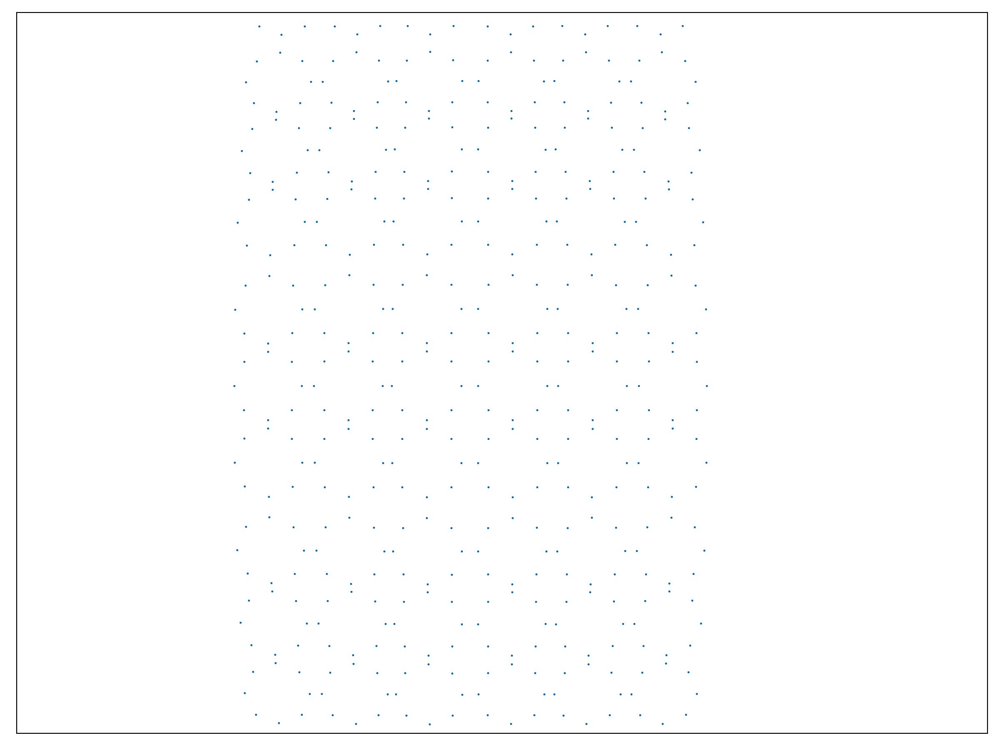

<IPython.core.display.Javascript object>


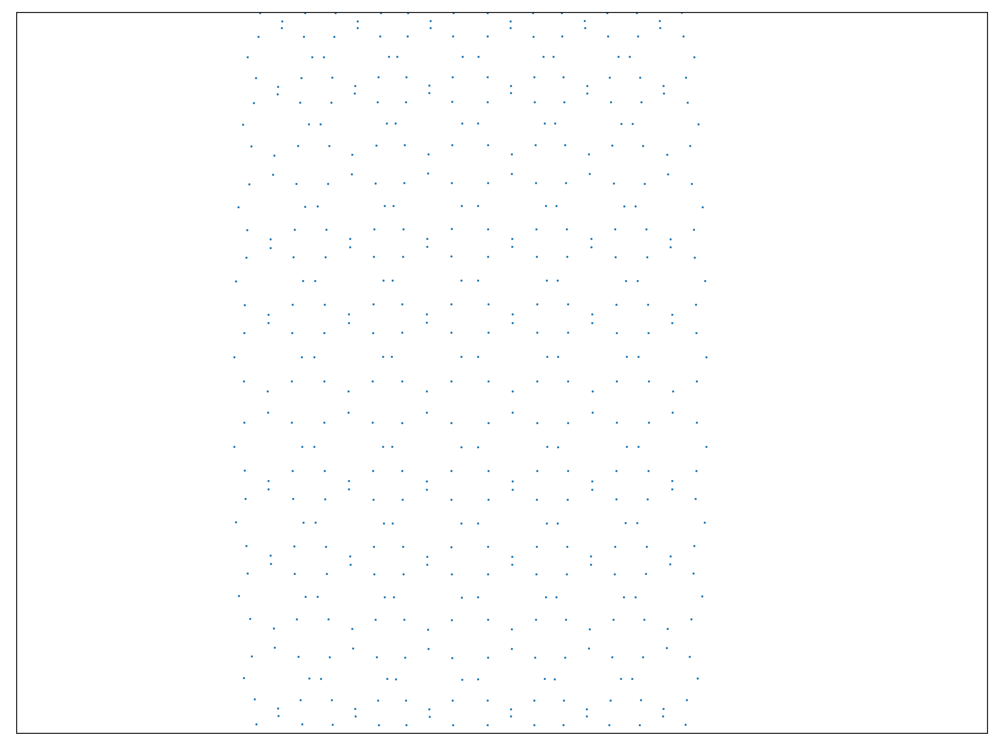

<IPython.core.display.Javascript object>


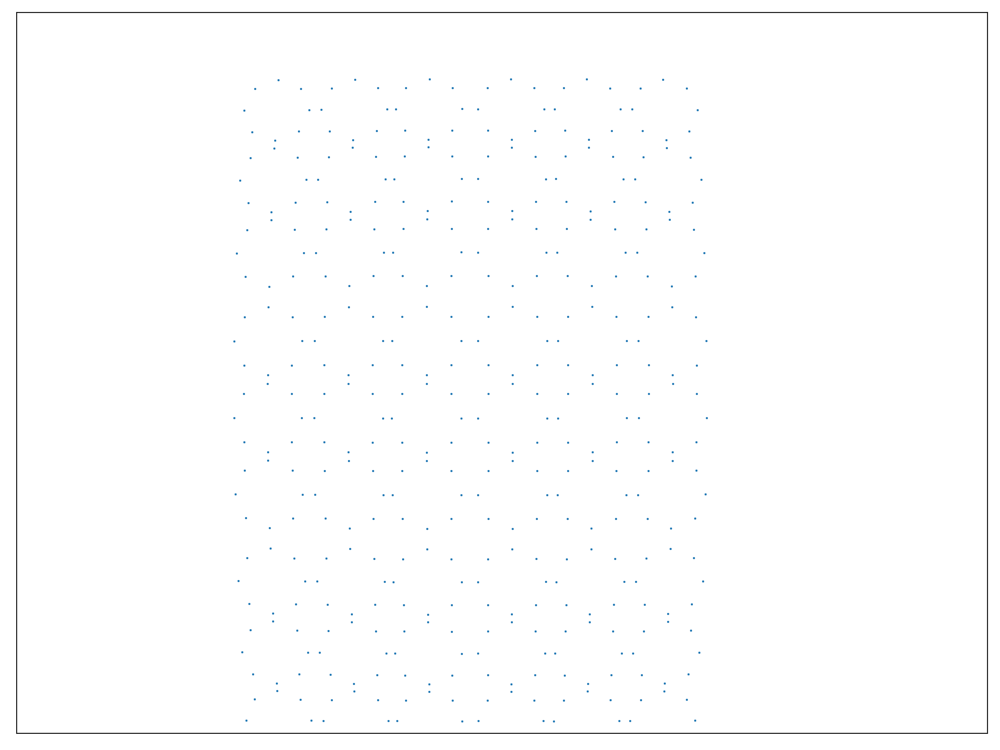

In [32]:
bolt_count = 8
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

<IPython.core.display.Javascript object>


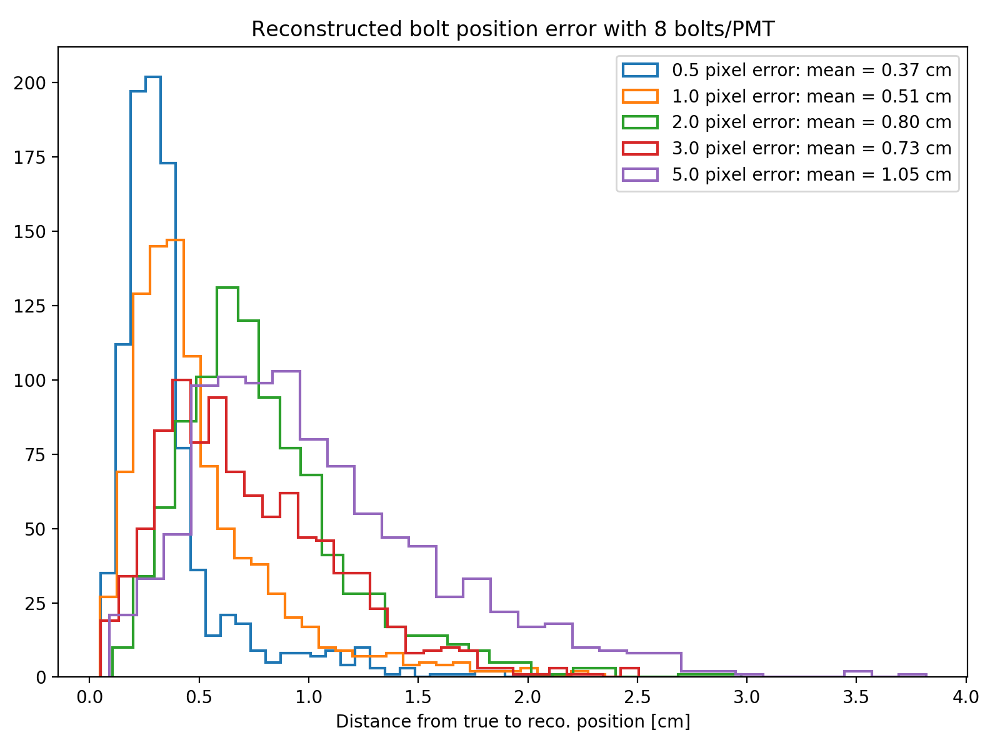

<IPython.core.display.Javascript object>


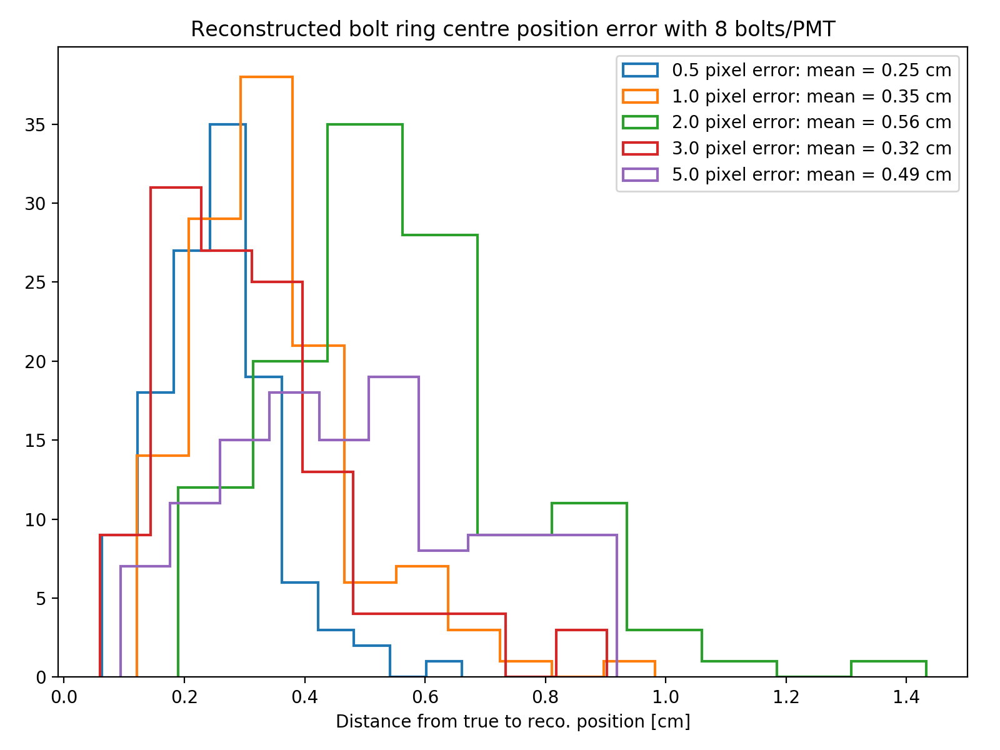

<IPython.core.display.Javascript object>


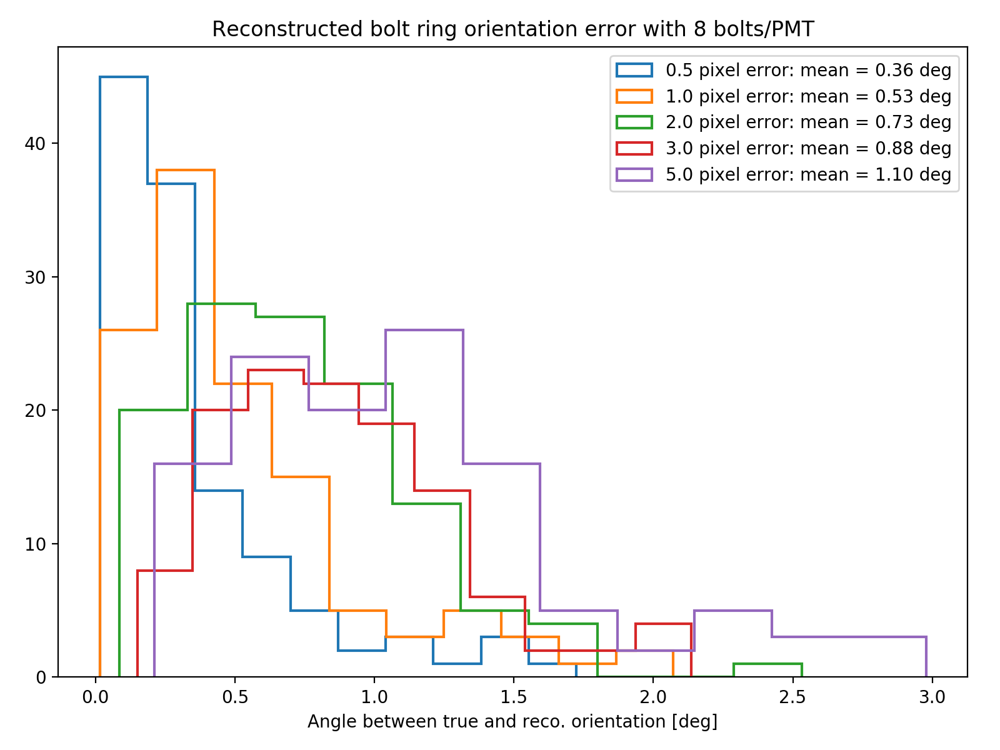

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 96, 1: 30})
image 0 reprojection errors:    average: 5.939990715503727    max: 18.10467005545883
image 1 reprojection errors:    average: 6.330923340655053    max: 18.48229539366841
image 2 reprojection errors:    average: 6.116799417257282    max: 16.58700486038209
image 3 reprojection errors:    average: 6.474817753535334    max: 18.451395937354523
image 4 reprojection errors:    average: 7.230710538567325    max: 21.67853136869424
image 5 reprojection errors:    average: 6.171083726748691    max: 17.2708106828813
image 6 reprojection errors:    average: 5.969329984442698    max: 18.246074086700958
image 7 reprojection errors:    average: 5.802292912785398    max: 17.184010070389302
image 8 reprojection errors:    average: 5.905424240793693    max: 17.09177618407128
image 9 reprojection errors:    average: 5.8565061245442305    max: 17.035891390485887
 

<IPython.core.display.Javascript object>


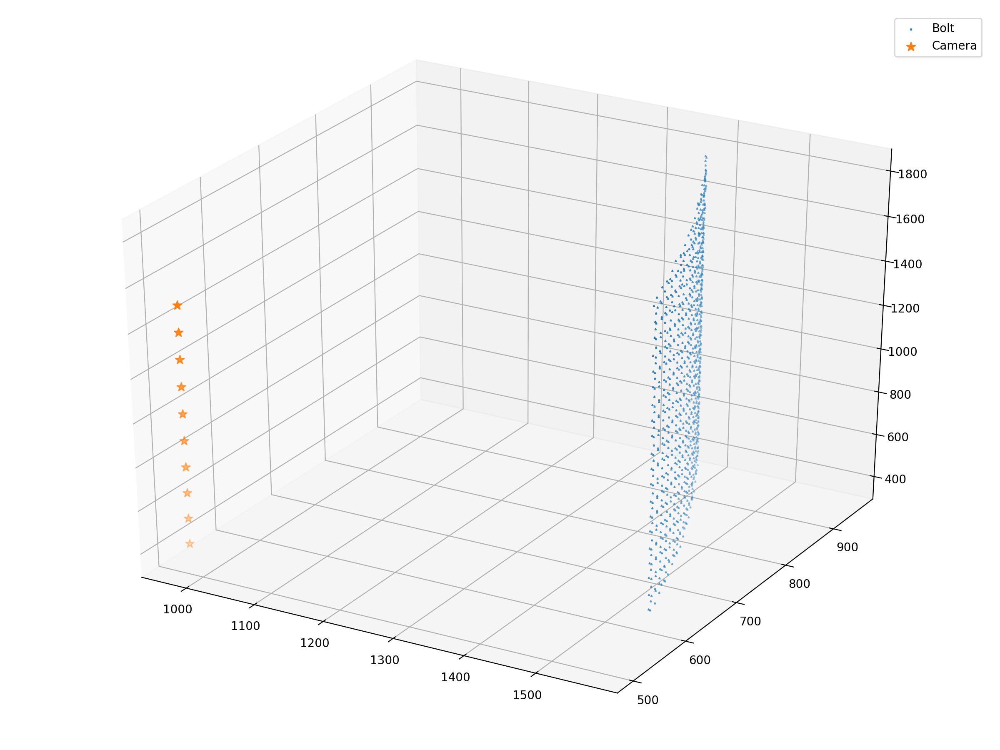

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 96, 1: 30})
image 0 reprojection errors:    average: 5.7936326172450485    max: 17.700114605248828
image 1 reprojection errors:    average: 5.885261214098381    max: 16.820164417892748
image 2 reprojection errors:    average: 6.160632109454188    max: 19.143188714963056
image 3 reprojection errors:    average: 5.920211275215323    max: 17.005990654710878
image 4 reprojection errors:    average: 6.224210282913809    max: 16.487939977931934
image 5 reprojection errors:    average: 6.057603458994341    max: 19.305731618379546
image 6 reprojection errors:    average: 6.099681542042157    max: 19.84011989960677
image 7 reprojection errors:    average: 6.0695249643588545    max: 17.6489620517029
image 8 reprojection errors:    average: 6.465759197220468    max: 19.081642736893848
image 9 reprojection errors:    average: 6.05012801623722    max: 19.0613445166237

<IPython.core.display.Javascript object>


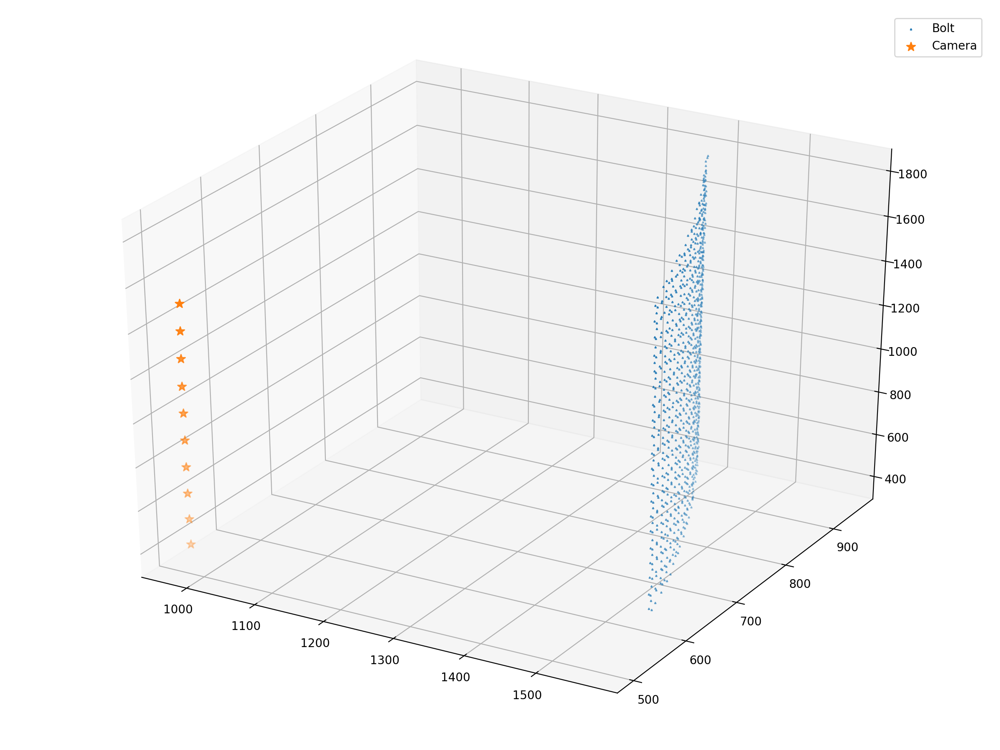

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 95, 1: 31})
image 0 reprojection errors:    average: 5.966716569754255    max: 18.045399445892862
image 1 reprojection errors:    average: 6.2851262167206405    max: 17.006814937685558
image 2 reprojection errors:    average: 6.37709129381062    max: 19.321876644538666
image 3 reprojection errors:    average: 6.369648328833874    max: 19.118309048960107
image 4 reprojection errors:    average: 6.603227415034112    max: 17.86415682283379
image 5 reprojection errors:    average: 6.618995299862931    max: 19.142588652673275
image 6 reprojection errors:    average: 7.0908868584910625    max: 20.537286894299157
image 7 reprojection errors:    average: 7.102618632820488    max: 19.91441057946542
image 8 reprojection errors:    average: 6.313261657088241    max: 18.30793387357983
image 9 reprojection errors:    average: 6.293259228789646    max: 17.5482531309096

<IPython.core.display.Javascript object>


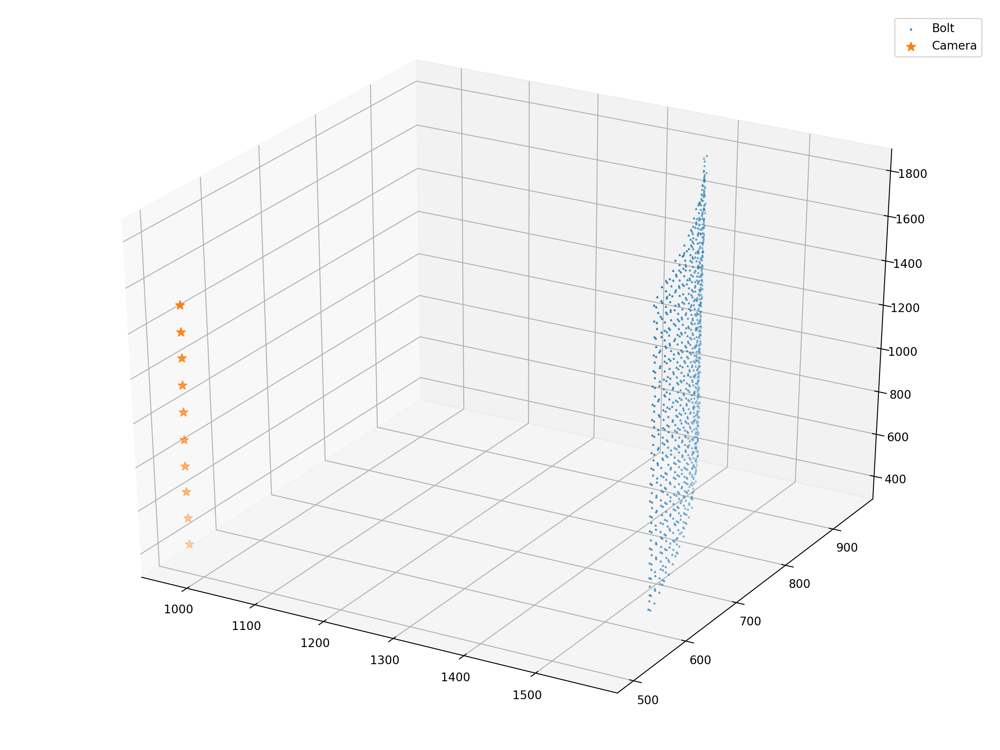

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 296, 6: 238, 3: 150, 4: 150, 2: 94, 1: 32})
image 0 reprojection errors:    average: 6.631103840080892    max: 19.4708832519473
image 1 reprojection errors:    average: 7.018036354670009    max: 21.3676217049945
image 2 reprojection errors:    average: 6.977442739884547    max: 22.292972724337613
image 3 reprojection errors:    average: 7.148745704765715    max: 20.25803243378019
image 4 reprojection errors:    average: 6.692655518788005    max: 20.71106833651334
image 5 reprojection errors:    average: 6.633453118969518    max: 19.69829716589016
image 6 reprojection errors:    average: 6.473686350367135    max: 18.66448760495894
image 7 reprojection errors:    average: 6.8194595250882495    max: 17.895486379767068
image 8 reprojection errors:    average: 7.064427119346737    max: 18.45133228905544
image 9 reprojection errors:    average: 6.799160209504666    max: 18.008178620233707
   

<IPython.core.display.Javascript object>


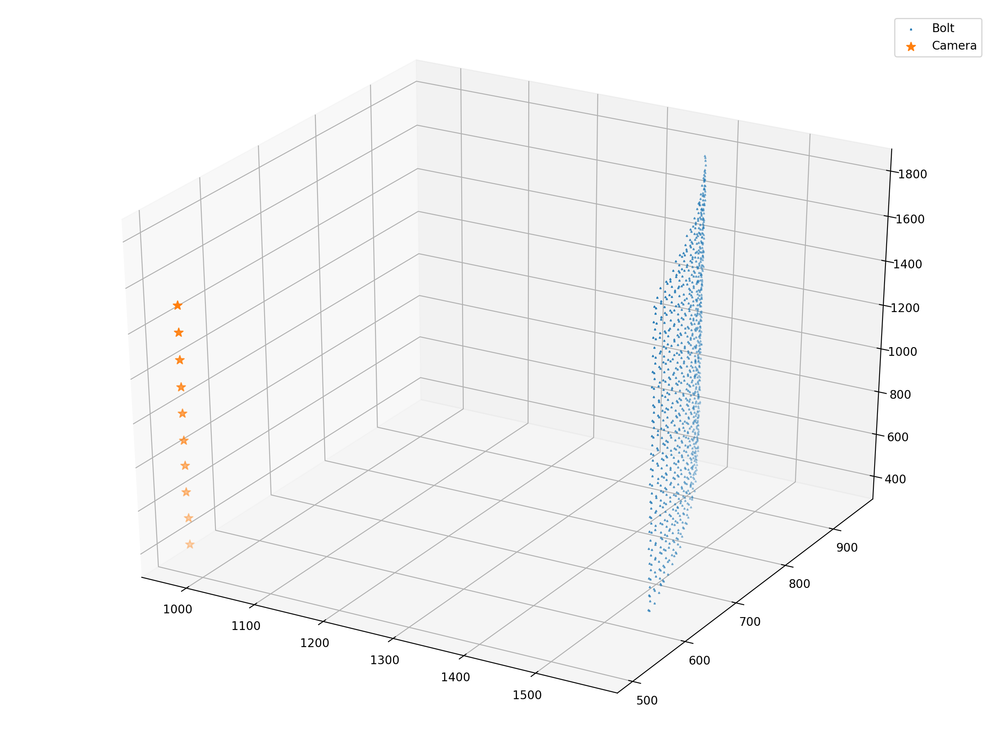

=== Gaussian errors on feature image locations: 5.0 ===
Smeared feature in image counts: Counter({5: 295, 6: 239, 3: 150, 4: 150, 2: 91, 1: 35})
image 0 reprojection errors:    average: 8.167379302200105    max: 22.02015571282935
image 1 reprojection errors:    average: 8.043897642792851    max: 22.056460486817514
image 2 reprojection errors:    average: 7.54985923826996    max: 20.614055213232472
image 3 reprojection errors:    average: 7.422641611650351    max: 24.3477354551851
image 4 reprojection errors:    average: 8.131563549694961    max: 21.470738412575038
image 5 reprojection errors:    average: 8.259983552101057    max: 26.290278182063687
image 6 reprojection errors:    average: 8.004814562213692    max: 21.84105435763764
image 7 reprojection errors:    average: 7.873887614580089    max: 19.95770003223913
image 8 reprojection errors:    average: 7.977498242123372    max: 22.809748315679453
image 9 reprojection errors:    average: 7.996081255856619    max: 21.842008672122272
 

<IPython.core.display.Javascript object>


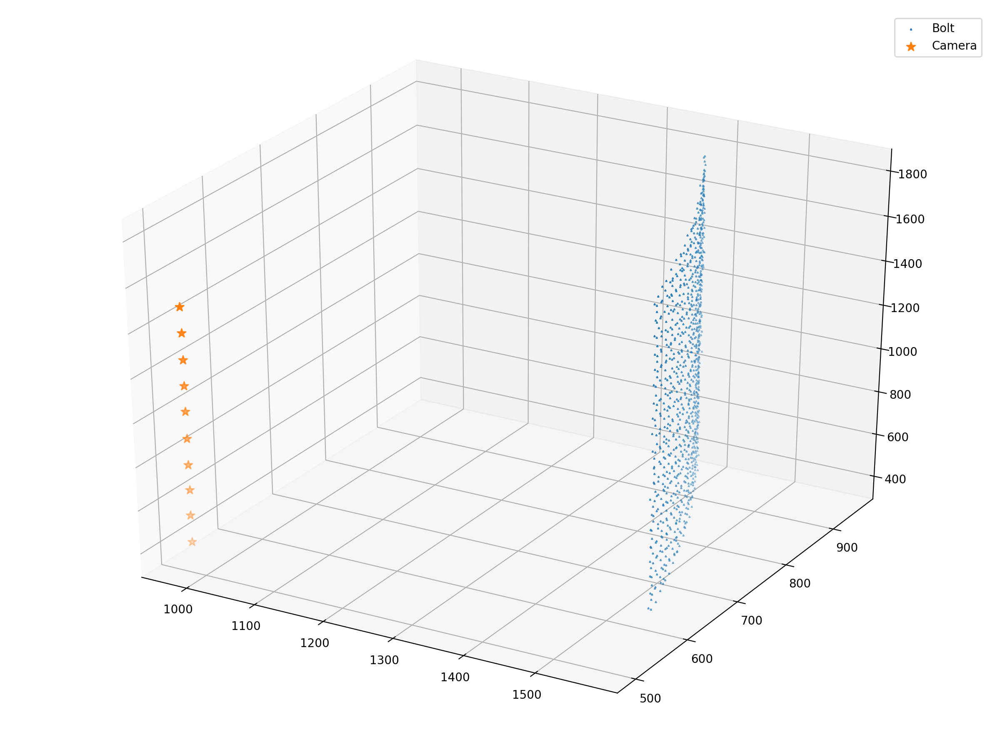

In [33]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring~ orientation error with {} bolts/PMT".format(bolt_count), "Ang le between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0, 5.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=30, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 6 bolts

Feature in image counts: Counter({5: 206, 6: 196, 4: 126, 3: 102, 2: 60, 1: 30})


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


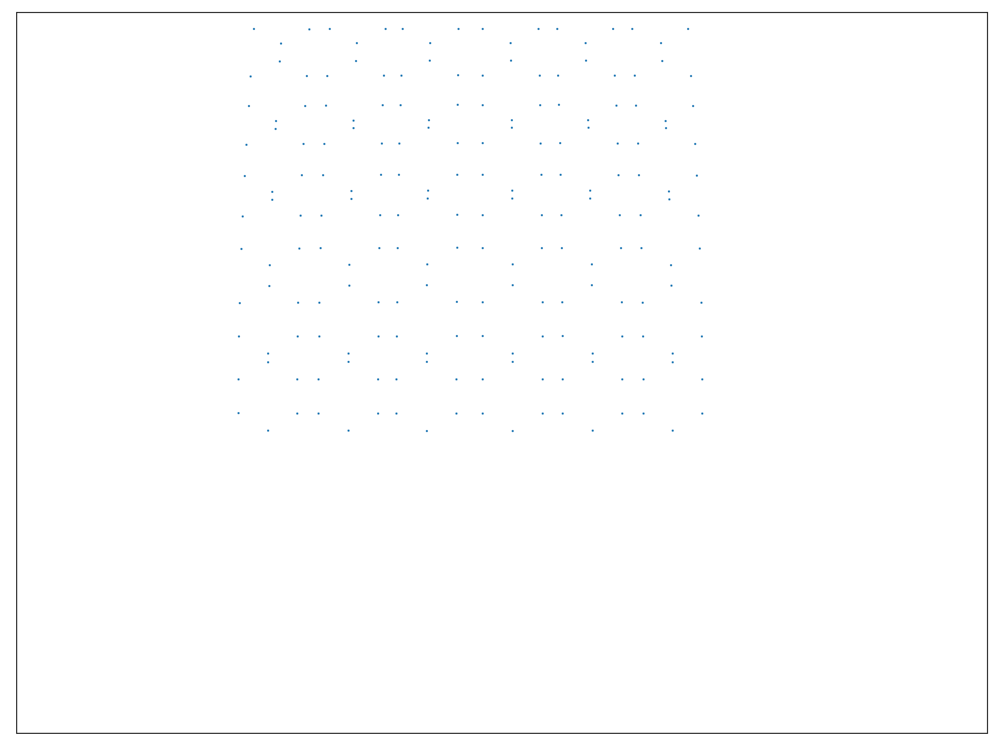

<IPython.core.display.Javascript object>


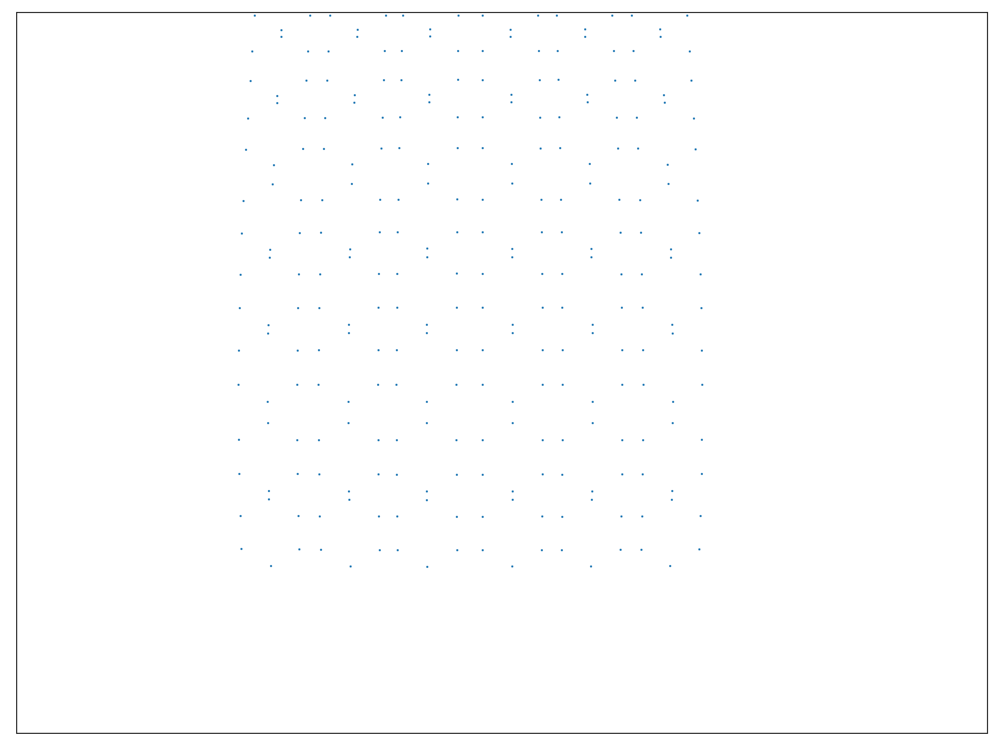

<IPython.core.display.Javascript object>


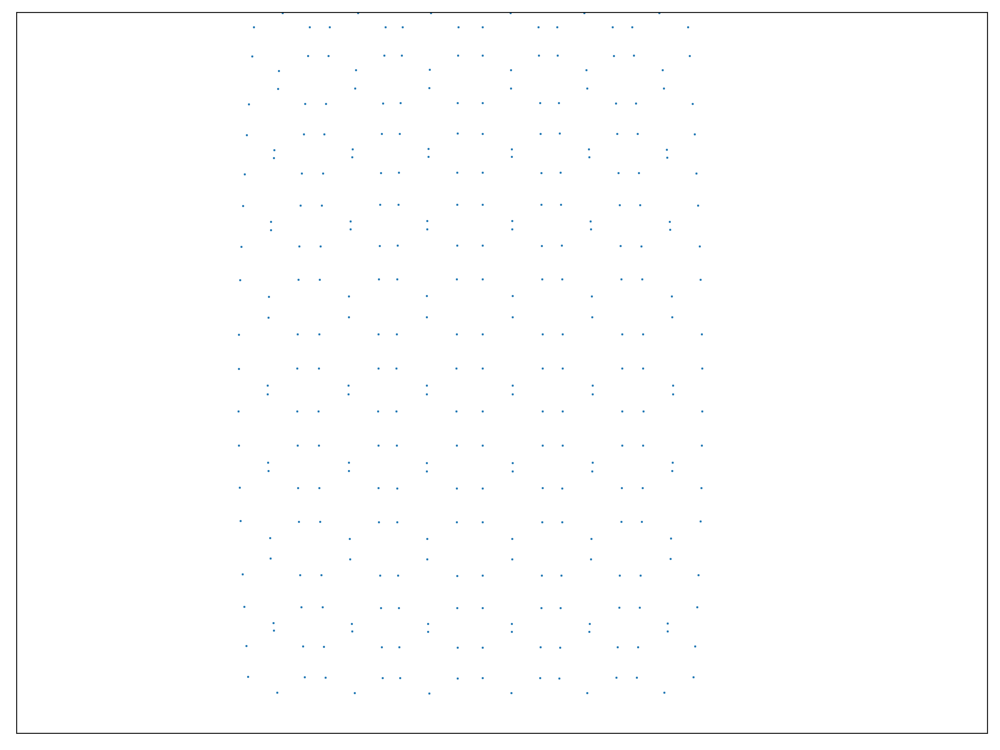

<IPython.core.display.Javascript object>


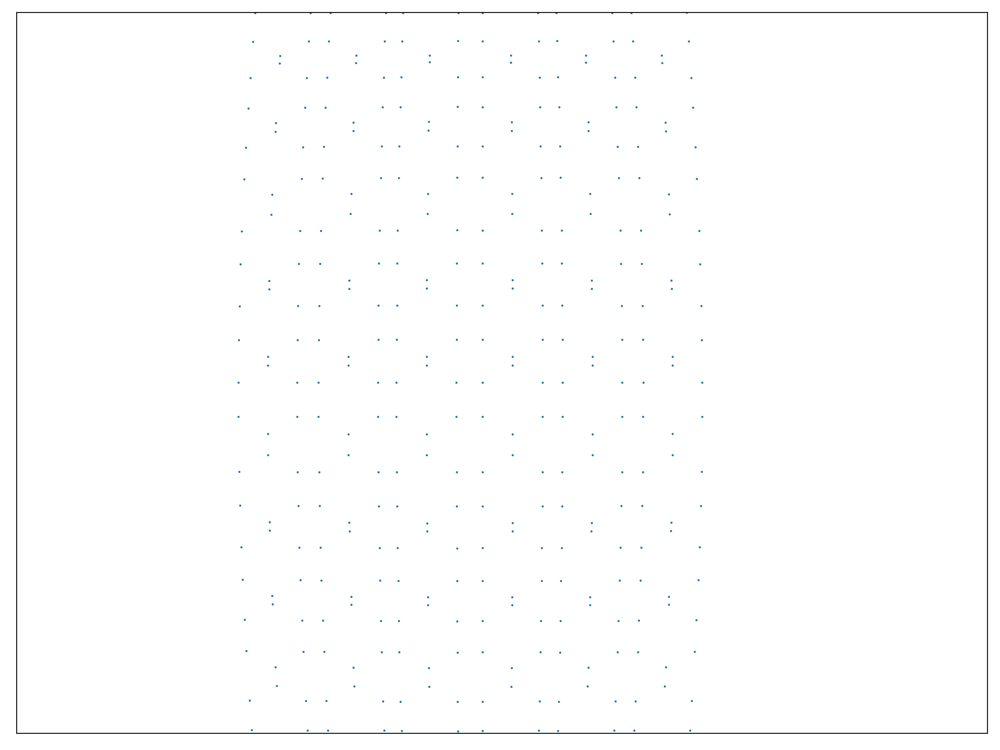

<IPython.core.display.Javascript object>


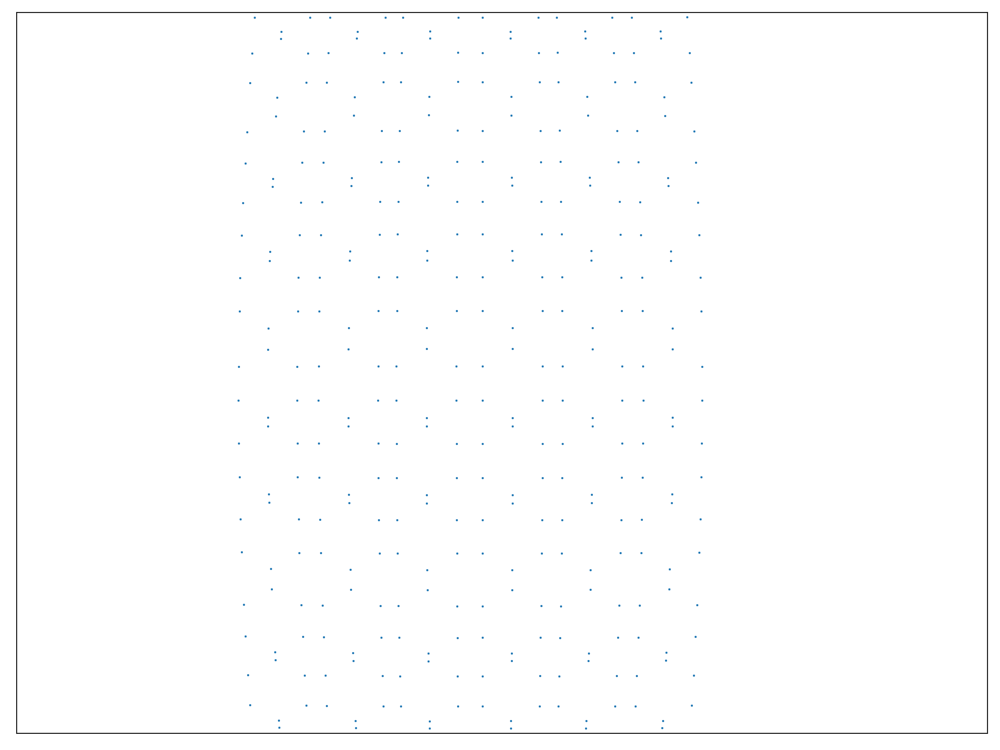

<IPython.core.display.Javascript object>


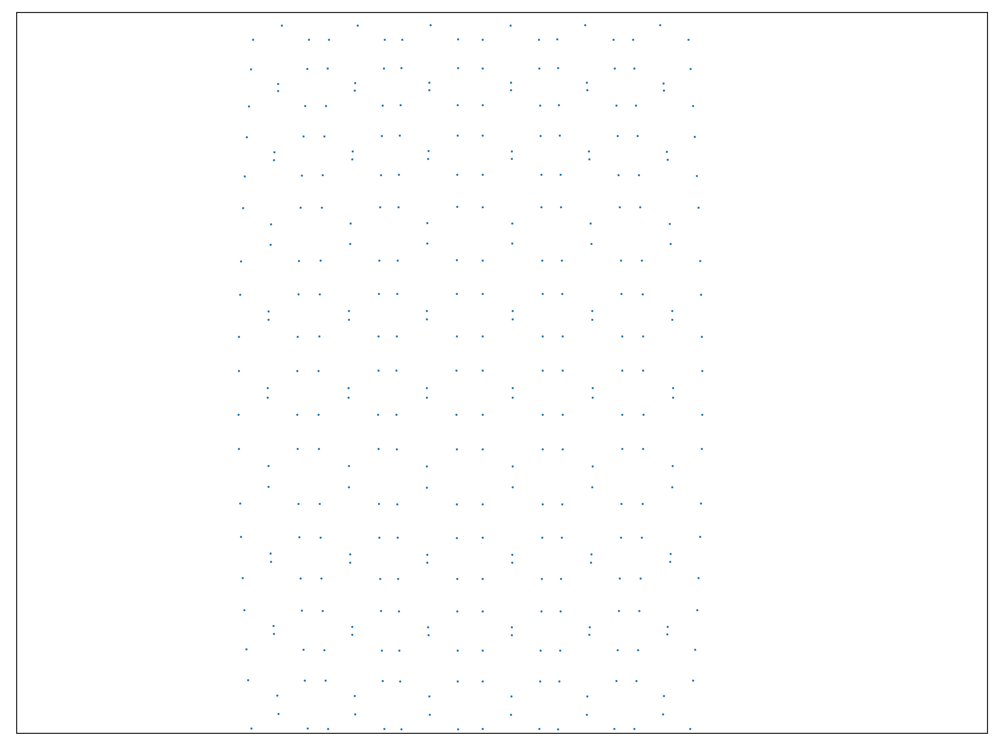

<IPython.core.display.Javascript object>


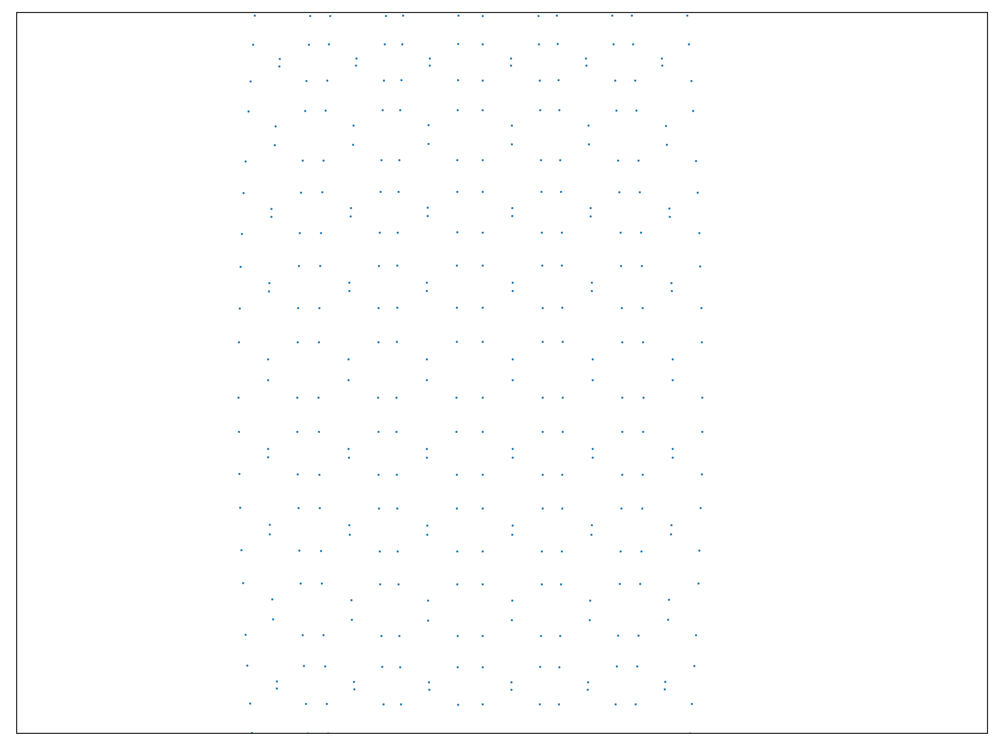

<IPython.core.display.Javascript object>


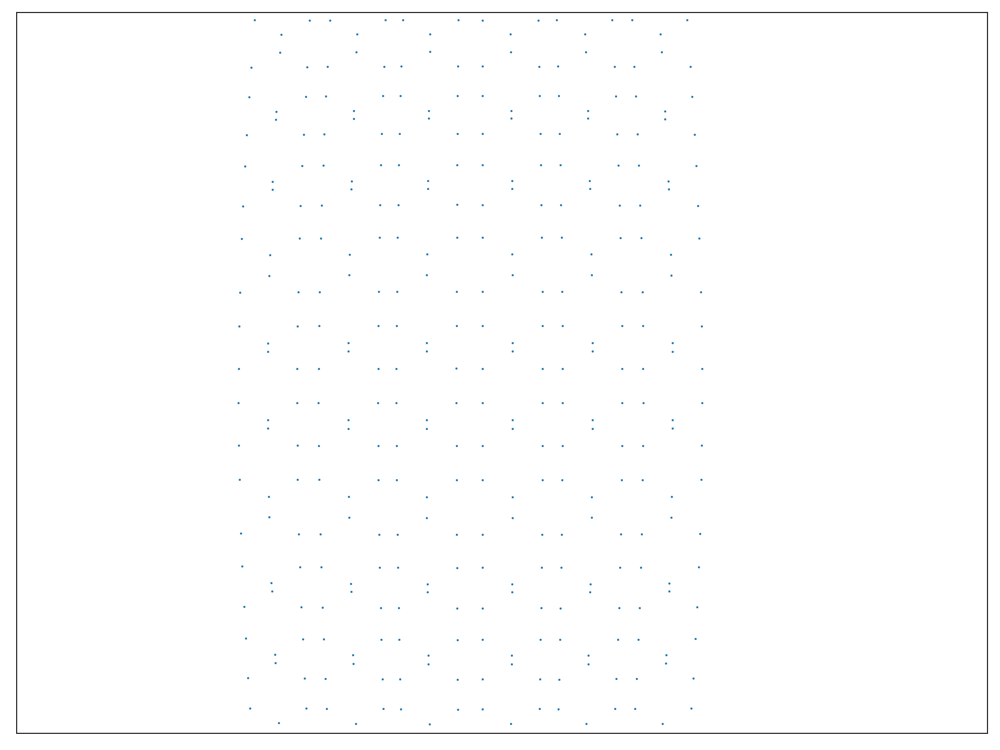

<IPython.core.display.Javascript object>


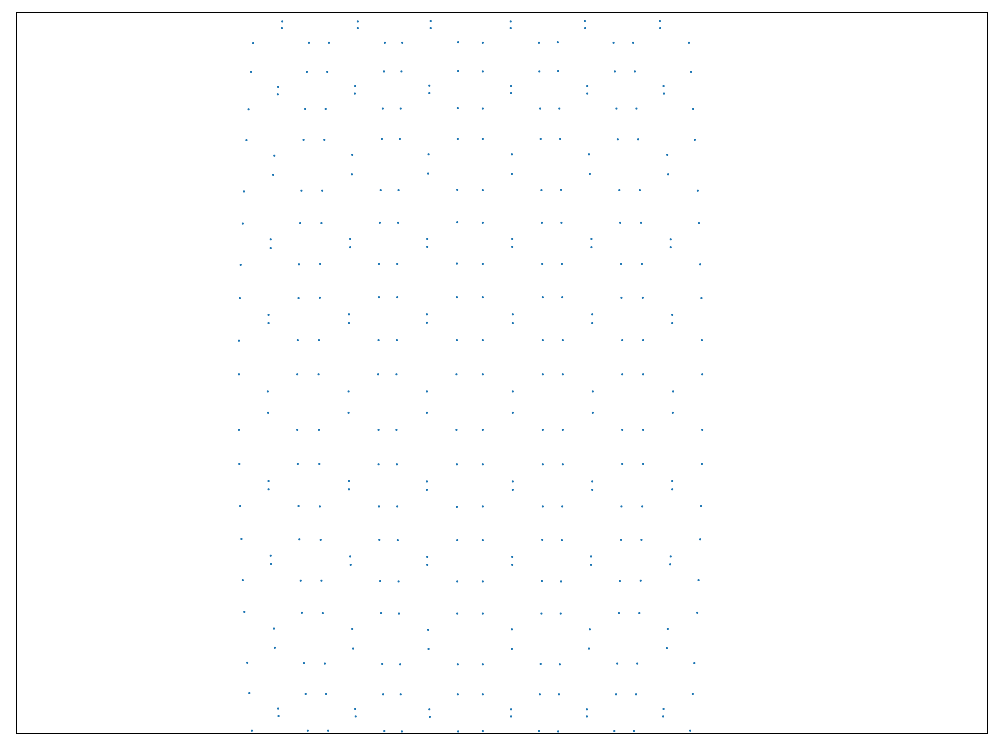

<IPython.core.display.Javascript object>


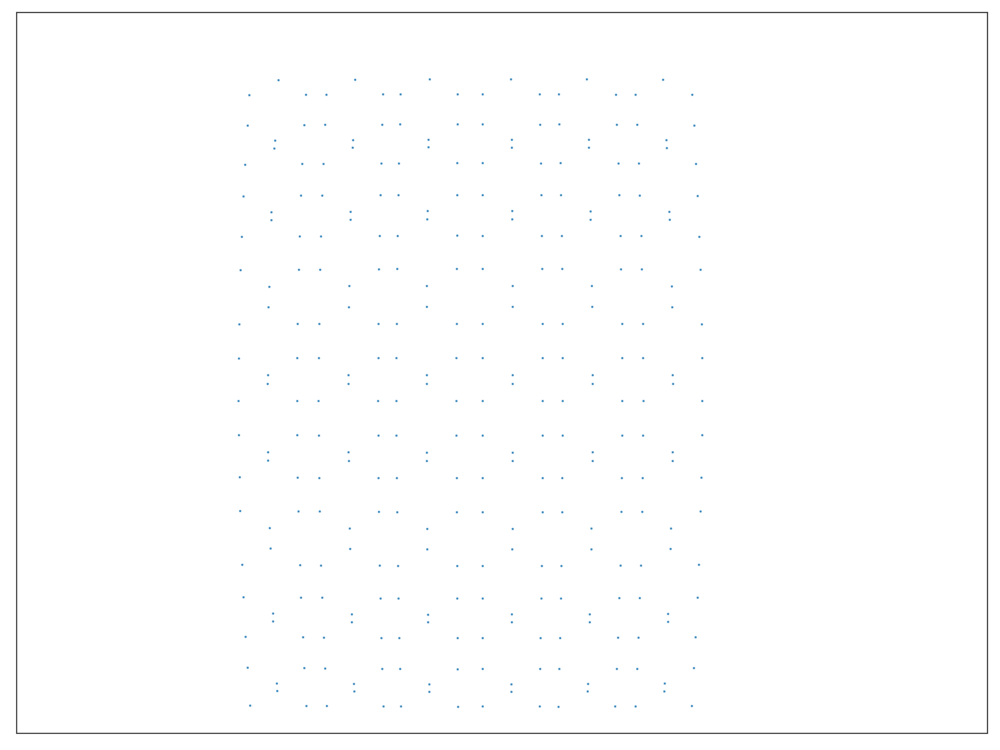

In [25]:
bolt_count = 6
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


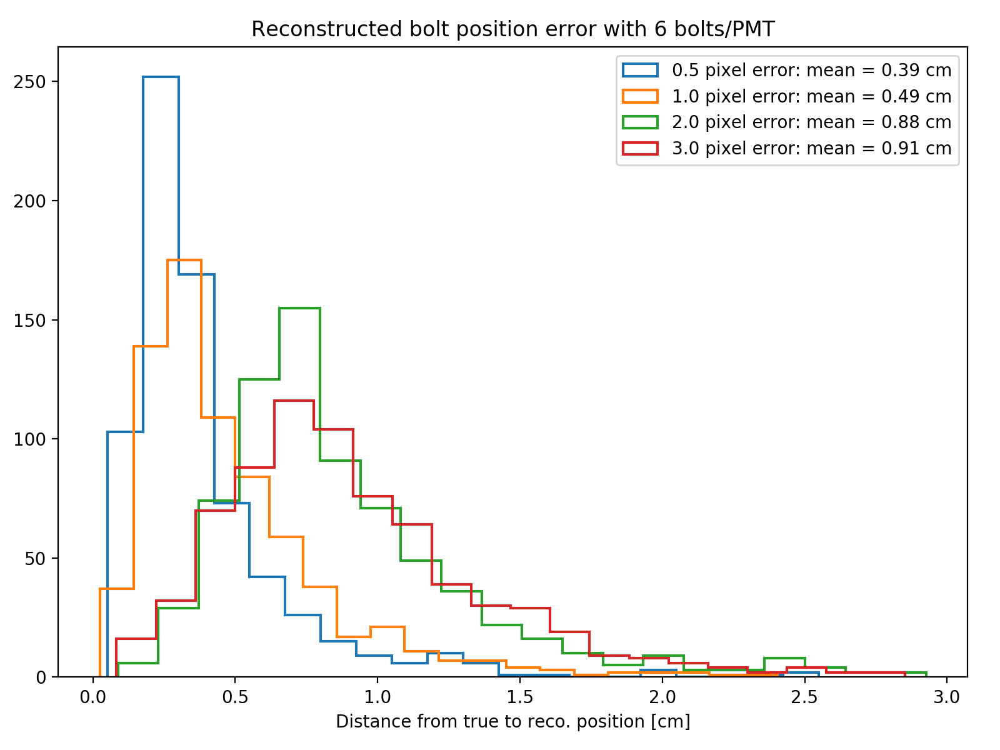

<IPython.core.display.Javascript object>


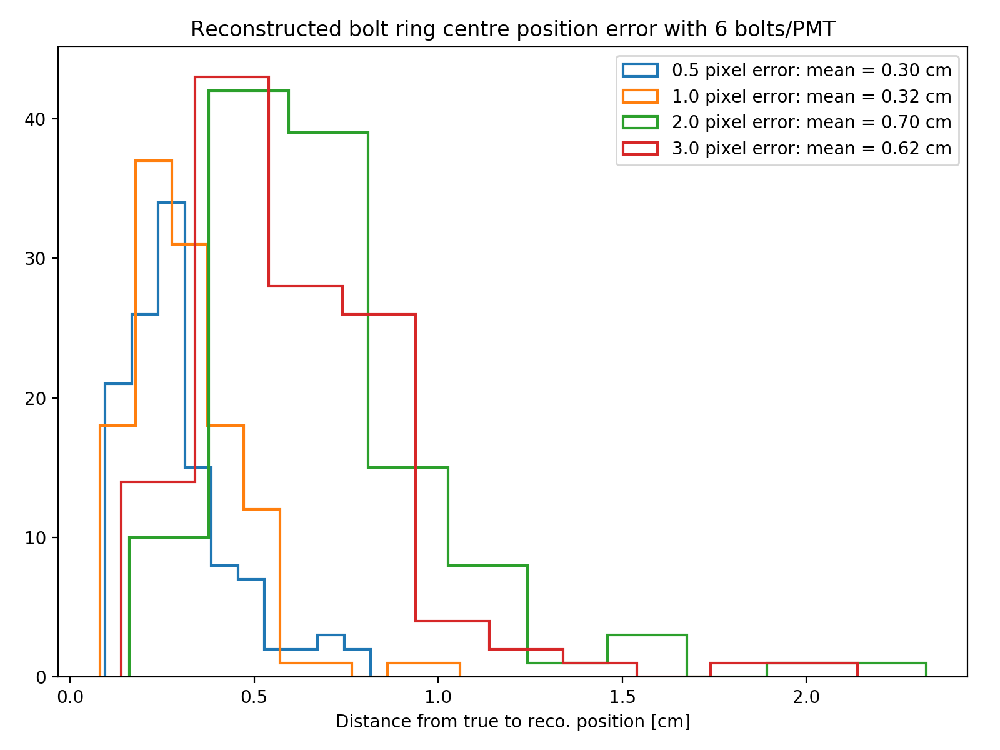

<IPython.core.display.Javascript object>


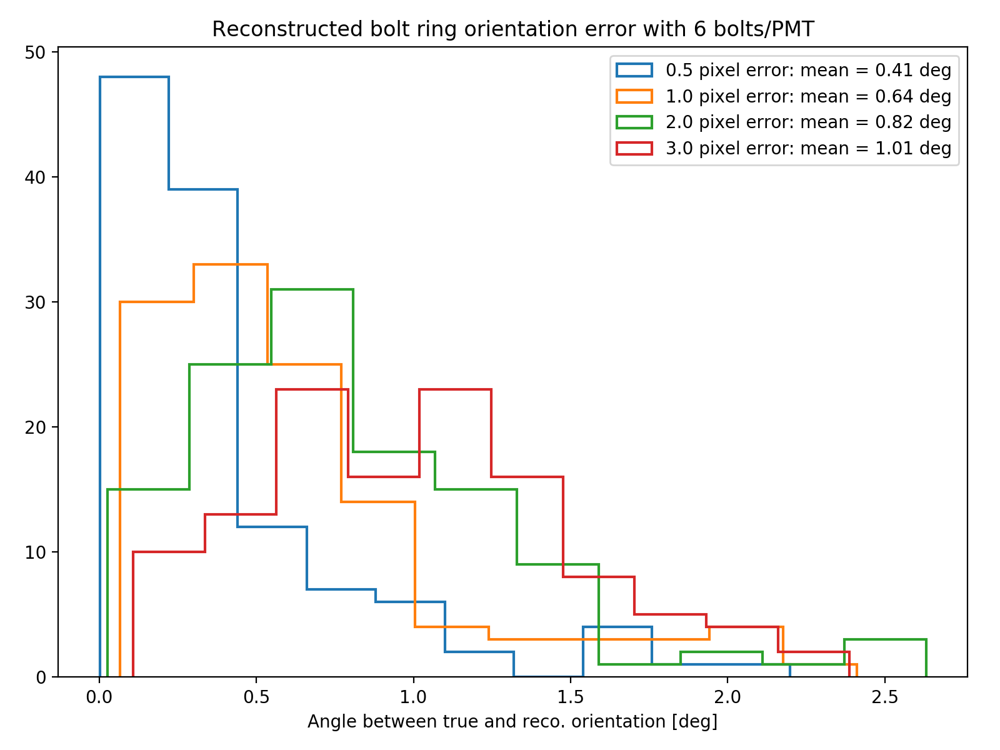

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 206, 6: 196, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 6.128230782283478    max: 15.742866408655738
image 1 reprojection errors:    average: 6.150835526576982    max: 15.936665194829619
image 2 reprojection errors:    average: 6.325874114323471    max: 16.261558463134048
image 3 reprojection errors:    average: 6.211315311917563    max: 15.761483519687584
image 4 reprojection errors:    average: 7.785630220255737    max: 19.59629837826617
image 5 reprojection errors:    average: 6.43690396019711    max: 17.528700606713713
image 6 reprojection errors:    average: 6.0067153626644085    max: 16.942821594827073
image 7 reprojection errors:    average: 6.0604772913120675    max: 17.34176527263977
image 8 reprojection errors:    average: 6.394952459022241    max: 17.908081108213295
image 9 reprojection errors:    average: 6.001881572145022    max: 16.729629618781

<IPython.core.display.Javascript object>


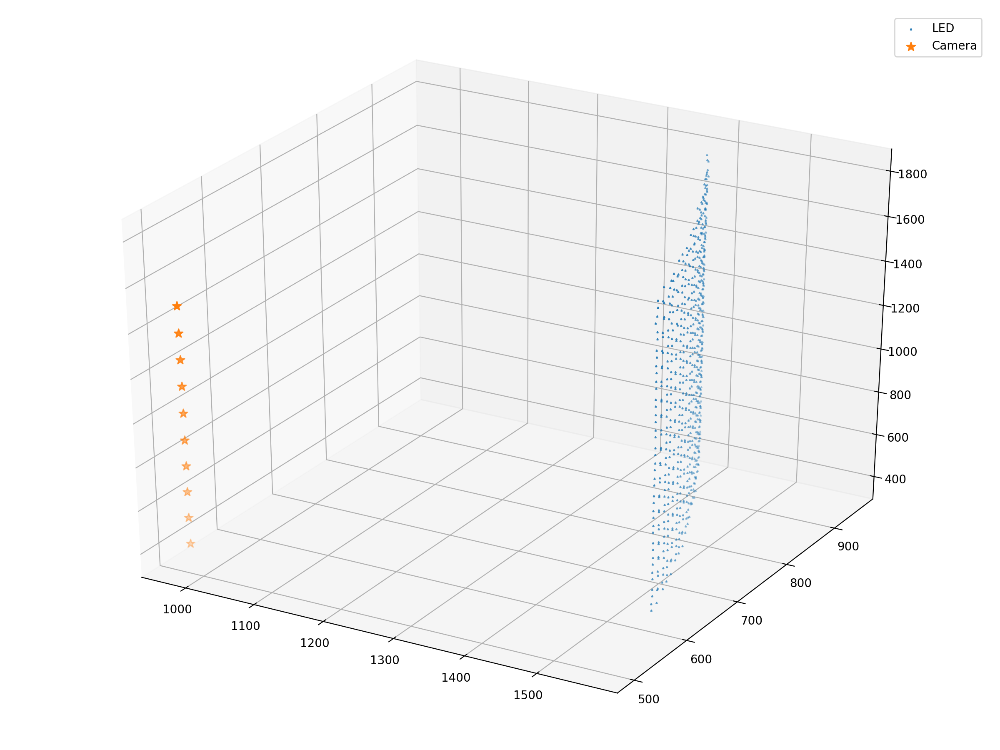

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 207, 6: 195, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 5.876345990097708    max: 17.04427363299988
image 1 reprojection errors:    average: 6.030489354524656    max: 16.85480334444752
image 2 reprojection errors:    average: 6.157220602135234    max: 18.372123946931925
image 3 reprojection errors:    average: 6.201383531341998    max: 16.188978330023204
image 4 reprojection errors:    average: 6.084892908239478    max: 16.869333215068792
image 5 reprojection errors:    average: 6.343714180569355    max: 14.742801848767565
image 6 reprojection errors:    average: 6.353664779479696    max: 18.828943327515464
image 7 reprojection errors:    average: 6.206755793322859    max: 15.503067170404833
image 8 reprojection errors:    average: 6.165403139706876    max: 16.731056434757225
image 9 reprojection errors:    average: 6.181225135776602    max: 18.5742589105355

<IPython.core.display.Javascript object>


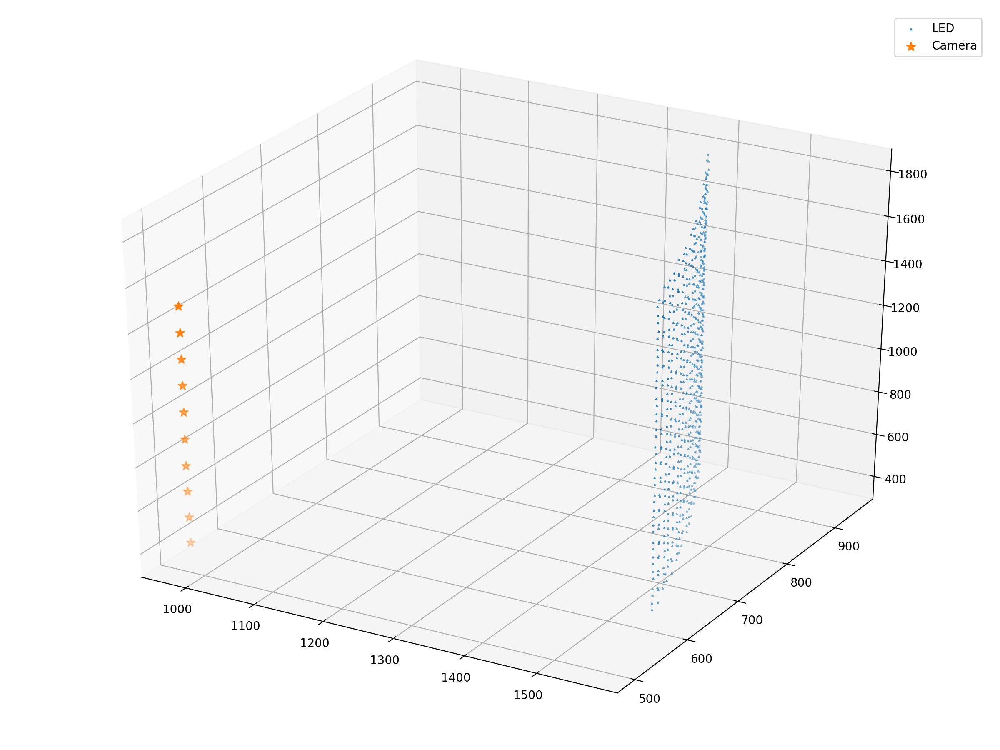

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 210, 6: 192, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 6.3391958650888025    max: 16.633020154742272
image 1 reprojection errors:    average: 6.232230226336127    max: 18.601840589878904
image 2 reprojection errors:    average: 6.442857287824213    max: 20.603340398993385
image 3 reprojection errors:    average: 6.54082886469978    max: 21.623341461800262
image 4 reprojection errors:    average: 7.068949950005761    max: 18.58537903149244
image 5 reprojection errors:    average: 6.491718993968134    max: 17.950337012336085
image 6 reprojection errors:    average: 6.376616549815078    max: 18.119048699601493
image 7 reprojection errors:    average: 6.70316172170731    max: 17.438143111359775
image 8 reprojection errors:    average: 7.016071965748078    max: 20.390726326729933
image 9 reprojection errors:    average: 6.529344520570758    max: 23.0031921997703

<IPython.core.display.Javascript object>


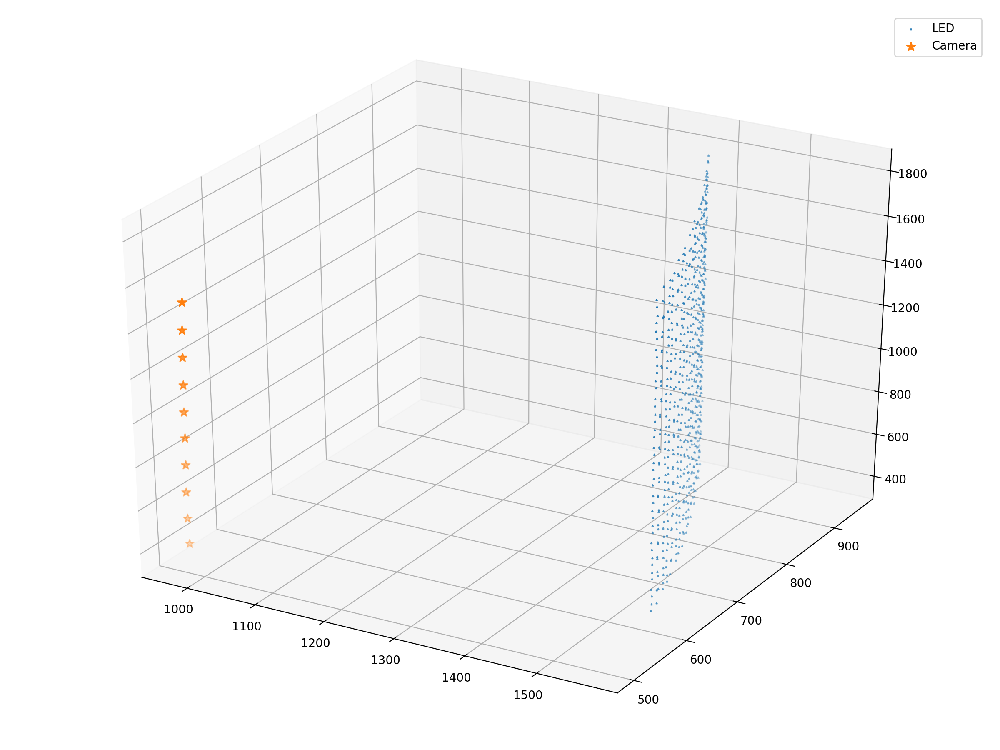

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 212, 6: 190, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 6.742034098065602    max: 17.637253676447223
image 1 reprojection errors:    average: 6.507151204781045    max: 18.137073245623498
image 2 reprojection errors:    average: 6.5923385877368625    max: 17.552107759484493
image 3 reprojection errors:    average: 7.541025292772852    max: 20.774778442609378
image 4 reprojection errors:    average: 7.018912836454089    max: 19.8359544442744
image 5 reprojection errors:    average: 6.35167561562993    max: 19.151789185949468
image 6 reprojection errors:    average: 7.95126433843301    max: 20.59219304121371
image 7 reprojection errors:    average: 7.082923946899959    max: 25.495151855217475
image 8 reprojection errors:    average: 7.537738143605673    max: 22.450614000722545
image 9 reprojection errors:    average: 7.169365016609896    max: 19.47659041304834


<IPython.core.display.Javascript object>


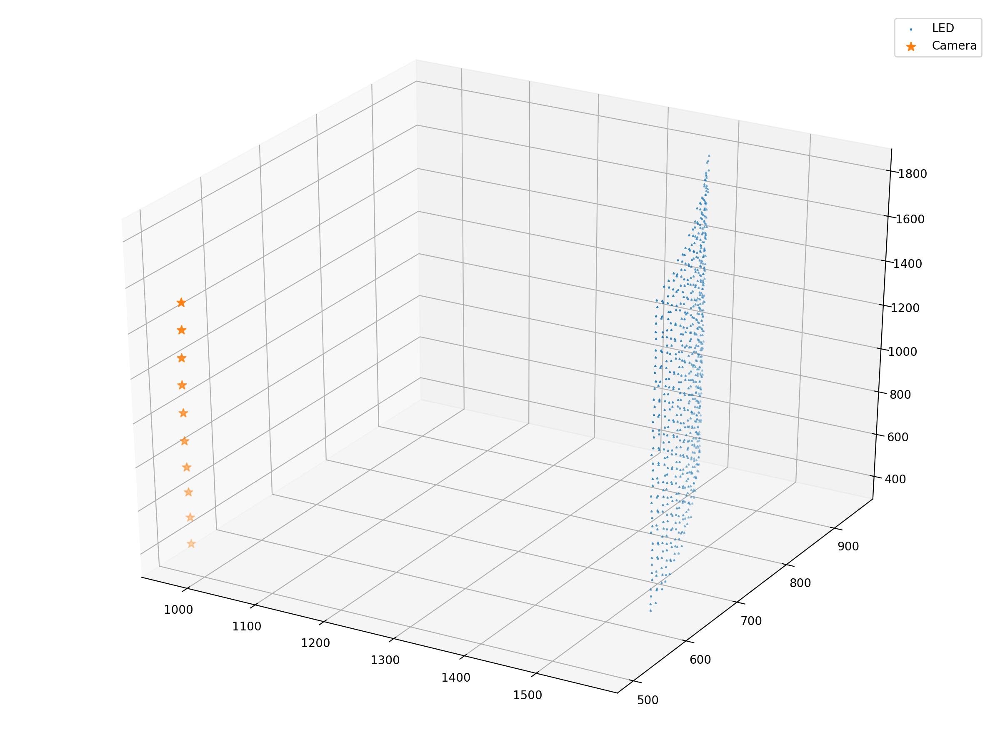

In [26]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=20, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 4 bolts

Feature in image counts: Counter({5: 150, 6: 120, 4: 78, 3: 66, 2: 48, 1: 18})


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


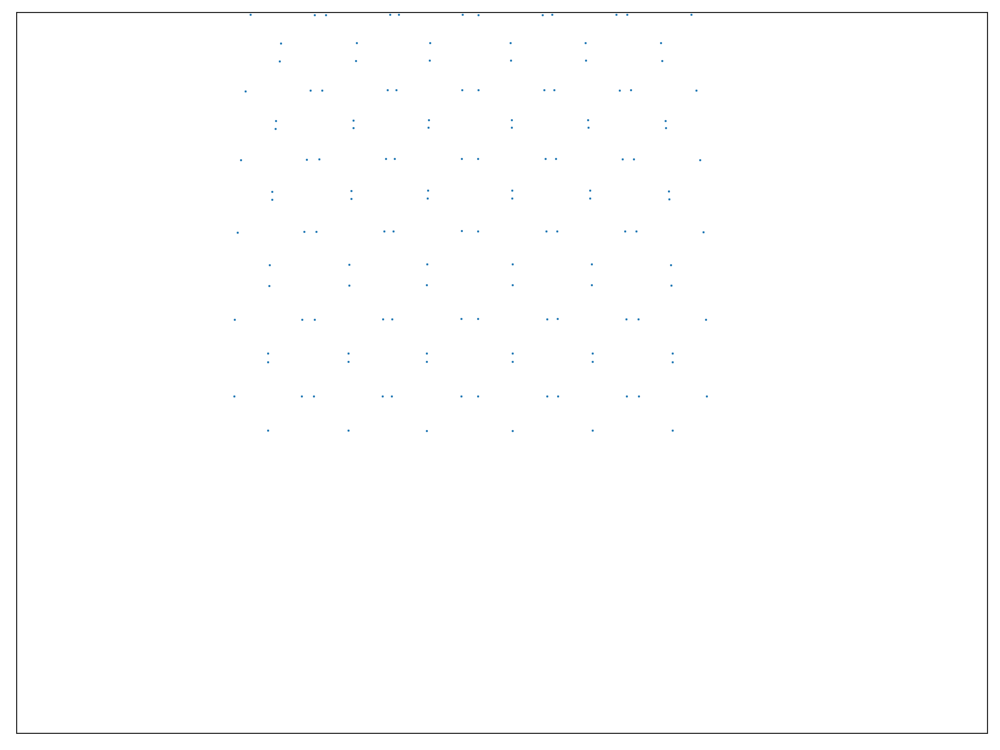

<IPython.core.display.Javascript object>


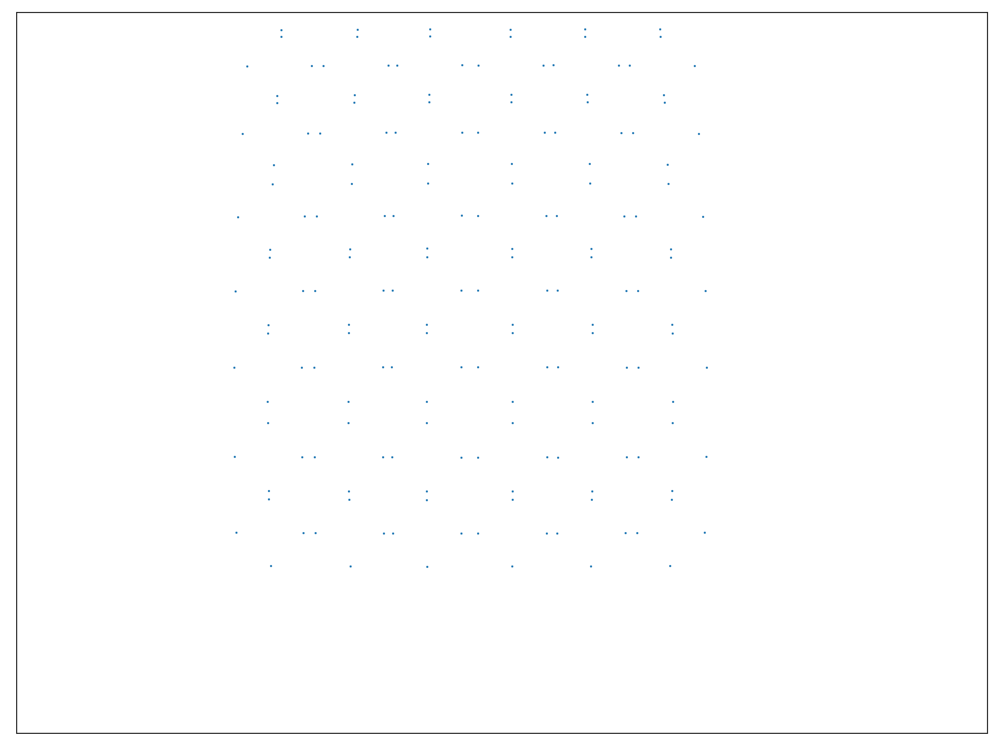

<IPython.core.display.Javascript object>


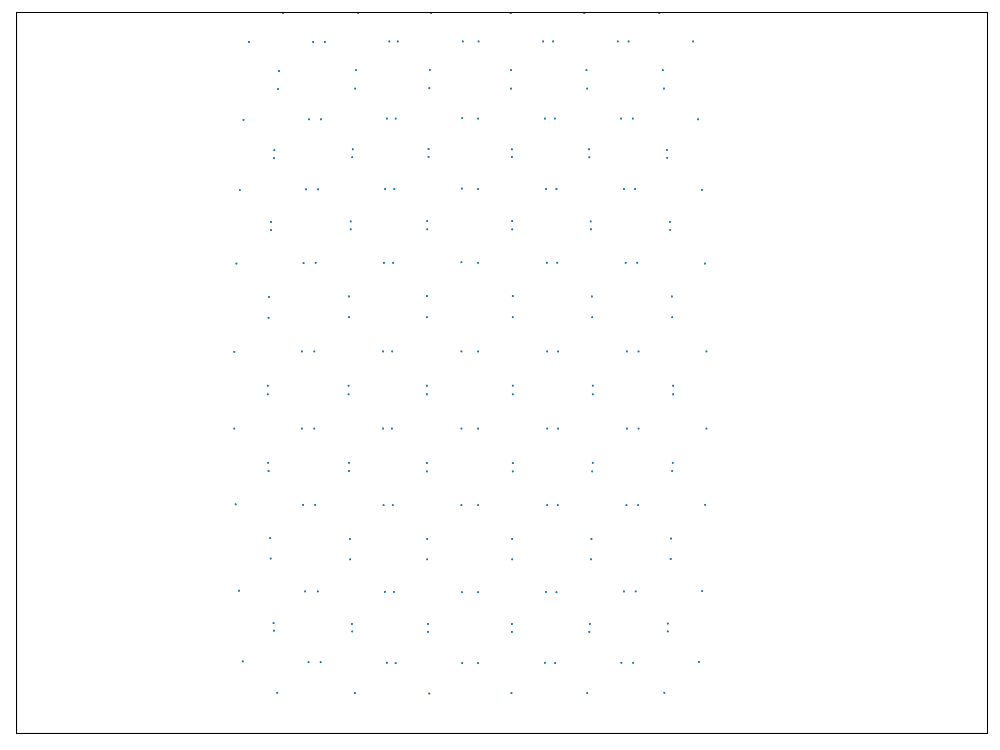

<IPython.core.display.Javascript object>


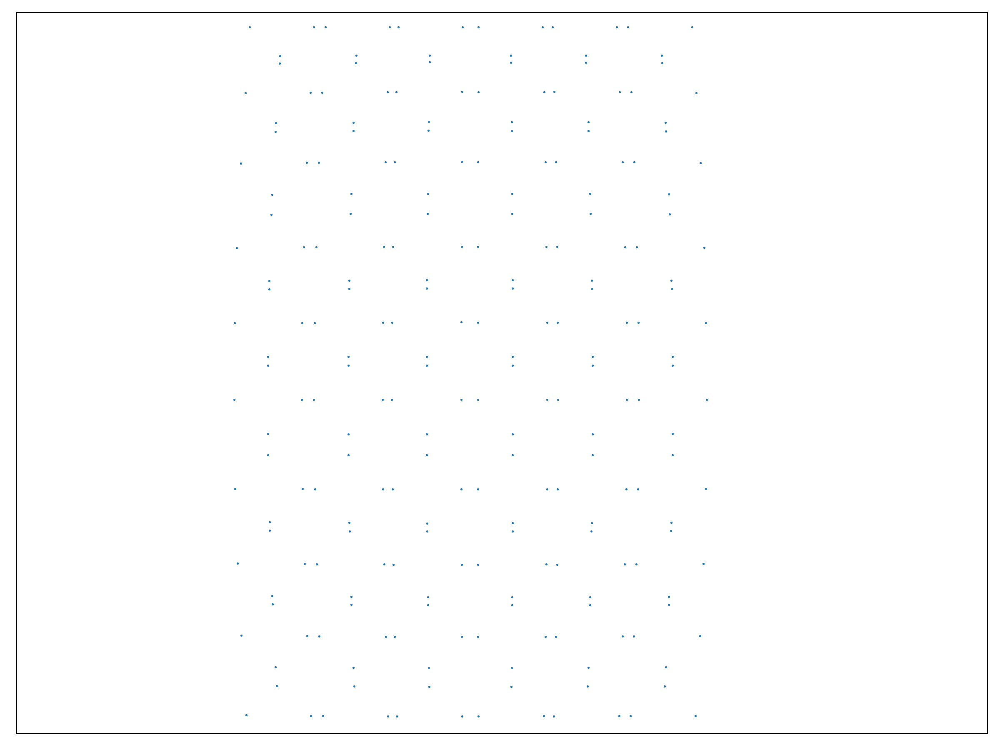

<IPython.core.display.Javascript object>


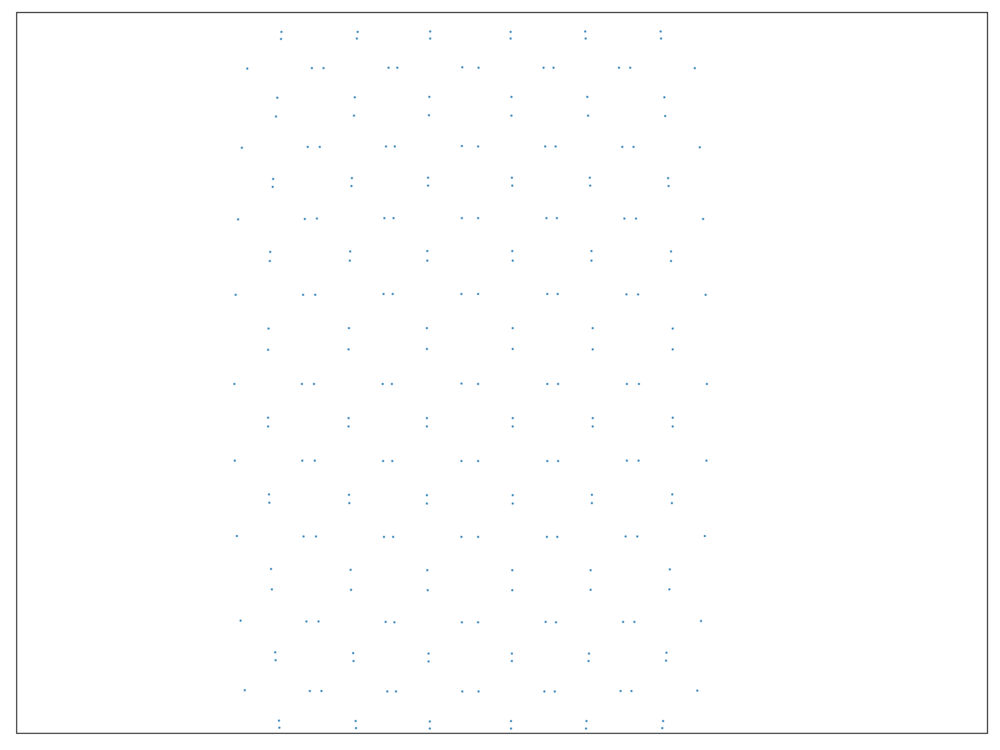

<IPython.core.display.Javascript object>


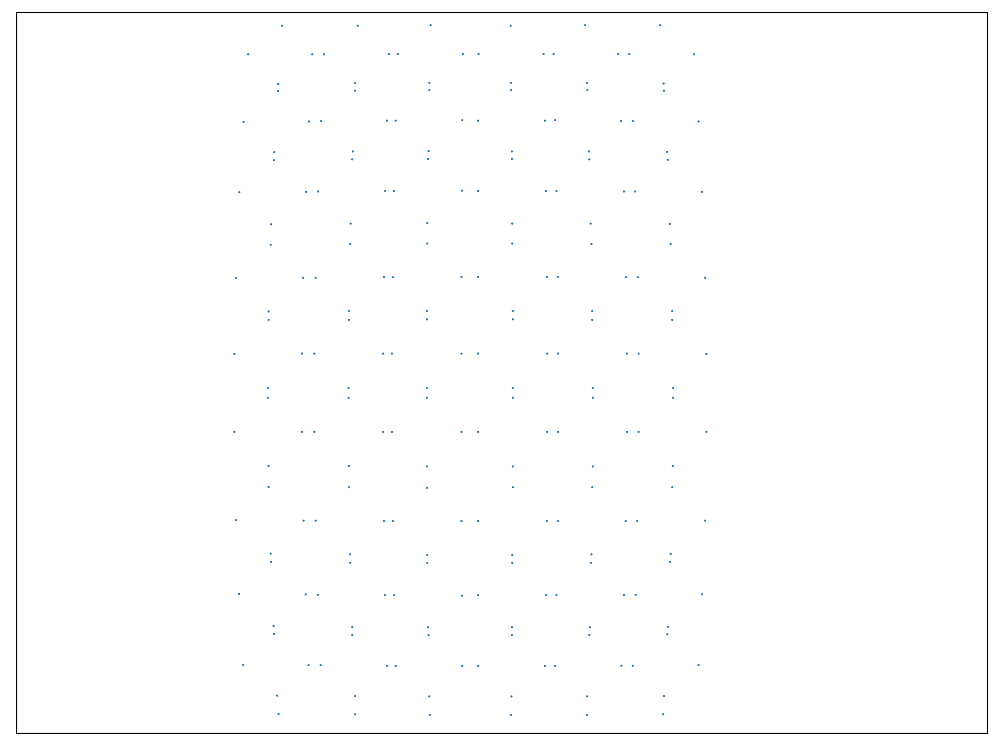

<IPython.core.display.Javascript object>


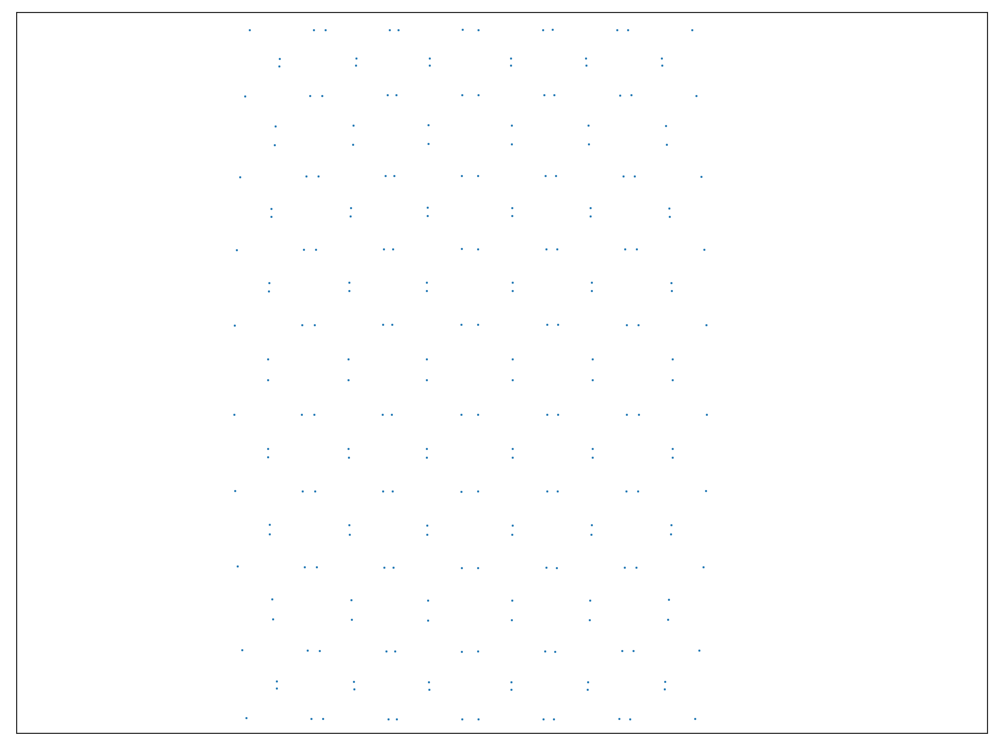

<IPython.core.display.Javascript object>


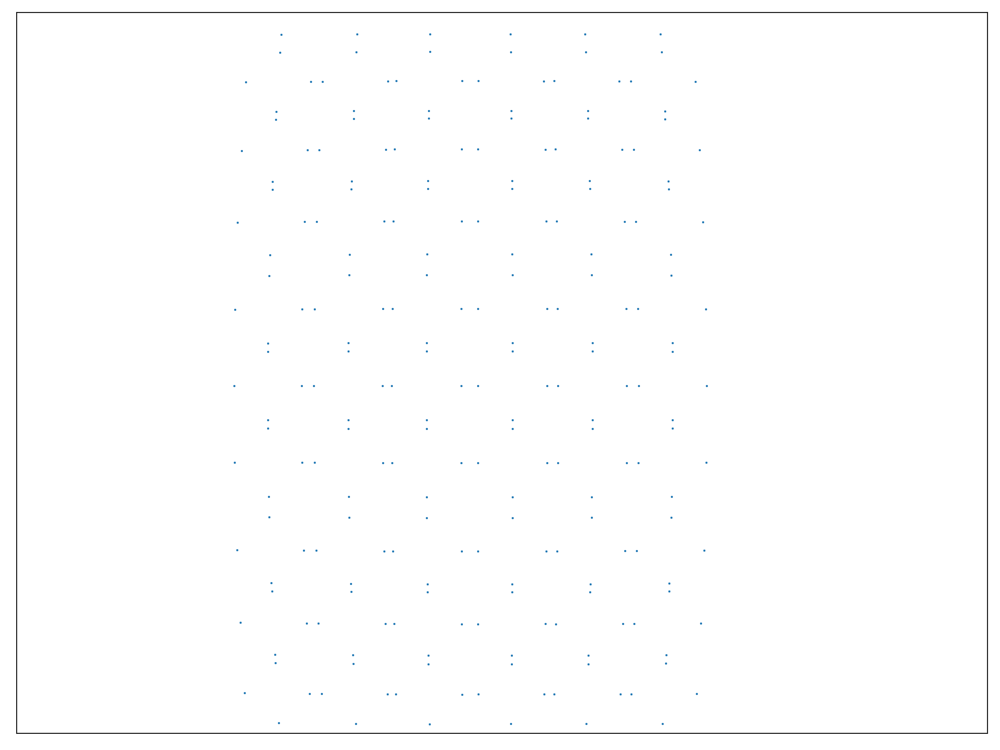

<IPython.core.display.Javascript object>


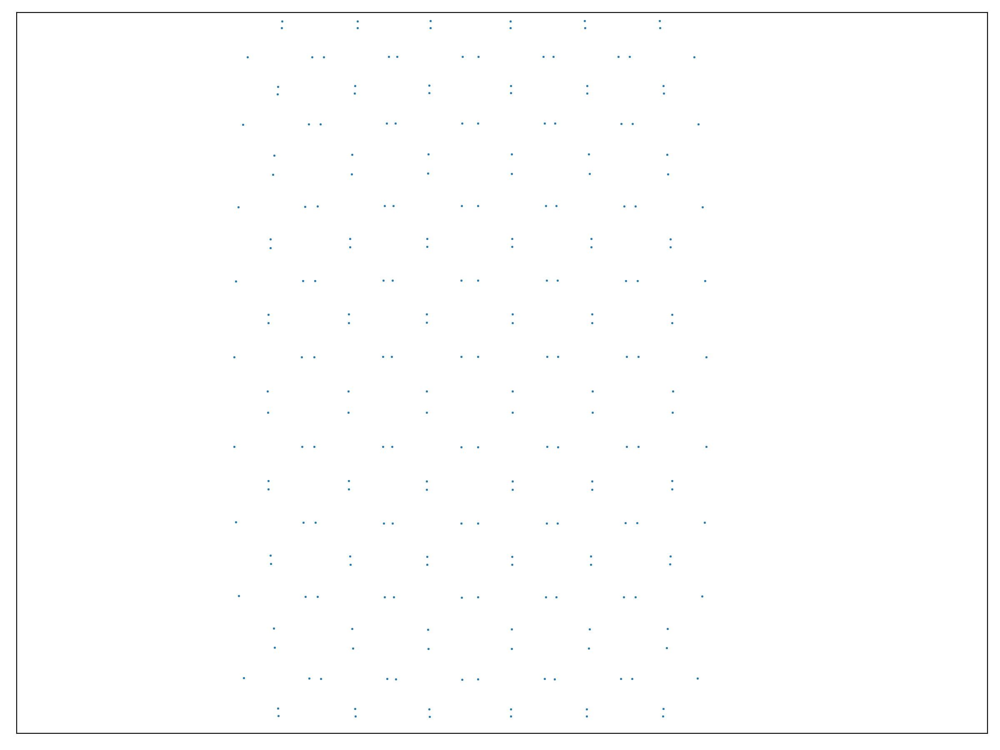

<IPython.core.display.Javascript object>


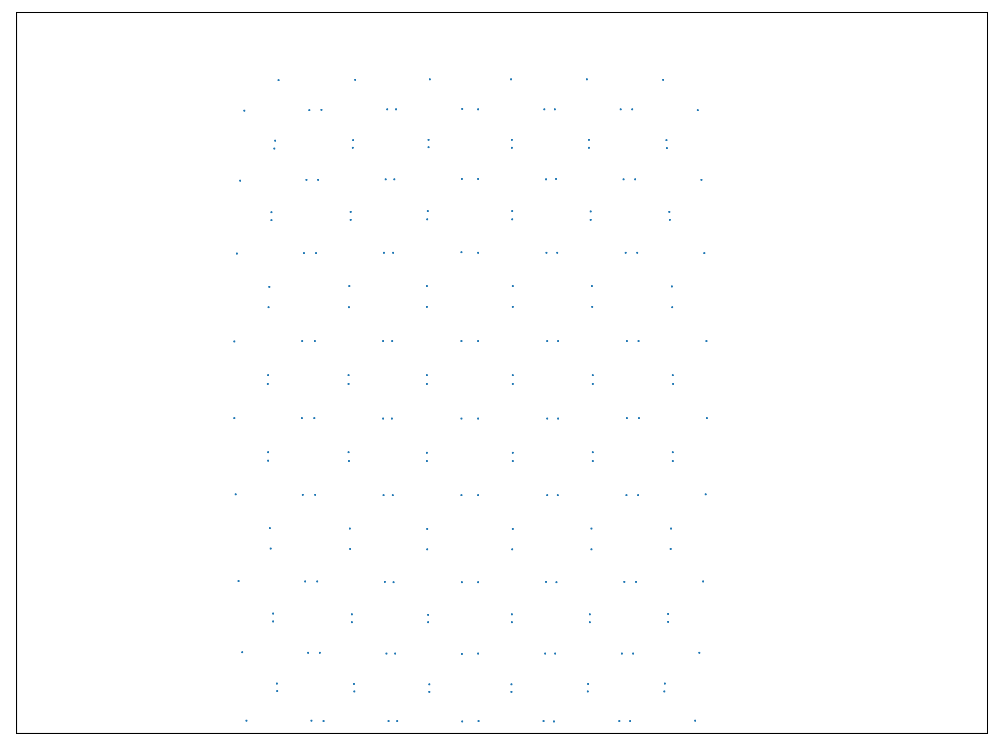

In [27]:
bolt_count = 4
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


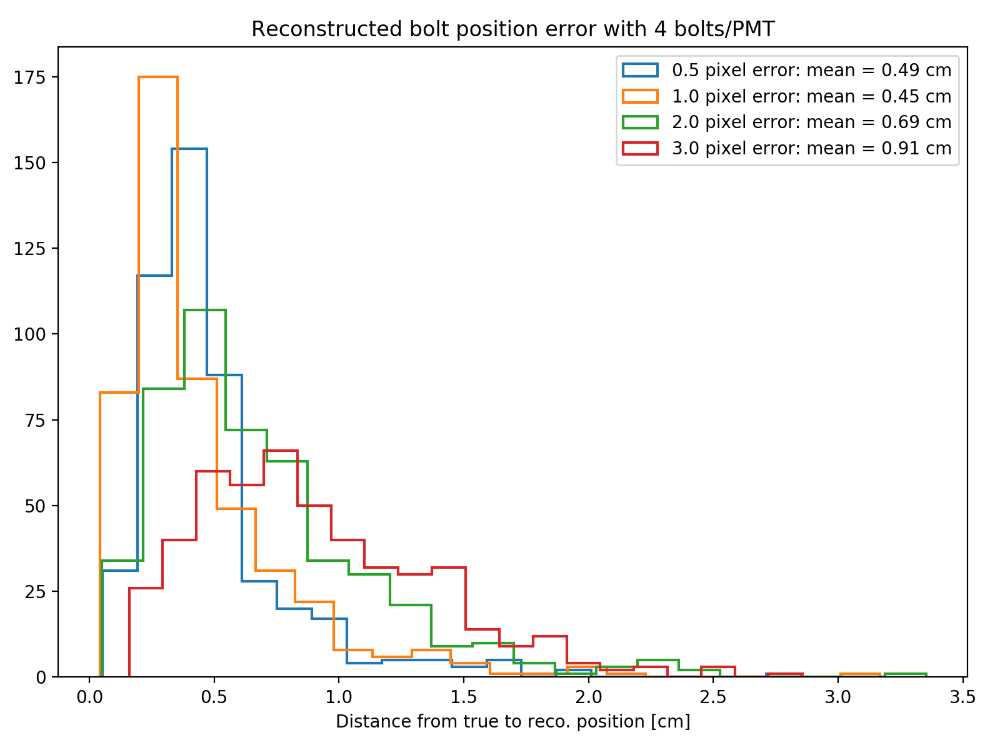

<IPython.core.display.Javascript object>


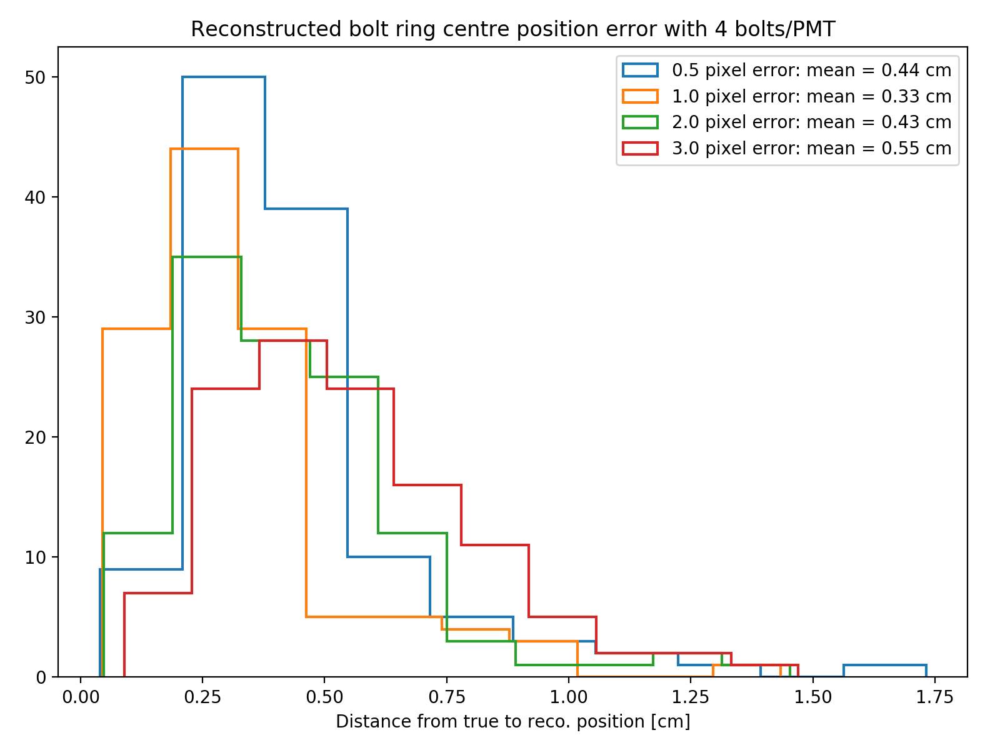

<IPython.core.display.Javascript object>


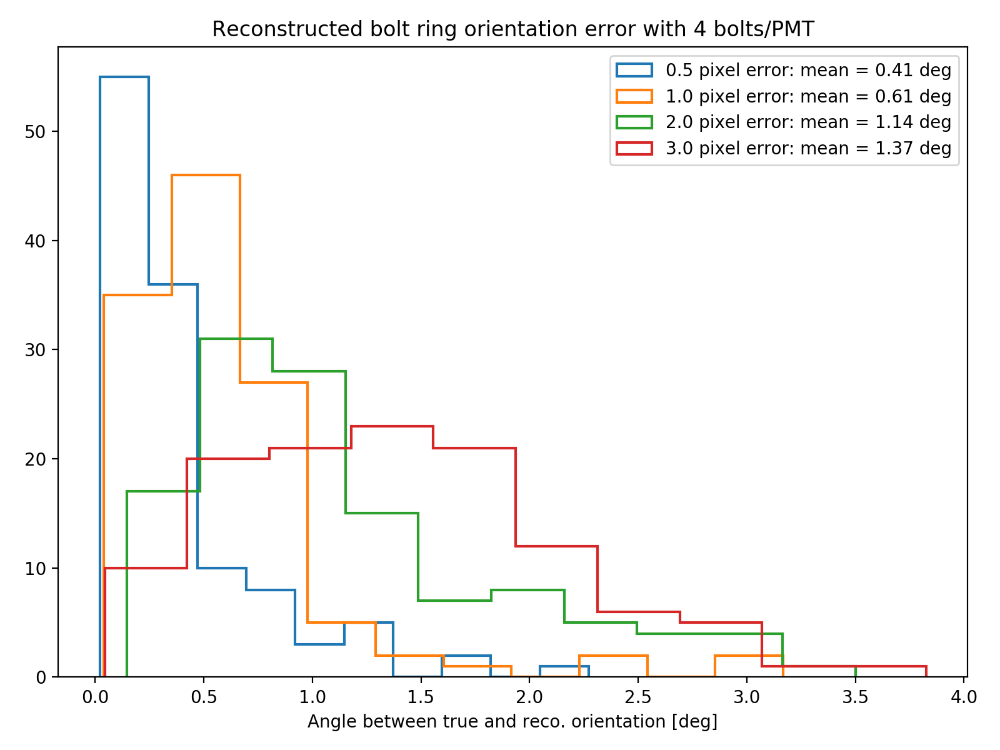

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 150, 6: 120, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 5.630518745681742    max: 16.219907479828116
image 1 reprojection errors:    average: 6.406081297214167    max: 19.464731056897737
image 2 reprojection errors:    average: 8.576615029105694    max: 20.574171518641876
image 3 reprojection errors:    average: 8.203365541005555    max: 18.72625810114671
image 4 reprojection errors:    average: 6.497778098403102    max: 16.83248179363941
image 5 reprojection errors:    average: 6.557402004945983    max: 18.958951526612516
image 6 reprojection errors:    average: 6.140855306010884    max: 16.008913112100547
image 7 reprojection errors:    average: 6.344209119617347    max: 18.892972947489497
image 8 reprojection errors:    average: 6.11235106250257    max: 18.764774046195157
image 9 reprojection errors:    average: 6.226161749819337    max: 18.066384284547485


<IPython.core.display.Javascript object>


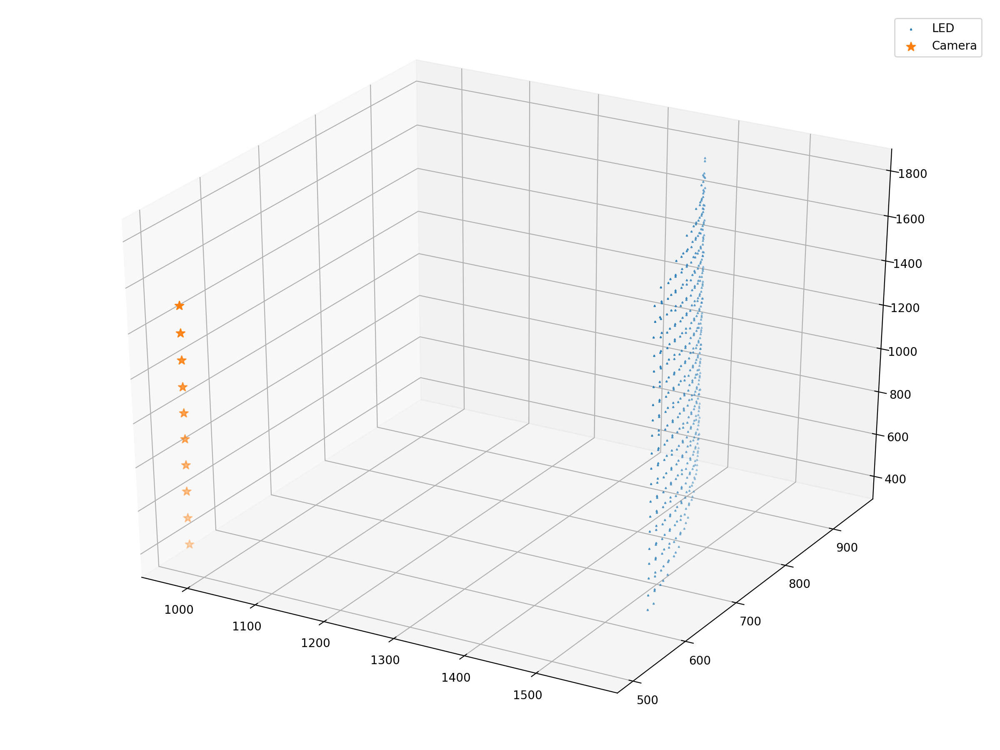

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 150, 6: 120, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 6.053729301869925    max: 14.081094629320521
image 1 reprojection errors:    average: 6.360236665369962    max: 13.922946664229745
image 2 reprojection errors:    average: 7.16873705125124    max: 18.71663667371101
image 3 reprojection errors:    average: 6.255181923913094    max: 17.040849572076986
image 4 reprojection errors:    average: 6.315151532041027    max: 18.27625259354752
image 5 reprojection errors:    average: 6.465194691569248    max: 18.689231760071856
image 6 reprojection errors:    average: 6.4885603994713446    max: 18.747142688755638
image 7 reprojection errors:    average: 6.339884182240384    max: 16.5939680924241
image 8 reprojection errors:    average: 6.180442961334904    max: 16.731041092081
image 9 reprojection errors:    average: 6.253769226150739    max: 14.467986987902268
   I

<IPython.core.display.Javascript object>


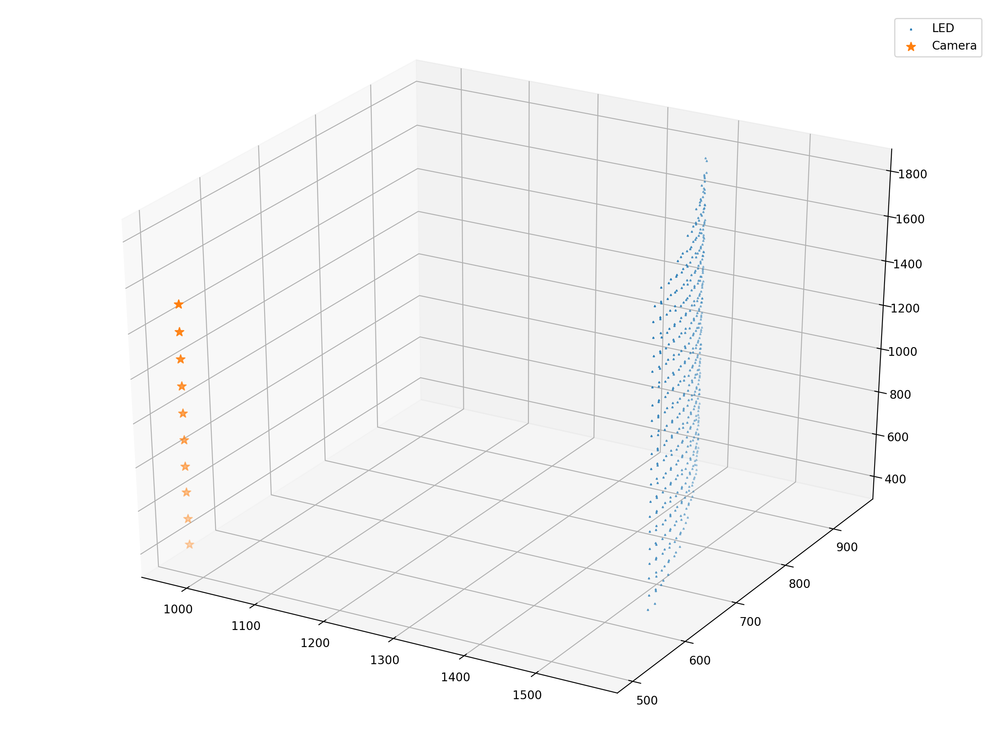

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 152, 6: 118, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 6.189102264302322    max: 13.832865290723413
image 1 reprojection errors:    average: 6.16210417334385    max: 17.18563599869751
image 2 reprojection errors:    average: 6.043131527809199    max: 20.853183282353154
image 3 reprojection errors:    average: 6.165241260867203    max: 14.95955092032031
image 4 reprojection errors:    average: 6.234440992795353    max: 21.043811769513045
image 5 reprojection errors:    average: 6.343568197647175    max: 15.273973266215508
image 6 reprojection errors:    average: 6.412157617259602    max: 15.38171471630001
image 7 reprojection errors:    average: 6.246638644616041    max: 16.942926391955755
image 8 reprojection errors:    average: 6.960190831451725    max: 18.588340834301132
image 9 reprojection errors:    average: 5.8848969972338905    max: 15.55586181340055
 

<IPython.core.display.Javascript object>


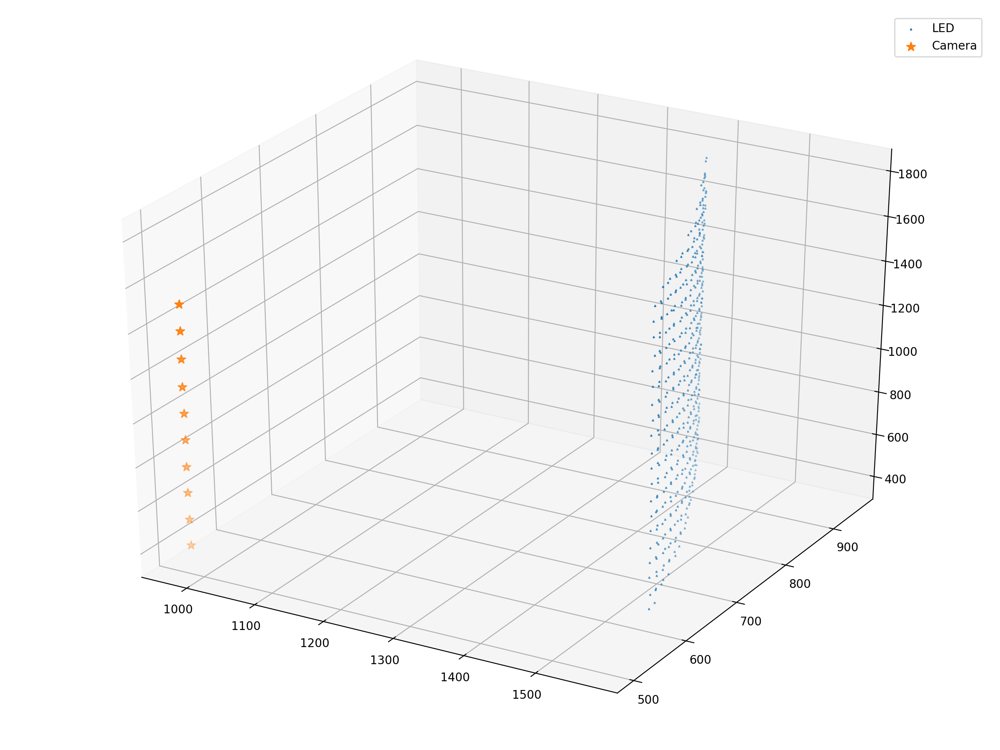

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 153, 6: 117, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 6.287761248112688    max: 14.13627998555501
image 1 reprojection errors:    average: 6.657742370124942    max: 18.06443479548065
image 2 reprojection errors:    average: 6.367485737186432    max: 16.418404866660495
image 3 reprojection errors:    average: 7.89255806268932    max: 20.882711616245782
image 4 reprojection errors:    average: 6.634780697577005    max: 17.46845655794117
image 5 reprojection errors:    average: 6.457176855167443    max: 15.418060550527121
image 6 reprojection errors:    average: 6.713436315474322    max: 16.842890221212787
image 7 reprojection errors:    average: 6.530844813526159    max: 17.225094095148673
image 8 reprojection errors:    average: 7.075997943731002    max: 16.480277703238176
image 9 reprojection errors:    average: 6.531082703863239    max: 17.164384110294677
 

<IPython.core.display.Javascript object>


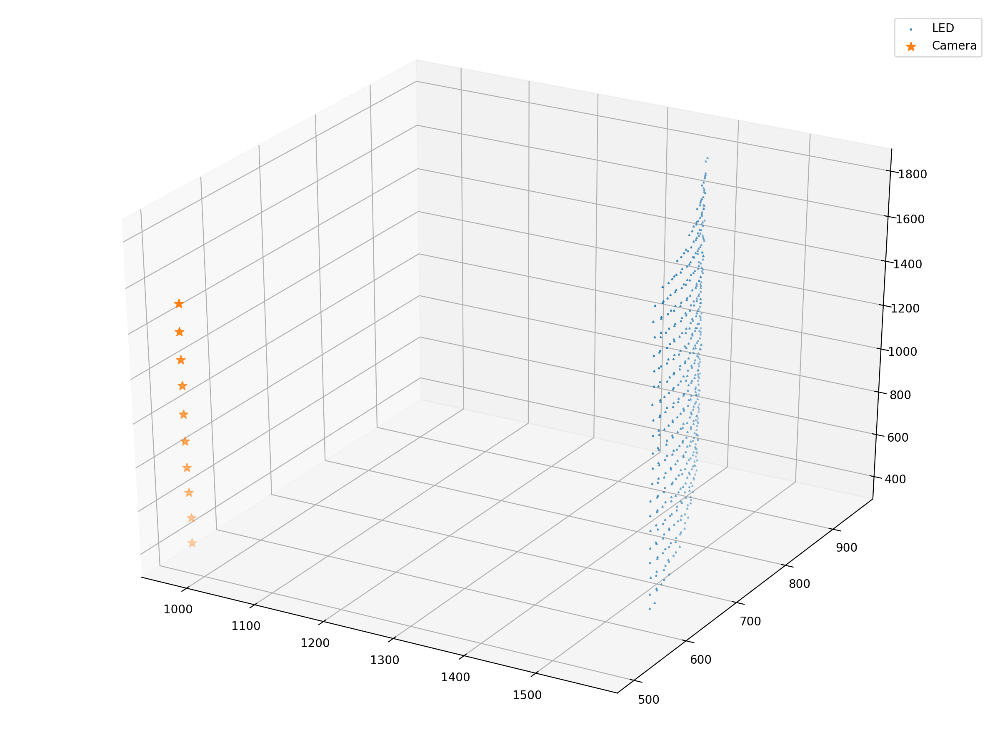

In [28]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=20, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 3 bolts

Feature in image counts: Counter({5: 110, 6: 94, 4: 60, 3: 54, 2: 24, 1: 18})


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


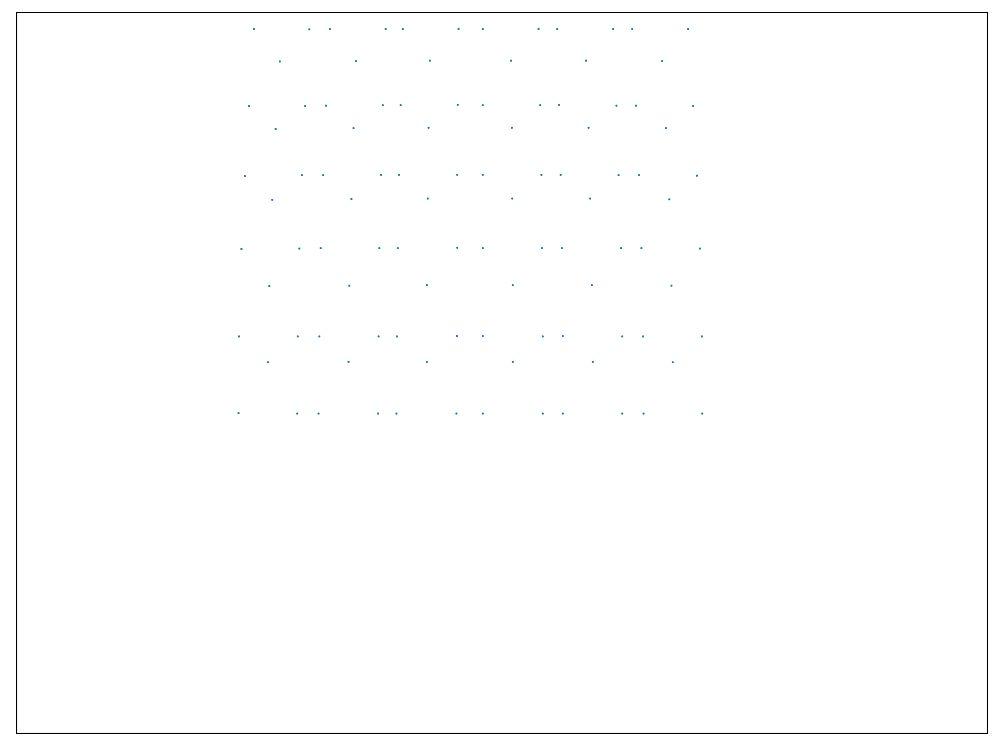

<IPython.core.display.Javascript object>


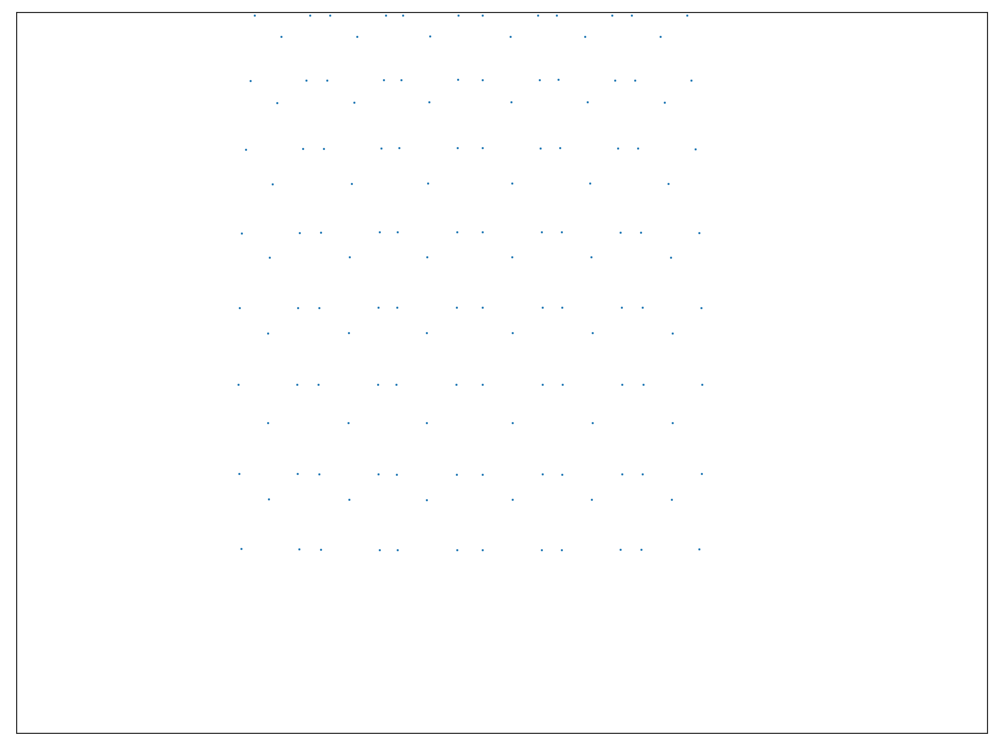

<IPython.core.display.Javascript object>


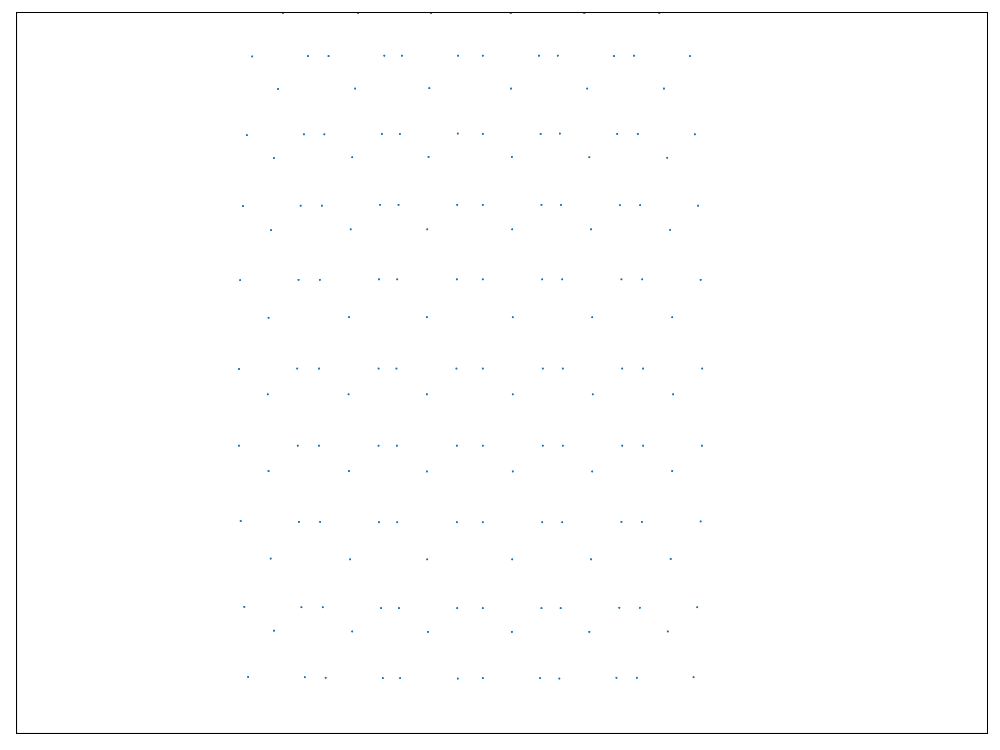

<IPython.core.display.Javascript object>


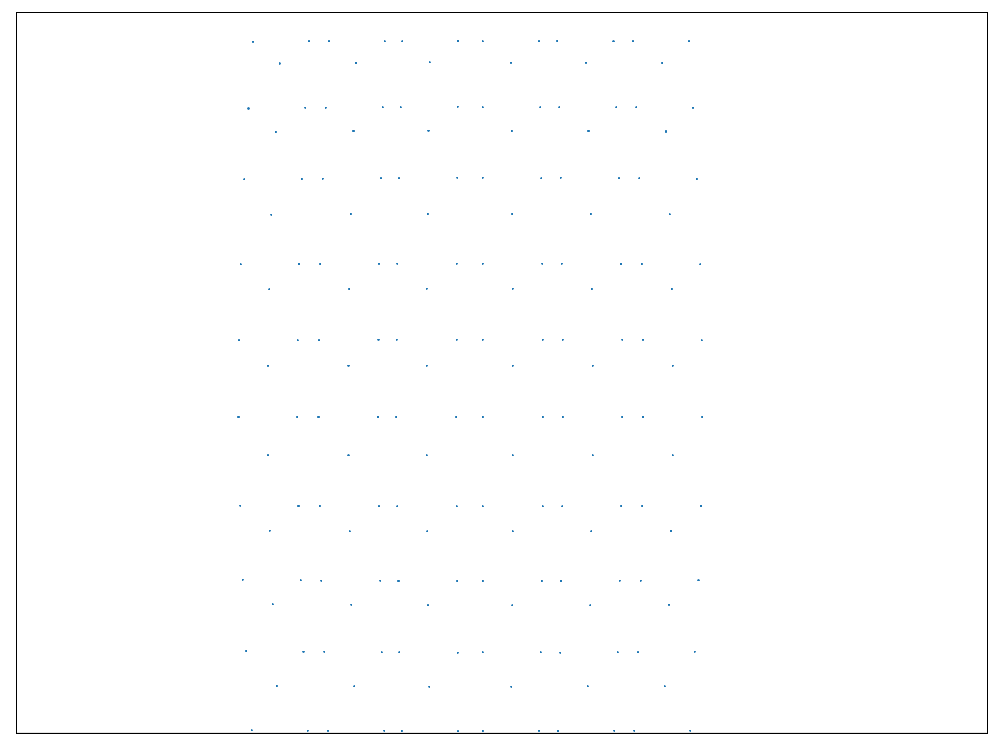

<IPython.core.display.Javascript object>


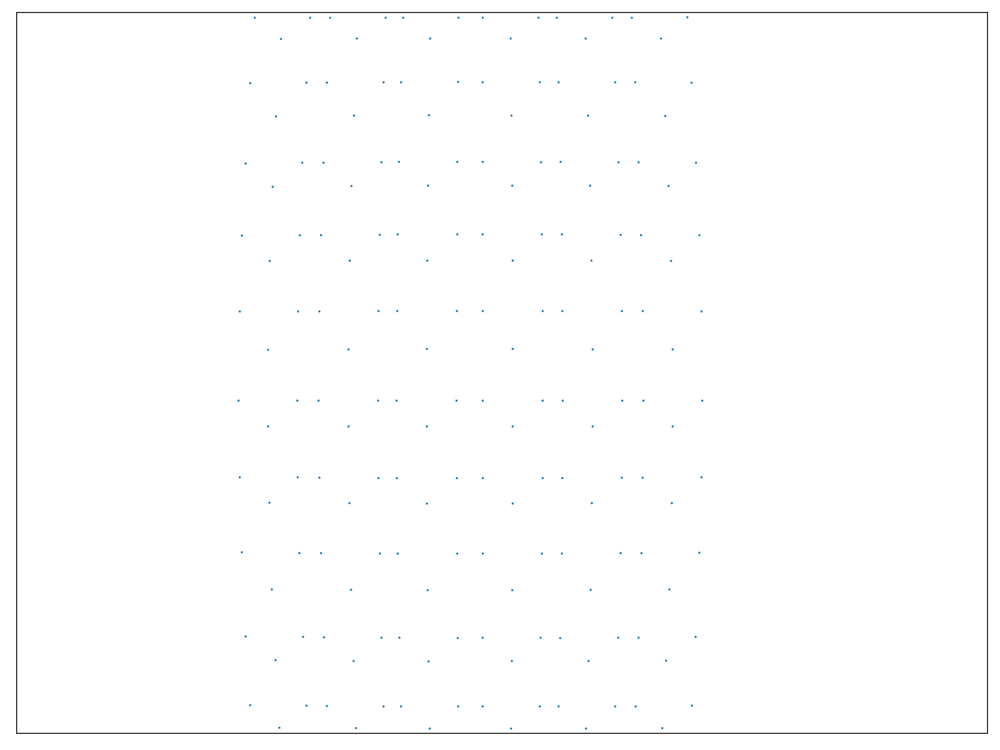

<IPython.core.display.Javascript object>


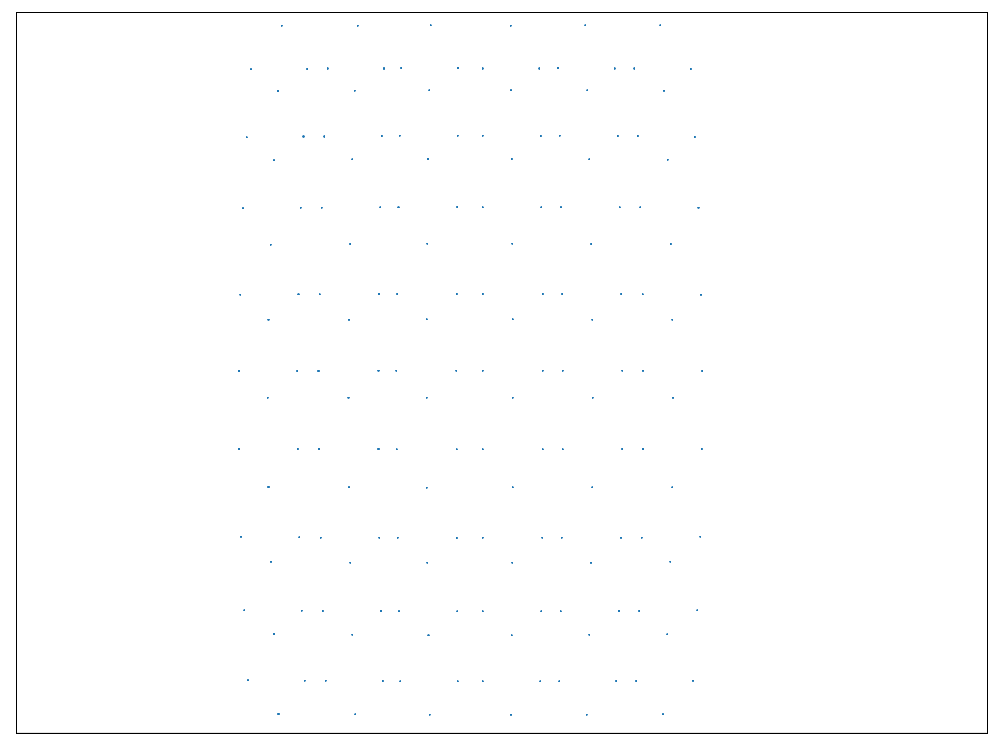

<IPython.core.display.Javascript object>


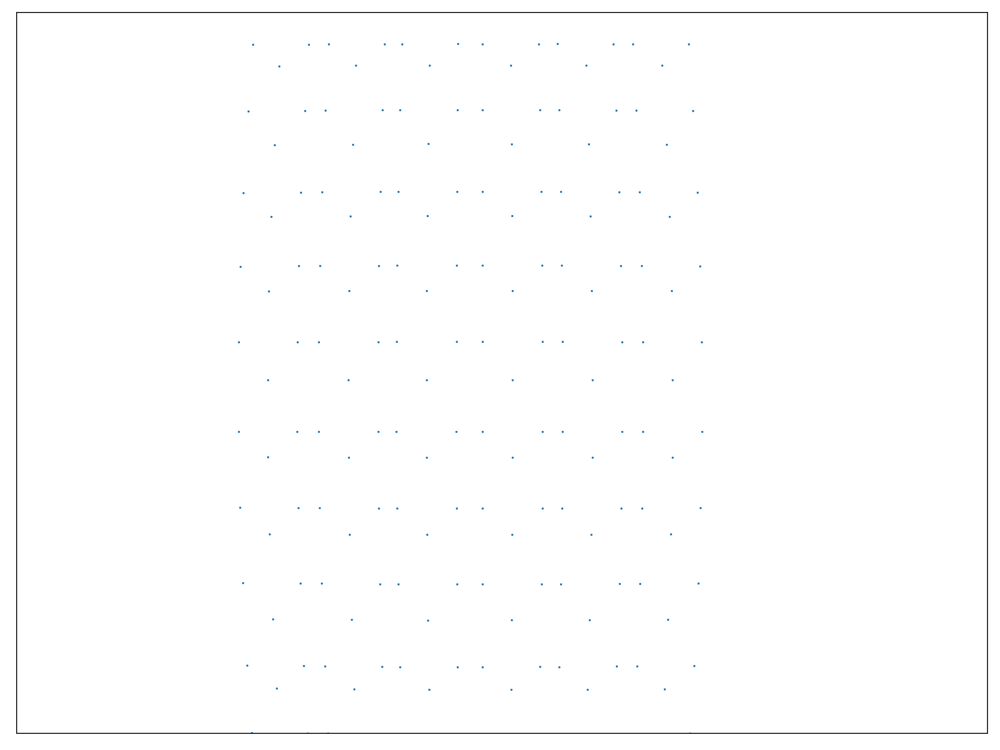

<IPython.core.display.Javascript object>


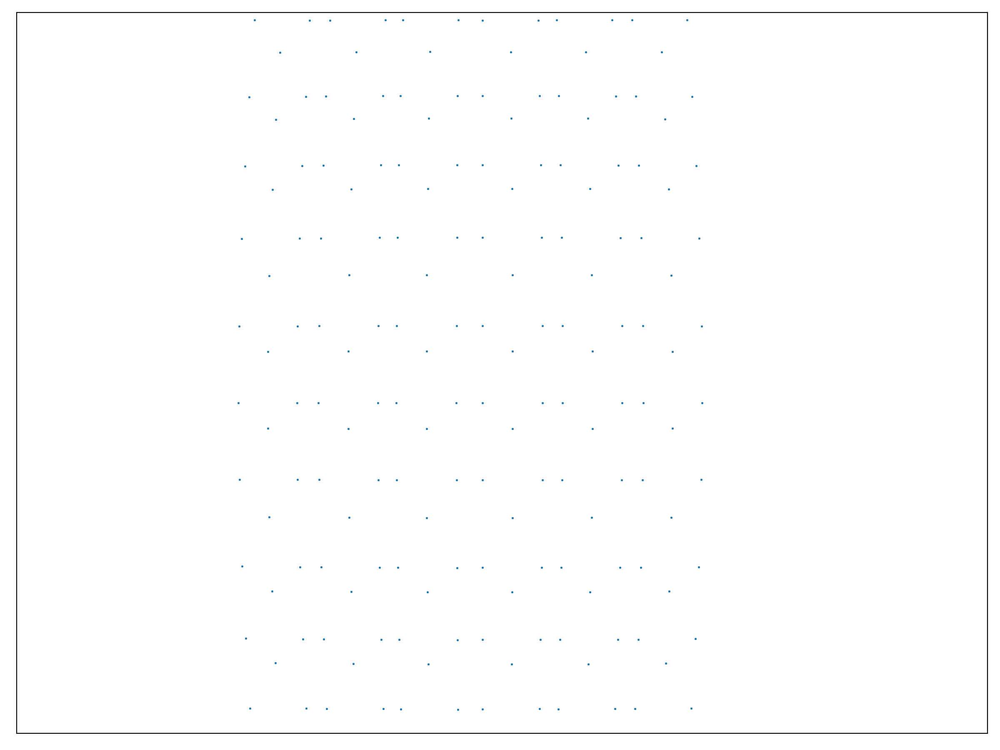

<IPython.core.display.Javascript object>


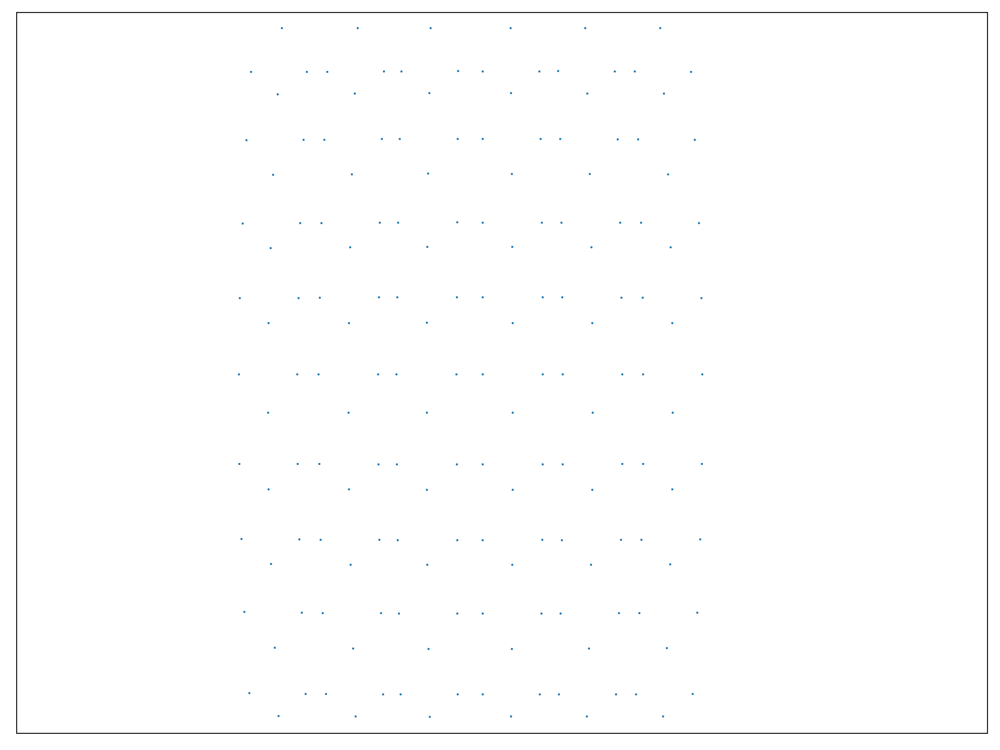

<IPython.core.display.Javascript object>


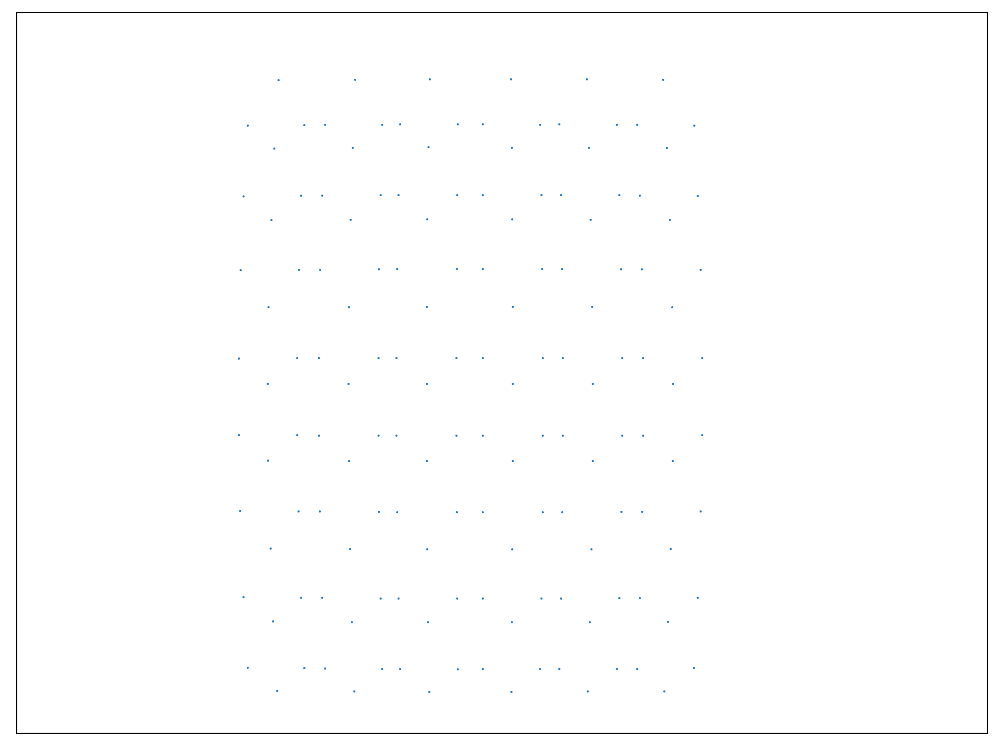

In [29]:
bolt_count = 3
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


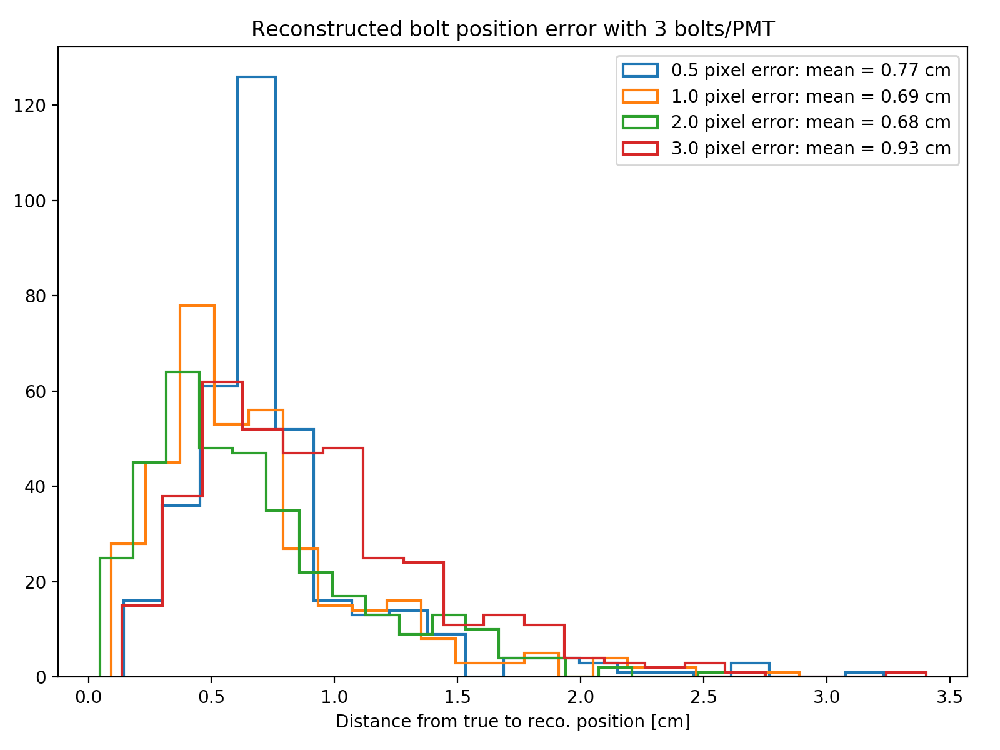

<IPython.core.display.Javascript object>


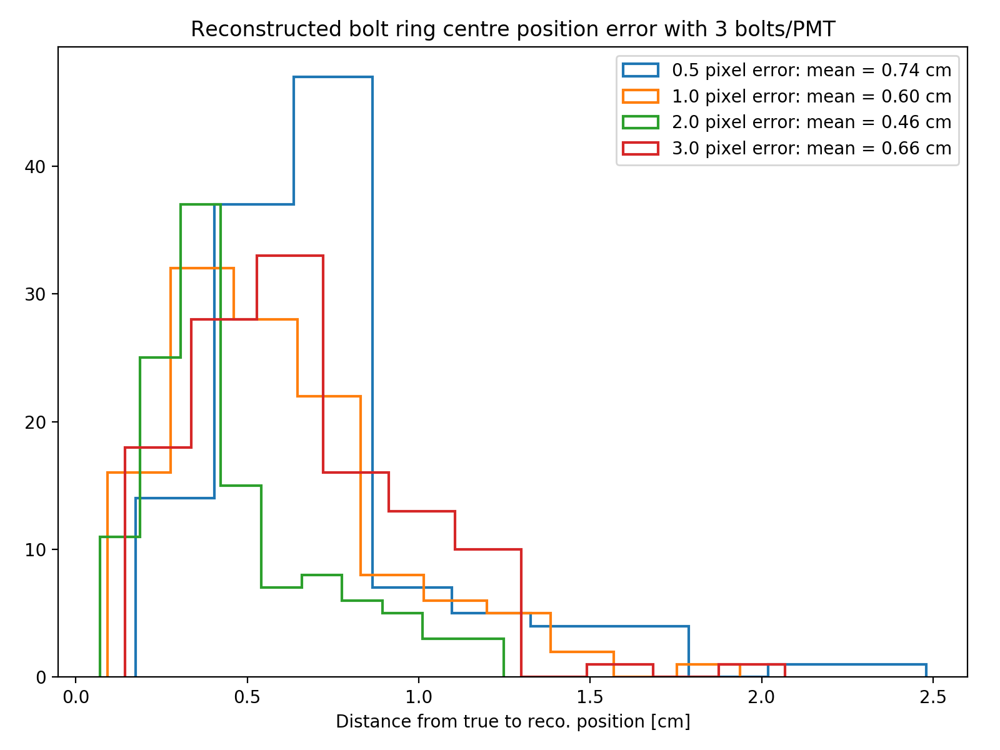

<IPython.core.display.Javascript object>


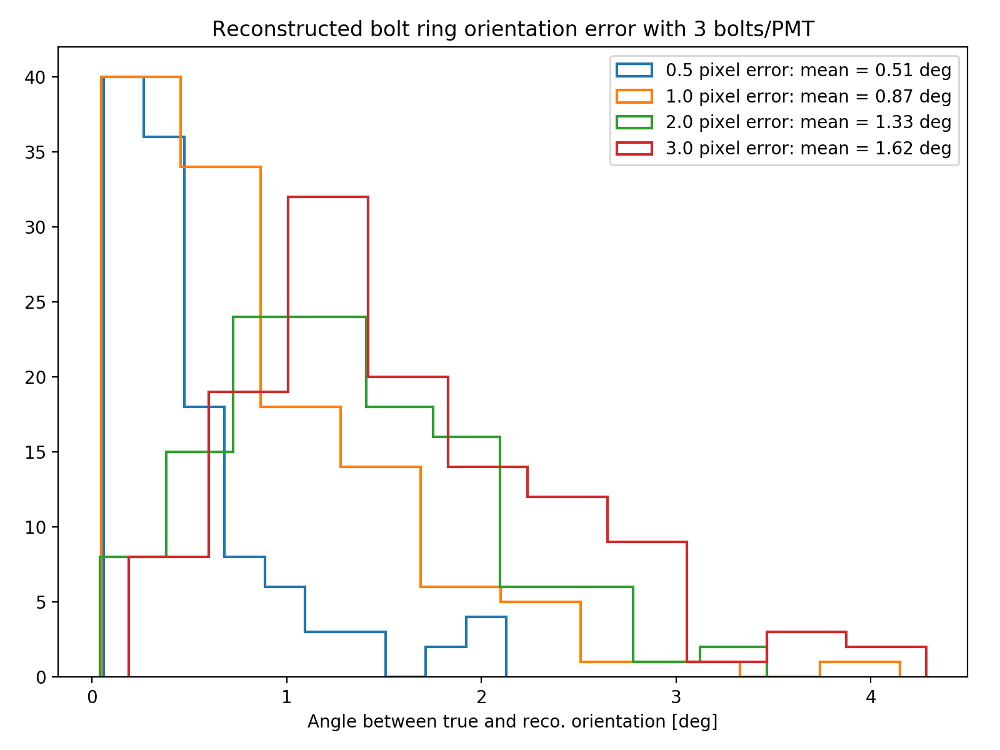

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 110, 6: 94, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 5.881916153513146    max: 15.371854156924297
image 1 reprojection errors:    average: 5.814553644440518    max: 13.863522519697108
image 2 reprojection errors:    average: 5.857736787427541    max: 15.862607614725448
image 3 reprojection errors:    average: 5.839164504119255    max: 17.3387954420856
image 4 reprojection errors:    average: 6.778033414123417    max: 20.595033563348714
image 5 reprojection errors:    average: 8.050357002785589    max: 18.98013326222668
image 6 reprojection errors:    average: 7.277820025905968    max: 18.600319331635404
image 7 reprojection errors:    average: 7.478366203174728    max: 17.94779708591679
image 8 reprojection errors:    average: 6.305587401746542    max: 16.76069308054482
image 9 reprojection errors:    average: 6.240034514922727    max: 16.30877586629974
   I

      80             81         2.9407e+02      3.46e-01       4.27e-02       4.87e+01    
      81             82         2.9372e+02      3.45e-01       4.42e-02       2.43e+01    
      82             83         2.9338e+02      3.44e-01       4.25e-02       4.74e+01    
      83             84         2.9304e+02      3.42e-01       4.41e-02       2.25e+01    
      84             85         2.9270e+02      3.41e-01       4.24e-02       4.62e+01    
      85             86         2.9236e+02      3.40e-01       4.39e-02       2.07e+01    
      86             87         2.9202e+02      3.39e-01       4.22e-02       4.51e+01    
      87             88         2.9168e+02      3.37e-01       4.37e-02       1.92e+01    
      88             89         2.9135e+02      3.36e-01       4.20e-02       4.39e+01    
      89             90         2.9101e+02      3.35e-01       4.36e-02       1.83e+01    
      90             91         2.9068e+02      3.34e-01       4.19e-02       4.28e+01    

<IPython.core.display.Javascript object>


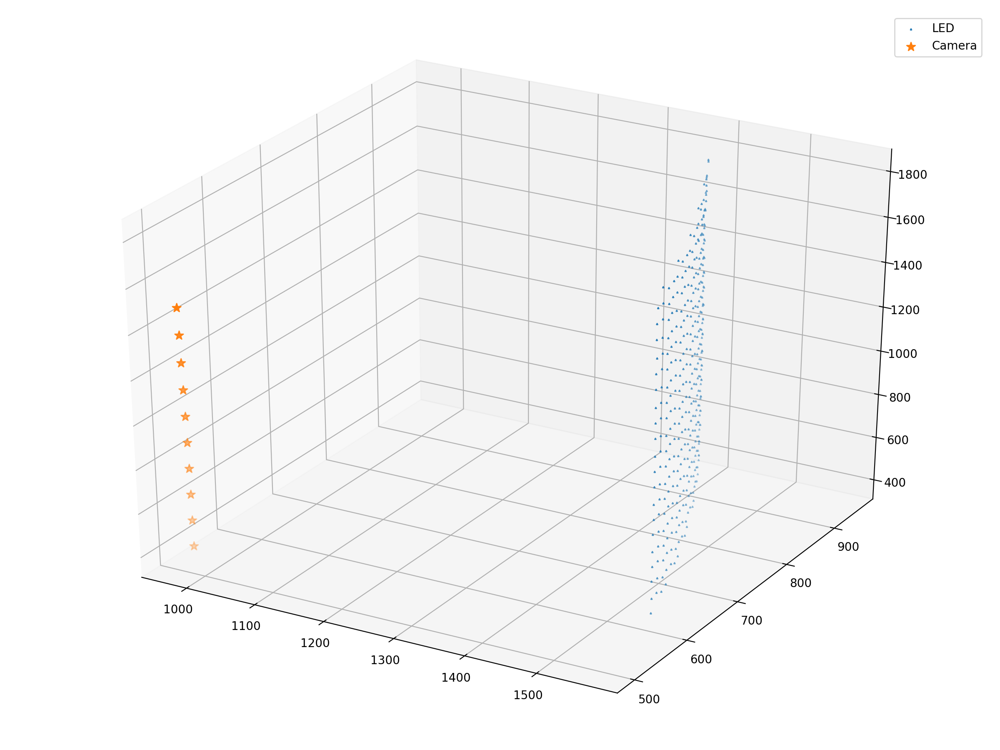

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 111, 6: 93, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 5.817584583737203    max: 12.899714804760965
image 1 reprojection errors:    average: 6.148659715248857    max: 17.96982767302356
image 2 reprojection errors:    average: 7.620049334976003    max: 17.54877095204311
image 3 reprojection errors:    average: 7.108457598933965    max: 18.344370971346365
image 4 reprojection errors:    average: 6.0052442878824115    max: 17.377804425311886
image 5 reprojection errors:    average: 6.144897988193531    max: 15.097927018484796
image 6 reprojection errors:    average: 5.733397047855039    max: 16.752940118655385
image 7 reprojection errors:    average: 6.2771703902513085    max: 17.33181110416683
image 8 reprojection errors:    average: 6.264372741883557    max: 16.150058991909276
image 9 reprojection errors:    average: 6.709538017602279    max: 19.384520434625916

<IPython.core.display.Javascript object>


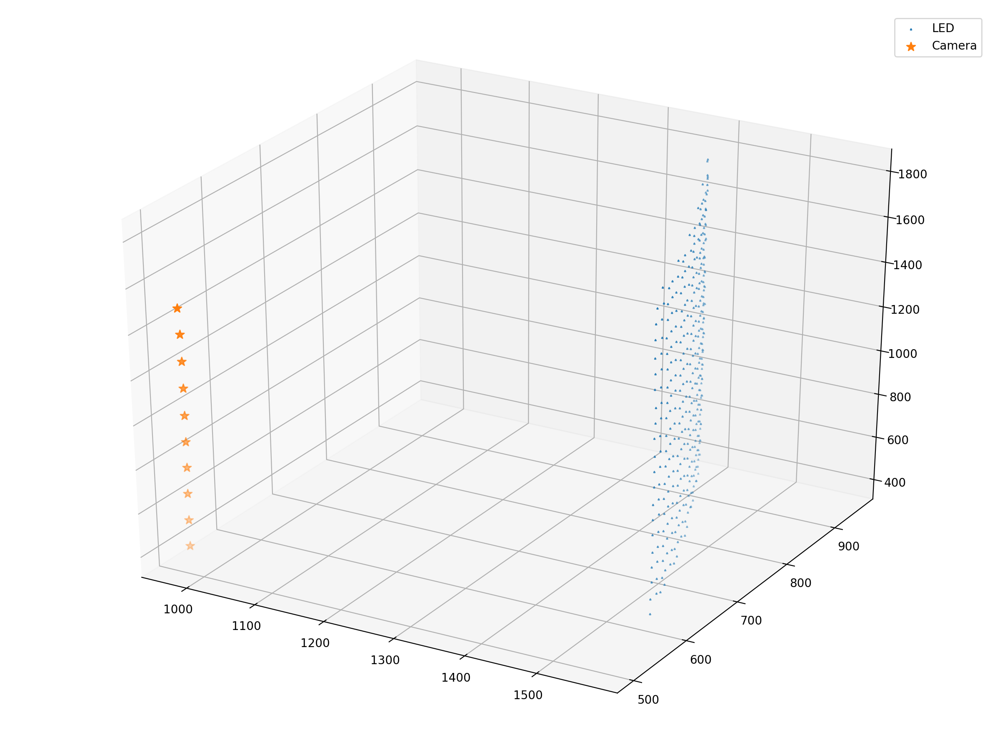

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 112, 6: 92, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 5.94388383718854    max: 13.467869154167063
image 1 reprojection errors:    average: 6.714586125295659    max: 20.707716525820626
image 2 reprojection errors:    average: 7.451001978768593    max: 18.586290960895898
image 3 reprojection errors:    average: 6.244010785070093    max: 16.65081627473529
image 4 reprojection errors:    average: 6.465872675717862    max: 15.943774074387413
image 5 reprojection errors:    average: 6.225645297478479    max: 16.91751262635366
image 6 reprojection errors:    average: 6.203281507624636    max: 16.55117457328539
image 7 reprojection errors:    average: 6.244585479235281    max: 16.124470832905562
image 8 reprojection errors:    average: 6.187873052015824    max: 16.85407259251966
image 9 reprojection errors:    average: 6.130784098042761    max: 17.351291624662124
   

<IPython.core.display.Javascript object>


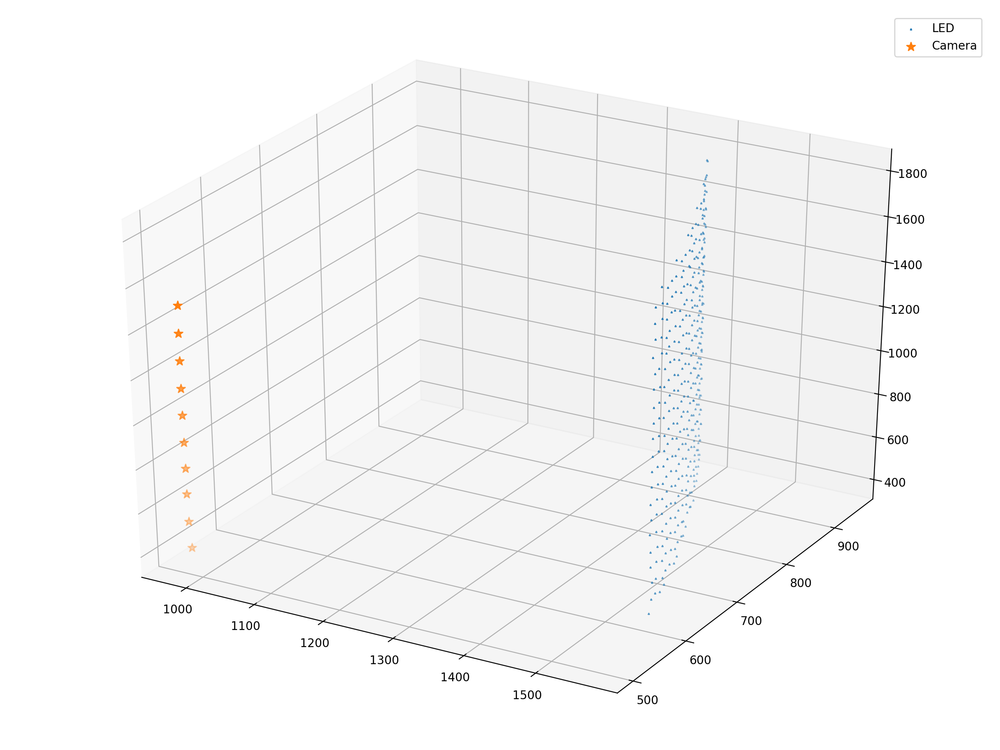

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 113, 6: 91, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 6.747150316331988    max: 19.492006155790857
image 1 reprojection errors:    average: 6.45894669763059    max: 15.982843854385049
image 2 reprojection errors:    average: 8.695683365862582    max: 21.499896889348854
image 3 reprojection errors:    average: 7.839067549285301    max: 26.109295017046996
image 4 reprojection errors:    average: 7.447130079197462    max: 20.874994769827282
image 5 reprojection errors:    average: 6.622373136177584    max: 20.537487140725485
image 6 reprojection errors:    average: 7.077815958731163    max: 17.619347332058297
image 7 reprojection errors:    average: 6.88139560423221    max: 17.404983119438306
image 8 reprojection errors:    average: 6.684567513537112    max: 15.954522336139506
image 9 reprojection errors:    average: 6.946153867171924    max: 17.60305828097148
 

<IPython.core.display.Javascript object>


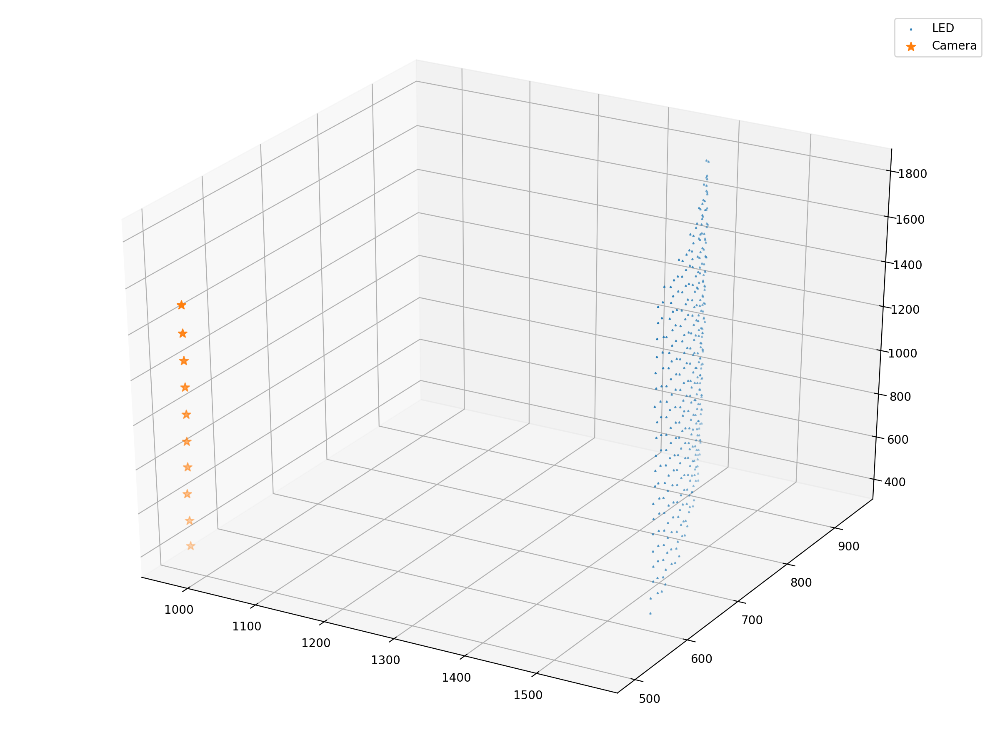

In [30]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=20, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

In [34]:
ring_positions

{'00491-00': array([1557.05334389,  616.47815398,  424.        ]),
 '00492-00': array([1557.05334389,  616.47815398,  491.        ]),
 '00493-00': array([1557.05334389,  616.47815398,  569.        ]),
 '00494-00': array([1557.05334389,  616.47815398,  636.        ]),
 '00495-00': array([1557.05334389,  616.47815398,  703.        ]),
 '00496-00': array([1557.05334389,  616.47815398,  781.        ]),
 '00497-00': array([1557.05334389,  616.47815398,  848.        ]),
 '00498-00': array([1557.05334389,  616.47815398,  915.        ]),
 '00499-00': array([1557.05334389,  616.47815398,  993.        ]),
 '00500-00': array([1557.05334389,  616.47815398, 1061.        ]),
 '00501-00': array([1557.05334389,  616.47815398, 1128.        ]),
 '00502-00': array([1557.05334389,  616.47815398, 1206.        ]),
 '00503-00': array([1557.05334389,  616.47815398, 1273.        ]),
 '00504-00': array([1557.05334389,  616.47815398, 1340.        ]),
 '00505-00': array([1557.05334389,  616.47815398, 1418.       

In [35]:
reco_bolt_positions

{'00491-01': array([1554.99127606,  616.86642349,  453.91409254]),
 '00491-04': array([1564.56709855,  596.41771496,  445.22435782]),
 '00491-07': array([1566.94111461,  587.84228991,  422.65893226]),
 '00491-10': array([1565.29587092,  595.2736012 ,  402.34855579]),
 '00491-13': array([1557.15959667,  616.29960412,  393.72780254]),
 '00491-16': array([1548.70747833,  636.66064578,  402.74149919]),
 '00491-19': array([1547.50409559,  643.61264321,  423.15702496]),
 '00491-22': array([1549.93159559,  635.48877841,  444.67536845]),
 '00492-01': array([1557.53409778,  616.78043263,  521.20427469]),
 '00492-04': array([1564.89313885,  596.58346551,  511.75866045]),
 '00492-07': array([1568.6093751 ,  588.5883528 ,  491.05506022]),
 '00492-10': array([1565.52134793,  596.48525547,  469.92889409]),
 '00492-13': array([1556.21520791,  616.22723459,  461.98118514]),
 '00492-16': array([1548.88025339,  635.69124483,  469.30960902]),
 '00492-19': array([1546.90470947,  643.75849132,  490.6359741